In [1]:
import scanpy as sc
import pandas as pd
import scmags as sm
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import classification_report, roc_curve, auc

In [63]:
adata_08 = sc.read_h5ad(r'C:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\STNav\data\processed\PipelineRun_2024_06_02-09_46_17_PM\ST\Files\deconvoluted_adata.h5ad')
adata_16 = sc.read_h5ad(r'C:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\STNav\data/processed/PipelineRun_2024_06_03-11_53_39_AM/ST/Files/deconvoluted_adata.h5ad')

In [64]:
counts_08 = adata_08.obs["cell_type"].value_counts().reset_index()
counts_08.columns = ["cell_type", "count"]

In [65]:
total_counts_08 = counts_08["count"].sum()
counts_08["relative_frequency"] = counts_08["count"] / total_counts_08


In [66]:
counts_16 = adata_16.obs["cell_type"].value_counts().reset_index()
counts_16.columns = ["cell_type", "count"]

In [67]:
total_counts_16 = counts_16["count"].sum()
counts_16["relative_frequency"] = counts_16["count"] / total_counts_16

In [68]:
all_cell_types = pd.DataFrame({"cell_type":list(set(counts_08["cell_type"]).union(set(counts_16["cell_type"])))})

In [69]:
counts_08_df = all_cell_types.merge(counts_08, on="cell_type", how="left").fillna(0)
counts_16_df = all_cell_types.merge(counts_16, on="cell_type", how="left").fillna(0)

In [70]:
correlation = counts_08_df["relative_frequency"].corr(counts_16_df["relative_frequency"])

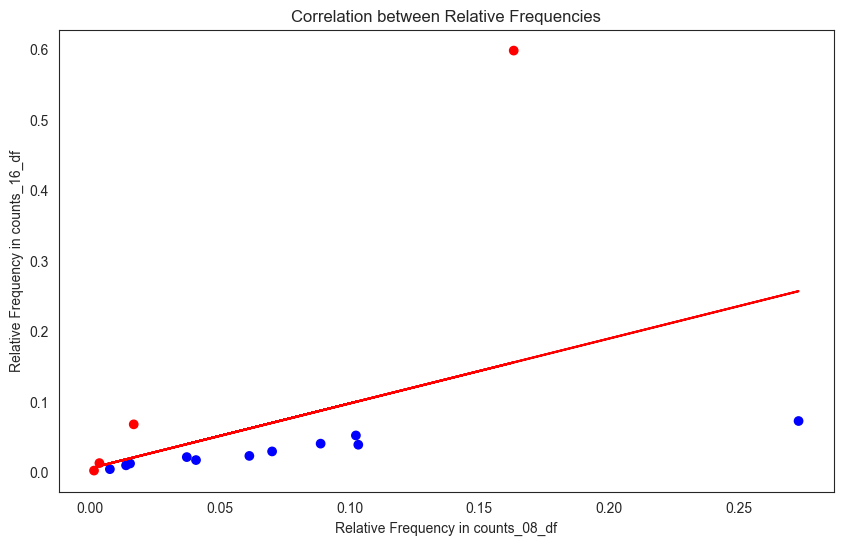

In [80]:
import matplotlib.pyplot as plt
import numpy as np

# Create a color array: 'red' if '16' frequency is higher, 'blue' otherwise
colors = np.where(counts_16_df["relative_frequency"] > counts_08_df["relative_frequency"], 'red', 'blue')

# Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(counts_08_df["relative_frequency"], counts_16_df["relative_frequency"], c=colors)
plt.xlabel('Relative Frequency in counts_08_df')
plt.ylabel('Relative Frequency in counts_16_df')
plt.title('Correlation between Relative Frequencies')

# Add a line of best fit
m, b = np.polyfit(counts_08_df["relative_frequency"], counts_16_df["relative_frequency"], 1)
plt.plot(counts_08_df["relative_frequency"], m*counts_08_df["relative_frequency"] + b, color='red')

plt.show()

In [72]:
merged_df = pd.merge(counts_08_df, counts_16_df, on='cell_type', suffixes=('_08', '_16'))


In [73]:
merged_df

,cell_type,count_08,relative_frequency_08,count_16,relative_frequency_16
0,Unknown_Mean_LogNorm_Conn_Adj_scMAGS,15092,0.103414,22515,0.038778
1,Macrophages_Mean_LogNorm_Conn_Adj_scMAGS,5444,0.037304,12345,0.021262
2,B cell lineage_Mean_LogNorm_Conn_Adj_scMAGS,39859,0.273125,42037,0.072401
3,AT1_Mean_LogNorm_Conn_Adj_scMAGS,10243,0.070188,17015,0.029305
4,AT2_Mean_LogNorm_Conn_Adj_scMAGS,23835,0.163324,346880,0.597439
5,EC capillary_Mean_LogNorm_Conn_Adj_scMAGS,528,0.003618,7412,0.012766
6,EC venous_Mean_LogNorm_Conn_Adj_scMAGS,2252,0.015431,7072,0.012180
7,Mast cells_Mean_LogNorm_Conn_Adj_scMAGS,12973,0.088895,23420,0.040337
8,Lymphatic EC differentiating_Mean_LogNorm_Conn...,8963,0.061417,13319,0.022940
9,Lymphatic EC mature_Mean_LogNorm_Conn_Adj_scMAGS,1118,0.007661,2422,0.004171


In [74]:
# Reshape the DataFrame to long format
long_df = merged_df.melt(id_vars='cell_type', value_vars=['relative_frequency_08', 'relative_frequency_16'])

# Create a new column that combines 'cell_type' and 'variable'
long_df['combined'] = long_df['cell_type'] + '-' + long_df['variable']

# Pivot the DataFrame back to wide format
final_df = long_df.pivot_table(index=long_df.index, columns='combined', values='value', aggfunc='first')

# Reset the index
final_df.reset_index(drop=True, inplace=True)

In [75]:
final_df.fillna(0, inplace=True)

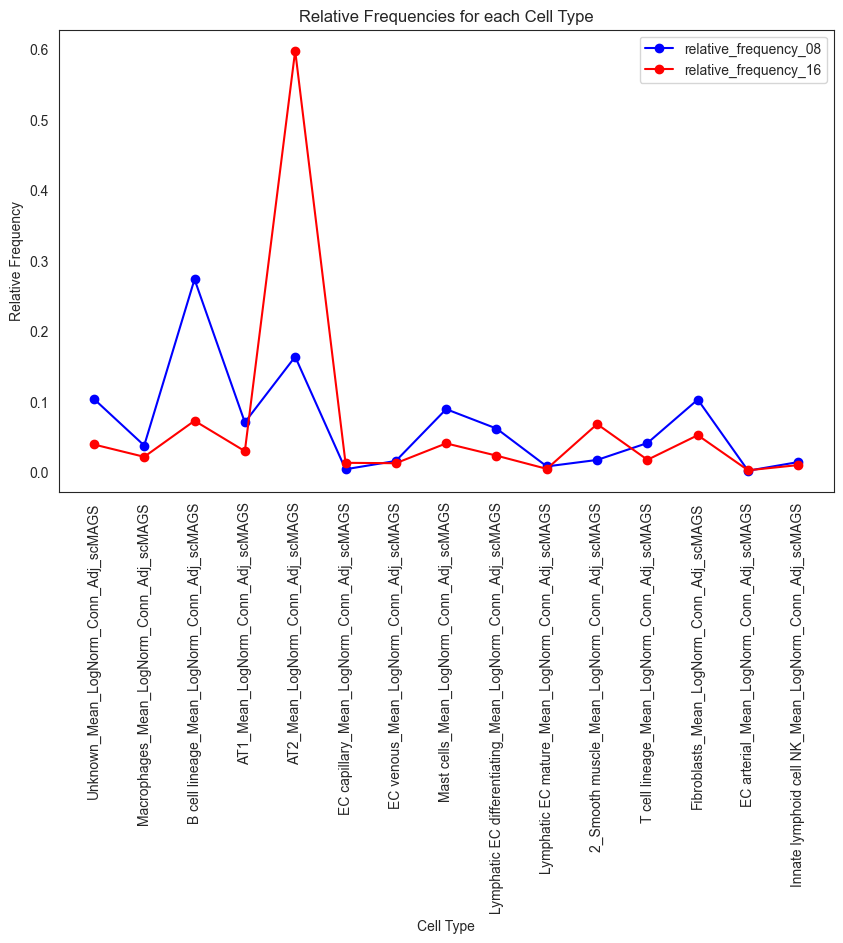

In [79]:
import matplotlib.pyplot as plt
merged_df = pd.merge(counts_08_df, counts_16_df, on='cell_type', suffixes=('_08', '_16'))

# Create a new figure and set its size
plt.figure(figsize=(10, 6))

# Create a scatter plot for relative_frequency_08 with a line
plt.plot(merged_df['cell_type'], merged_df['relative_frequency_08'], color='blue', label='relative_frequency_08', marker='o')

# Create a scatter plot for relative_frequency_16 with a line
plt.plot(merged_df['cell_type'], merged_df['relative_frequency_16'], color='red', label='relative_frequency_16', marker='o')

# Add labels and title
plt.xlabel('Cell Type')
plt.ylabel('Relative Frequency')
plt.title('Relative Frequencies for each Cell Type')
plt.legend()

# Rotate x-axis labels for better visibility
plt.xticks(rotation=90)

# Show the plot
plt.show()

# Defining the problem
Using the scRNA annotated reference, the goal is to use a Boosting approach that would rank the top markers based on their feature importance to construct a set of markers that would be best suitable to predict a given cell type. This will be an optimization problem where a set of markers will be found and iteratively added/removed to achieve the best accuracy or selected classification parameter;

# Load data

In [2]:
sc_adata = sc.read_h5ad(r"C:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\STNav\data\processed\PipelineRun_2024_05_28-05_05_04_PM\scRNA\Files\preprocessed_adata.h5ad")
sc_adata.obs = sc_adata.obs[["dataset","ann_level_3_transferred_label"]]
sc_adata.obs.rename(columns={"ann_level_3_transferred_label":"y_true"},inplace=True)
# drop the rows that have y_ture as "Unknown"
sc_adata = sc_adata[sc_adata.obs.y_true != "Unknown"]

In [3]:
sc_adata.obs["y_true"].value_counts()

y_true
Fibroblasts                     1031
EC capillary                     208
EC venous                        145
AT1                               60
T cell lineage                    59
Lymphatic EC differentiating      21
Lymphatic EC mature               14
Macrophages                       14
B cell lineage                     9
Mast cells                         6
2_Smooth muscle                    5
EC arterial                        5
AT2                                4
Innate lymphoid cell NK            4
Name: count, dtype: int64

In [4]:
def convert_form_anndata(adata, cell_annotation_col):

    adata.var_names_make_unique()
    exp_data = pd.DataFrame(
        data=adata.X.todense(), columns=adata.var_names, index=adata.obs.index
    ).to_numpy()
    labels = adata.obs[cell_annotation_col].to_numpy()
    gene_names = adata.var_names.to_numpy()

    return exp_data, labels, gene_names

In [5]:
sc_adata.X = sc_adata.layers["raw_counts"]

In [6]:
exp_data, labels, gene_names = convert_form_anndata(
	sc_adata, "y_true"
)

In [7]:
mags = sm.ScMags(data=exp_data, labels=labels, gene_ann=gene_names)
mags.filter_genes(nof_sel=1000)



-> Eliminating low expression genes
-> Selecting cluster-specific candidate marker genes


In [85]:
mags.sel_clust_marker(nof_markers=5)


-> Selecting  markers for each cluster


In [86]:
mags.get_filt_cluster_thresholds

{'2_Smooth muscle': 0.6330674552014318,
 'AT1': 0.5124831789828027,
 'AT2': 0.5652387968805027,
 'B cell lineage': 0.5526779354762885,
 'EC arterial': 0.6330674552014318,
 'EC capillary': 0.5108889141200323,
 'EC venous': 0.5239178897774921,
 'Fibroblasts': 0.5219275888824428,
 'Innate lymphoid cell NK': 0.5652387968805027,
 'Lymphatic EC differentiating': 0.58138848256695,
 'Lymphatic EC mature': 0.58138848256695,
 'Macrophages': 0.5490891179322273,
 'Mast cells': 0.6029213878313173,
 'T cell lineage': 0.49051231278283236}

In [87]:
mrks_df = mags.get_markers()


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

In [88]:
mrks_df

,Marker_1,Marker_2,Marker_3,Marker_4,Marker_5
C_2_Smooth muscle,Myh11,Tagln,Ad-1,Acta2,Igfbp6
C_AT1,Ldn18,Yp4b1,Sftpd,Sftpb,Eacam6
C_AT2,Napsa,Msln,Sftpd,Slc34a2,Susd2
C_B cell lineage,Mzb1,Iglc3,Jchain,Ighm,Sec11c
C_EC arterial,Smad6,Yyr1,Adcy4,Mllt1,Notch4
C_EC capillary,Btnl9,Vipr1,Amp2,Adgrf5,Fcn3
C_EC venous,Ackr1,L23,Selp,Pe-1,Ptprb
C_Fibroblasts,Dcn,Ol6a2,Lum,Mmp2,Ol6a1
C_Innate lymphoid cell NK,Nly,L3,Nkg7,L4,Klrd1
C_Lymphatic EC differentiating,Stab2,Prox1,Angpt2,Eln-1,Tbx1


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_plot.py:808: UserWarning: No data for colormapping provided via 'c'. Parameters 'norm' will be ignored
  main_ax.scatter(


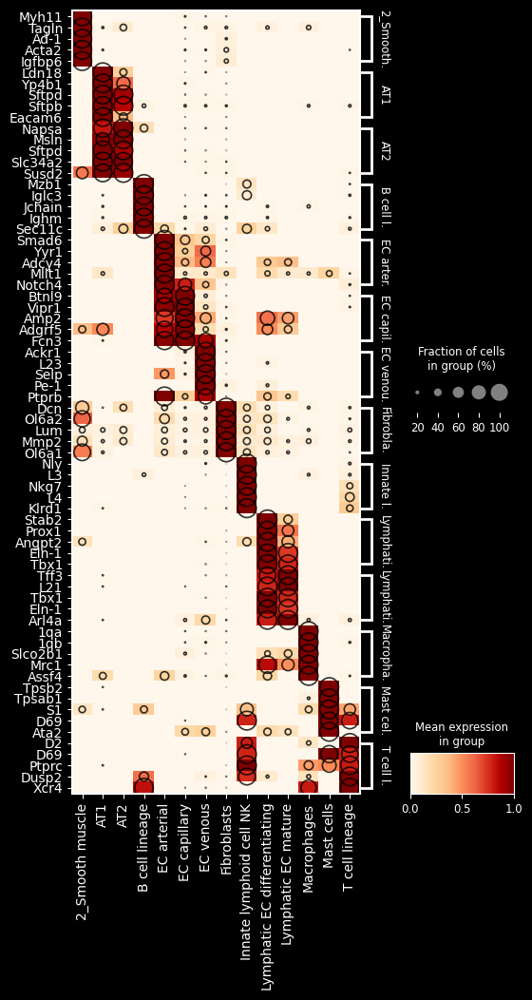

In [89]:
mags.dot_plot(figsize = (6,12), largest_dot = 200, save_plot=True,plot_name="scmags_dotplot.png")

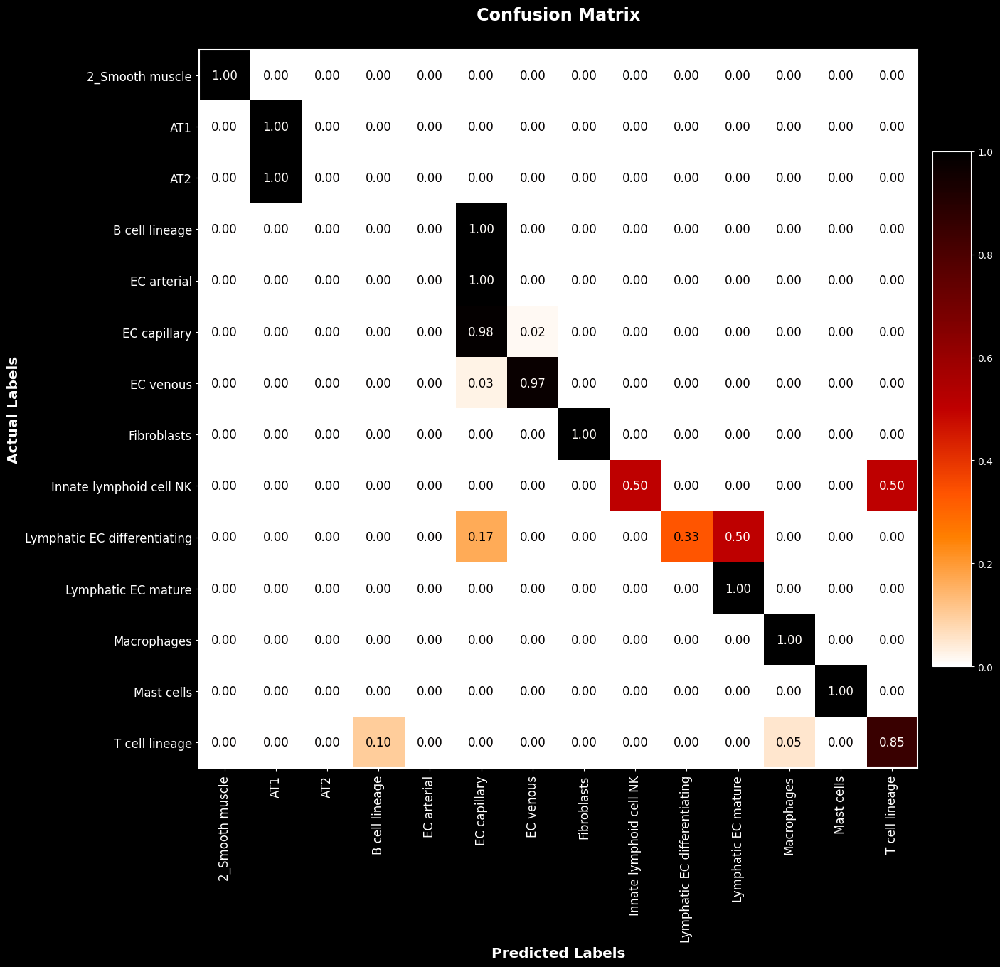

In [90]:
mags.knn_classifier(save_plot=True)

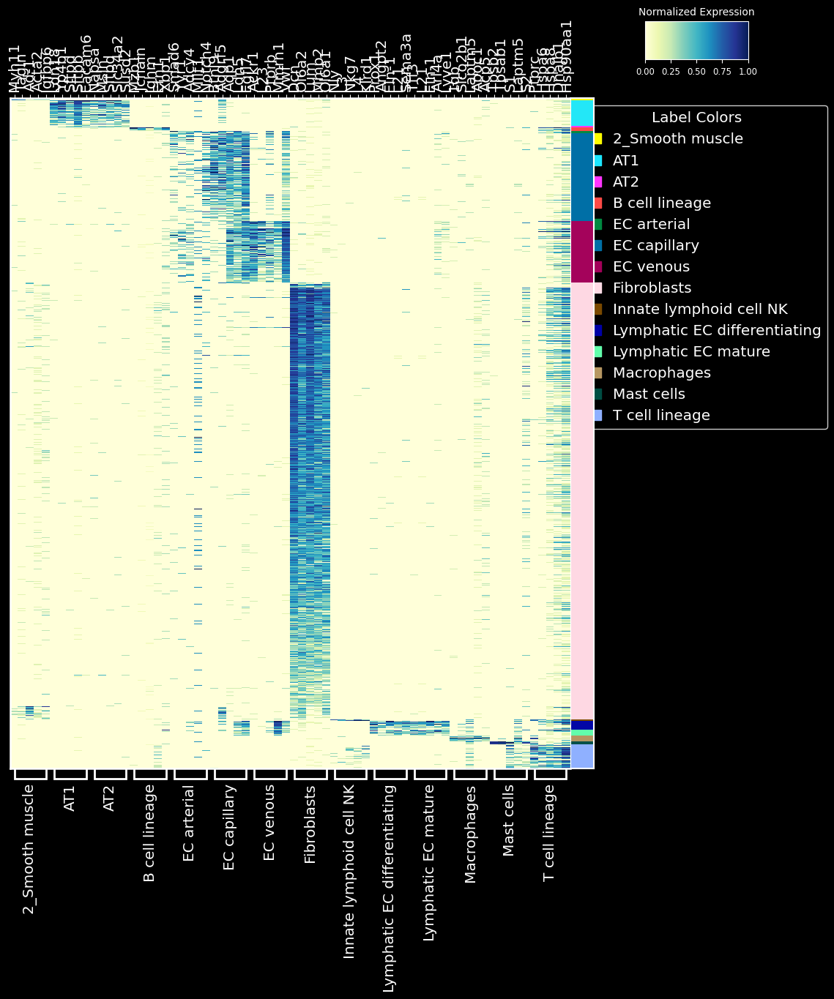

In [65]:
mags.markers_heatmap(figsize = (13,15), save_plot=True)

In [8]:
sc_adata.X = sc_adata.layers["lognorm"]

# Modelling

In [9]:
df = pd.DataFrame.sparse.from_spmatrix(
	sc_adata.X,
	index=sc_adata.obs.index,
	columns=sc_adata.var_names.str.upper(),
)

In [10]:
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate
from sklearn.metrics import classification_report
import numpy as np
import pandas as pd
import json
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

class iMarkerSelector:
    def __init__(self, sc_adata, df, mags, marker_range,test_size, metric, n_splits, opt_trials):
        self.sc_adata = sc_adata
        self.df = df
        self.mags = mags
        self.marker_range = marker_range
        self.best_results_dict = {}
        self.all_results_dict = {}
        self.test_size=test_size
        self.metric=metric
        self.n_splits = n_splits
        self.opt_trials = opt_trials

    def extract_markers(self, cell_type):
        best_score = 0
        best_markers = None
        self.all_results_dict[cell_type] = {}
        metric_scores = []
        num_markers_list = []

        for i in self.marker_range:
            print(f"Cell Type: {cell_type}, Number of Markers: {i}")

            # Extract top i markers for the cell type
            self.mags.sel_clust_marker(nof_markers=i)
            #Turn into a dataframe
            mrks_df = self.mags.get_markers()
            # Turn into a mappable dictionary
            cell_type_markers_dict = {
                index.replace("C_", ""): [val.upper() for val in row.tolist()]
                for index, row in mrks_df.iterrows()
            }

            if cell_type not in cell_type_markers_dict:
                continue
            
            # Get the gene names for the current cell type being run
            gene_names = cell_type_markers_dict[cell_type]
            # Get the common genes between the extracted markers and the gene expression data
            common_genes = list(set(self.df.columns) & set(gene_names))
            # Create a subset with the top i markers for a given cell type
            df_gene_subset = self.df[common_genes]

            # Split the data into train and test sets
            X = df_gene_subset
            y = self.sc_adata.obs["y_true"]

            # Encode the labels in binary format. The current cell type labeled with 1, all others labeled with 0
            y_binary, le = self.encode_labels(y, cell_type)

            X_train_eval, X_test, y_train_eval, y_test = train_test_split(X, y_binary, test_size=self.test_size, random_state=42)
            X_train, X_val, y_train, y_val = train_test_split(X_train_eval, y_train_eval, test_size=self.test_size, random_state=42)

            print(f"X_train shape: {X_train_eval.shape}, y_train shape: {y_train_eval.shape}")
            print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
            print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

            # optimize model with optuna
            best_params = self.optimize_hyperparameters(X_train, y_train, X_val, y_val)
            model = lgb.LGBMClassifier(**best_params)
            # Re-fit the model on the training data
            model.fit(X_train_eval, y_train_eval)
            
            # Get the predictions on the test set
            y_pred = model.predict(X_test)

            # Retrieve the classification report for the test set
            metrics_results = classification_report(y_pred=y_pred, y_true=y_test.tolist(), output_dict=True)

            if self.metric == "f1":
                metric_score = metrics_results["macro avg"]["f1-score"]
            else:
                metric_score = metrics_results["macro avg"][self.metric]
            
            # Save results to excel
            self.save_results(cell_type, i, metrics_results, gene_names)
            metric_scores.append(metric_score)
            num_markers_list.append(i)

            if metric_score > best_score:
                best_score = metric_score
                best_markers = gene_names

            # self.all_results_dict[cell_type+"_"+i] = {"score":metric_score, "markers":gene_names}


        self.best_results_dict[cell_type] = {
            "best_score": best_score,
            "best_markers": best_markers,
        }

        # Plot the results as a line plot with X as the number of markers and Y as the metric score
        self.plot_results(cell_type, num_markers_list, metric_scores)

    def encode_labels(self, y, cell_type):
        le = LabelEncoder()
        le.fit(y)
        y_encoded = le.transform(y)
        y_binary = (y_encoded == le.transform([cell_type])[0]).astype(int)
        return y_binary, le
    
    def optimize_hyperparameters(self, X_train, y_train,X_val,y_val):
        def objective(trial):
            params = {
                'objective': 'binary',
                'metric': 'binary_logloss',
                'boosting_type': 'gbdt',
                'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
                'num_leaves': trial.suggest_int('num_leaves', 20, 200),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
                'subsample': trial.suggest_float('subsample', 0.5, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
                'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
                'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 10.0),
                'verbosity': -1
            }

            model = lgb.LGBMClassifier(**params)
            model.fit(X_train, y_train)
            y_pred = model.predict(X_val)
            metrics_results = classification_report(y_pred=y_pred, y_true=y_val, output_dict=True, zero_division=0)
            if self.metric == "f1":
                metric_score = metrics_results["macro avg"]["f1-score"]
            else:
                metric_score = metrics_results["macro avg"][self.metric]
            return metric_score

        study = optuna.create_study(direction='maximize')
        study.optimize(objective, n_trials=self.opt_trials)
        return study.best_params

    def save_results(self, cell_type, num_markers, metrics_results, gene_names):
        models_metrics = {f"{cell_type}_{num_markers}": {"LGBM": metrics_results}}
        results = pd.json_normalize(models_metrics)
        results.columns = pd.MultiIndex.from_tuples([tuple(col.split(".")) for col in results.columns])
        results = results.T
        results.to_excel(f"./markers_preds/{cell_type}_{num_markers}_results.xlsx")

        if self.metric == "f1":
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"]["f1-score"],
                "markers": gene_names
            }
        else:
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"][self.metric],
                "markers": gene_names
            }

    def plot_results(self, cell_type, num_markers_list, metric_scores):
        plt.figure(figsize=(10, 6))
        plt.plot(num_markers_list, metric_scores, label=self.metric, marker='o')
        plt.xlabel('Number of Markers')
        plt.ylabel(self.metric)
        plt.title(f'{self.metric} for {cell_type} on the test set')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'{cell_type}_test_plot.png')
        plt.close()

    def save_best_results(self,dictio, filename='best_results.json'):
        with open(filename, 'w') as f:
            json.dump(dictio, f)


def main(sc_adata, df, mags, test_size, metric="f1", marker_range=range(3, 26),n_splits=7, opt_trials=100):
    evaluator = iMarkerSelector(sc_adata, df, mags, marker_range, test_size=test_size, metric=metric,n_splits=n_splits, opt_trials=opt_trials)
    for cell_type in sc_adata.obs["y_true"].unique():
        if cell_type != "Unknown":
            evaluator.extract_markers(cell_type)
    evaluator.save_best_results(dictio=evaluator.best_results_dict, filename='best_results.json')
    evaluator.save_best_results(dictio=evaluator.all_results_dict, filename='all_results.json')


In [11]:

main(sc_adata, df, mags, marker_range=range(3, 19), test_size=0.3, metric="f1",n_splits=5, opt_trials=400)

Cell Type: Lymphatic EC differentiating, Number of Markers: 3
-> Selecting  markers for each cluster


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 12:20:50,494] Trial 0 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.022484331339040917, 'num_leaves': 106, 'max_depth': 8, 'min_child_samples': 37, 'subsample': 0.8305908181536481, 'colsample_bytree': 0.6632487110477534, 'reg_alpha': 6.602103563268268, 'reg_lambda': 4.236157969598211}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:20:50,505] Trial 1 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.04776251624945697, 'num_leaves': 114, 'max_depth': 7, 'min_child_samples': 42, 'subsample': 0.8029681669399489, 'colsample_bytree': 0.6034784208847572, 'reg_alpha': 0.10467290104200333, 'reg_lambda': 7.864284891698004}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:20:50,520] Trial 2 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.08909510164759335, 'num_leaves': 96, 'max_depth': 3, 'min_child_samples': 82, 'subsample': 0.9053465312326326, 'colsample_by

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000055 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 12:21:43,830] Trial 10 finished with value: 0.8613462873004858 and parameters: {'learning_rate': 0.06557093759729735, 'num_leaves': 68, 'max_depth': 5, 'min_child_samples': 6, 'subsample': 0.993934783409263, 'colsample_bytree': 0.6918013522956119, 'reg_alpha': 2.7624938569569943, 'reg_lambda': 3.64032335673079}. Best is trial 10 with value: 0.8613462873004858.
[I 2024-05-31 12:21:43,884] Trial 11 finished with value: 0.8613462873004858 and parameters: {'learning_rate': 0.06768188590112036, 'num_leaves': 67, 'max_depth': 5, 'min_child_samples': 7, 'subsample': 0.983968491956582, 'colsample_bytree': 0.6907271066030831, 'reg_alpha': 2.5918338400422716, 'reg_lambda': 3.633731378199399}. Best is trial 10 with value: 0.8613462873004858.
[I 2024-05-31 12:21:43,936] Trial 12 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.06362496765321145, 'num_leaves': 72, 'max_depth': 5, 'min_child_samples': 26, 'subsample': 0.8944738287361501, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 32
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 12:22:36,520] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.003893952339145513, 'num_leaves': 106, 'max_depth': 6, 'min_child_samples': 100, 'subsample': 0.7881217089568766, 'colsample_bytree': 0.9860288960264711, 'reg_alpha': 9.791111696318518, 'reg_lambda': 2.2821611345046806}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:22:36,581] Trial 12 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.035115276515160054, 'num_leaves': 28, 'max_depth': 10, 'min_child_samples': 66, 'subsample': 0.8068760864205917, 'colsample_bytree': 0.9921859913857537, 'reg_alpha': 4.058421760883779, 'reg_lambda': 0.4998553009680329}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:22:36,636] Trial 13 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.01661850307642185, 'num_leaves': 105, 'max_depth': 6, 'min_child_samples': 54, 'subsample': 0.7563687223224685, 'colsam

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 40
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 12:23:29,356] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0737163529190747, 'num_leaves': 25, 'max_depth': 7, 'min_child_samples': 100, 'subsample': 0.7102206262360662, 'colsample_bytree': 0.9116306302250095, 'reg_alpha': 2.613958841208737, 'reg_lambda': 9.554716275966339}. Best is trial 1 with value: 0.7969512195121952.
[I 2024-05-31 12:23:29,414] Trial 12 finished with value: 0.960772764754388 and parameters: {'learning_rate': 0.06957567307867599, 'num_leaves': 144, 'max_depth': 8, 'min_child_samples': 7, 'subsample': 0.7236379558690488, 'colsample_bytree': 0.9995608133698868, 'reg_alpha': 0.07154785791681029, 'reg_lambda': 2.2131515331715867}. Best is trial 12 with value: 0.960772764754388.
[I 2024-05-31 12:23:29,480] Trial 13 finished with value: 0.960772764754388 and parameters: {'learning_rate': 0.07318541425980533, 'num_leaves': 147, 'max_depth': 10, 'min_child_samples': 8, 'subsample': 0.6903219584180558, 'colsample_bytree

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 12:24:23,345] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0771590452971267, 'num_leaves': 153, 'max_depth': 5, 'min_child_samples': 64, 'subsample': 0.9865514730062515, 'colsample_bytree': 0.8103329967316507, 'reg_alpha': 9.81417091746642, 'reg_lambda': 0.9375420761301665}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:24:23,395] Trial 12 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.07500653275808408, 'num_leaves': 145, 'max_depth': 3, 'min_child_samples': 69, 'subsample': 0.7637274732877228, 'colsample_bytree': 0.9804586094299123, 'reg_alpha': 9.656354198787744, 'reg_lambda': 0.034977327011537884}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:24:23,459] Trial 13 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.07328522840022506, 'num_leaves': 187, 'max_depth': 5, 'min_child_samples': 59, 'subsample': 0.781339867308124, 'colsample_

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 60
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 12:25:18,728] Trial 9 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0918832389249717, 'num_leaves': 72, 'max_depth': 7, 'min_child_samples': 54, 'subsample': 0.67318780988463, 'colsample_bytree': 0.9349295070730326, 'reg_alpha': 2.6813200493169487, 'reg_lambda': 2.445164945010853}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:25:18,791] Trial 10 finished with value: 0.8613462873004858 and parameters: {'learning_rate': 0.04562323994298753, 'num_leaves': 41, 'max_depth': 10, 'min_child_samples': 7, 'subsample': 0.9985599488050657, 'colsample_bytree': 0.907504401752079, 'reg_alpha': 0.08556692961550727, 'reg_lambda': 0.5238922213111241}. Best is trial 10 with value: 0.8613462873004858.
[I 2024-05-31 12:25:18,846] Trial 11 finished with value: 0.7969512195121952 and parameters: {'learning_rate': 0.040961994761626846, 'num_leaves': 23, 'max_depth': 10, 'min_child_samples': 6, 'subsample': 0.9869884360058317, 'colsample_bytree

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 64
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 12:26:13,613] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.07775762695772487, 'num_leaves': 188, 'max_depth': 3, 'min_child_samples': 93, 'subsample': 0.8784210409496624, 'colsample_bytree': 0.747404771500088, 'reg_alpha': 3.207707882845314, 'reg_lambda': 9.604185985312022}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:26:13,674] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0011519123426072635, 'num_leaves': 189, 'max_depth': 8, 'min_child_samples': 33, 'subsample': 0.8512751347242069, 'colsample_bytree': 0.9516994895200939, 'reg_alpha': 5.221821334656272, 'reg_lambda': 0.19146251053874686}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:26:13,734] Trial 12 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.03569487402916291, 'num_leaves': 94, 'max_depth': 4, 'min_child_samples': 35, 'subsample': 0.9963234778695934, 'colsample

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 76
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 12:27:07,856] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0231004129786558, 'num_leaves': 191, 'max_depth': 10, 'min_child_samples': 79, 'subsample': 0.9485069052974727, 'colsample_bytree': 0.8178316807232169, 'reg_alpha': 8.610041226956186, 'reg_lambda': 8.920911943301162}. Best is trial 5 with value: 0.7969512195121952.
[I 2024-05-31 12:27:07,871] Trial 9 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.06152807994299961, 'num_leaves': 133, 'max_depth': 8, 'min_child_samples': 68, 'subsample': 0.8781663355641491, 'colsample_bytree': 0.6055369046630484, 'reg_alpha': 1.0668306899634261, 'reg_lambda': 9.499479812847742}. Best is trial 5 with value: 0.7969512195121952.
[I 2024-05-31 12:27:07,943] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.08327631519639234, 'num_leaves': 195, 'max_depth': 10, 'min_child_samples': 31, 'subsample': 0.6035197234406277, 'colsample_byt

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 99
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 12:28:02,058] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.054747575364442386, 'num_leaves': 53, 'max_depth': 4, 'min_child_samples': 93, 'subsample': 0.998164388433213, 'colsample_bytree': 0.7454384605307414, 'reg_alpha': 0.44445029233700106, 'reg_lambda': 4.12933711017983}. Best is trial 8 with value: 0.7184170471841705.
[I 2024-05-31 12:28:02,118] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.05810206044116937, 'num_leaves': 65, 'max_depth': 8, 'min_child_samples': 16, 'subsample': 0.7549631908702593, 'colsample_bytree': 0.5206070039203421, 'reg_alpha': 4.288962955761872, 'reg_lambda': 9.713993264913885}. Best is trial 8 with value: 0.7184170471841705.
[I 2024-05-31 12:28:02,184] Trial 12 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0442147195646617, 'num_leaves': 135, 'max_depth': 8, 'min_child_samples': 18, 'subsample': 0.7516370230239838, 'colsample_bytre

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 114
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 12:28:57,380] Trial 9 finished with value: 0.7184170471841705 and parameters: {'learning_rate': 0.0734751786002745, 'num_leaves': 186, 'max_depth': 4, 'min_child_samples': 18, 'subsample': 0.6395768138760687, 'colsample_bytree': 0.9959931909373871, 'reg_alpha': 1.0239282740747335, 'reg_lambda': 8.781815528844097}. Best is trial 9 with value: 0.7184170471841705.
[I 2024-05-31 12:28:57,431] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0425205324927237, 'num_leaves': 200, 'max_depth': 4, 'min_child_samples': 39, 'subsample': 0.819612897958894, 'colsample_bytree': 0.982567525502295, 'reg_alpha': 0.9246009202652239, 'reg_lambda': 9.874290840444422}. Best is trial 9 with value: 0.7184170471841705.
[I 2024-05-31 12:28:57,501] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.07420509435070131, 'num_leaves': 196, 'max_depth': 8, 'min_child_samples': 28, 'subsample': 0.7788419973481754, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 127
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 12:29:58,566] Trial 9 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.054555457311023986, 'num_leaves': 157, 'max_depth': 10, 'min_child_samples': 5, 'subsample': 0.5396509934674087, 'colsample_bytree': 0.7053248717155024, 'reg_alpha': 6.755329286484335, 'reg_lambda': 2.011592259266016}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:29:58,663] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0010032102611313228, 'num_leaves': 44, 'max_depth': 4, 'min_child_samples': 21, 'subsample': 0.6704065912991009, 'colsample_bytree': 0.512511586511997, 'reg_alpha': 6.407289647818873, 'reg_lambda': 9.043809544097456}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:29:58,733] Trial 11 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.09900362977238072, 'num_leaves': 75, 'max_depth': 8, 'min_child_samples': 49, 'subsample': 0.7493387406542763, 'colsample_by

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 138
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 12:31:03,052] Trial 6 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.00420784379566138, 'num_leaves': 58, 'max_depth': 4, 'min_child_samples': 30, 'subsample': 0.9890332849156367, 'colsample_bytree': 0.5565145020169249, 'reg_alpha': 5.0901773626003886, 'reg_lambda': 2.8640692395402656}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:31:03,072] Trial 7 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.03607502716601364, 'num_leaves': 116, 'max_depth': 9, 'min_child_samples': 81, 'subsample': 0.5208599848140738, 'colsample_bytree': 0.728128542411124, 'reg_alpha': 0.628699171403656, 'reg_lambda': 0.2306388255880465}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:31:03,098] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.035524168661827824, 'num_leaves': 152, 'max_depth': 8, 'min_child_samples': 52, 'subsample': 0.6176070331603878, 'colsample_by

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 95
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 12:32:09,658] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.06797717887834107, 'num_leaves': 26, 'max_depth': 10, 'min_child_samples': 58, 'subsample': 0.9367640696687529, 'colsample_bytree': 0.838283818009172, 'reg_alpha': 1.0353808422611743, 'reg_lambda': 4.76799048600074}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:32:09,694] Trial 9 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.04559829890885162, 'num_leaves': 87, 'max_depth': 5, 'min_child_samples': 42, 'subsample': 0.9122895085198219, 'colsample_bytree': 0.9321520880761447, 'reg_alpha': 6.079637772912481, 'reg_lambda': 6.340286395710124}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:32:09,770] Trial 10 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.09723389038098813, 'num_leaves': 131, 'max_depth': 6, 'min_child_samples': 73, 'subsample': 0.6266415320331707, 'colsample_bytre

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 175
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 12:33:14,877] Trial 6 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0648973510522524, 'num_leaves': 26, 'max_depth': 7, 'min_child_samples': 54, 'subsample': 0.6630558618287777, 'colsample_bytree': 0.6755049270640354, 'reg_alpha': 6.993430319630226, 'reg_lambda': 1.3072904689705012}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:33:14,920] Trial 7 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.018432441366561605, 'num_leaves': 102, 'max_depth': 6, 'min_child_samples': 32, 'subsample': 0.6218238308141266, 'colsample_bytree': 0.5087890390907048, 'reg_alpha': 4.981066673489368, 'reg_lambda': 5.3062043874103}. Best is trial 0 with value: 0.49468892261001524.
[I 2024-05-31 12:33:14,943] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.012563941081100372, 'num_leaves': 123, 'max_depth': 7, 'min_child_samples': 58, 'subsample': 0.8287883886296569, 'colsample_bytre

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 201
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 12:34:20,563] Trial 6 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.06061101993797177, 'num_leaves': 58, 'max_depth': 9, 'min_child_samples': 33, 'subsample': 0.5121691393263883, 'colsample_bytree': 0.7210021762013767, 'reg_alpha': 7.148349569610245, 'reg_lambda': 6.298122726404908}. Best is trial 0 with value: 0.960772764754388.
[I 2024-05-31 12:34:20,596] Trial 7 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.08966536433416228, 'num_leaves': 45, 'max_depth': 3, 'min_child_samples': 46, 'subsample': 0.8763163354931818, 'colsample_bytree': 0.9717139057196176, 'reg_alpha': 7.958762758120878, 'reg_lambda': 4.125136759766126}. Best is trial 0 with value: 0.960772764754388.
[I 2024-05-31 12:34:20,617] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.005160972041431137, 'num_leaves': 130, 'max_depth': 3, 'min_child_samples': 91, 'subsample': 0.8074713315186324, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 246
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 12:35:25,243] Trial 7 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.0849452964654257, 'num_leaves': 188, 'max_depth': 10, 'min_child_samples': 9, 'subsample': 0.7661674248710069, 'colsample_bytree': 0.6023302202346994, 'reg_alpha': 9.250674788877797, 'reg_lambda': 6.837554635868512}. Best is trial 3 with value: 0.915137614678899.
[I 2024-05-31 12:35:25,255] Trial 8 finished with value: 0.49468892261001524 and parameters: {'learning_rate': 0.014692271399486756, 'num_leaves': 89, 'max_depth': 5, 'min_child_samples': 75, 'subsample': 0.7157163585093513, 'colsample_bytree': 0.9344263382558045, 'reg_alpha': 0.3423291388670735, 'reg_lambda': 3.7226896432641077}. Best is trial 3 with value: 0.915137614678899.
[I 2024-05-31 12:35:25,288] Trial 9 finished with value: 0.6204407294832827 and parameters: {'learning_rate': 0.09563316339566609, 'num_leaves': 101, 'max_depth': 6, 'min_child_samples': 12, 'subsample': 0.6415663792342875, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 18, number of negative: 1091
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 90
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.016231 -> initscore=-4.104478
[LightGBM] [Info] Start training from score -4.104478
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 12:36:28,118] Trial 11 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03530887285608601, 'num_leaves': 141, 'max_depth': 10, 'min_child_samples': 100, 'subsample': 0.5100590393471669, 'colsample_bytree': 0.7364247062728384, 'reg_alpha': 0.42078244168954415, 'reg_lambda': 3.1578574776245243}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:36:28,178] Trial 12 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.039931536727115524, 'num_leaves': 141, 'max_depth': 8, 'min_child_samples': 82, 'subsample': 0.6332402268452222, 'colsample_bytree': 0.5019320751604832, 'reg_alpha': 7.038701181188361, 'reg_lambda': 3.5329793223079244}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:36:28,239] Trial 13 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03448948619889594, 'num_leaves': 168, 'max_depth': 10, 'min_child_samples': 72, 'subsample': 0.6471758060871912, 'colsampl

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 12:37:28,026] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03591271485228768, 'num_leaves': 168, 'max_depth': 5, 'min_child_samples': 91, 'subsample': 0.542076908112921, 'colsample_bytree': 0.9540040582133125, 'reg_alpha': 8.045413905934693, 'reg_lambda': 8.341292846415786}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:37:28,100] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0010851171088949937, 'num_leaves': 103, 'max_depth': 10, 'min_child_samples': 77, 'subsample': 0.7669703710913819, 'colsample_bytree': 0.5207329619879035, 'reg_alpha': 3.243769119129958, 'reg_lambda': 5.9008550651982405}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:37:28,166] Trial 11 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.06197732358487438, 'num_leaves': 125, 'max_depth': 3, 'min_child_samples': 46, 'subsample': 0.6860635769266521, 'colsample_bytr

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 12:38:28,797] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07602837967194871, 'num_leaves': 188, 'max_depth': 5, 'min_child_samples': 97, 'subsample': 0.832280643072147, 'colsample_bytree': 0.6120592624472037, 'reg_alpha': 4.299755464984438, 'reg_lambda': 2.6708203689954435}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:38:28,883] Trial 10 finished with value: 0.49849397590361444 and parameters: {'learning_rate': 0.03331172659105222, 'num_leaves': 28, 'max_depth': 8, 'min_child_samples': 14, 'subsample': 0.5126773835960264, 'colsample_bytree': 0.6846098594189094, 'reg_alpha': 0.21680062406077205, 'reg_lambda': 0.5868928078658435}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:38:28,945] Trial 11 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.006560614265619342, 'num_leaves': 151, 'max_depth': 3, 'min_child_samples': 77, 'subsample': 0.8803217822799554, 'colsample_byt

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 46
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 12:39:29,002] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03304511416275858, 'num_leaves': 20, 'max_depth': 9, 'min_child_samples': 10, 'subsample': 0.5050845889169471, 'colsample_bytree': 0.6964612453273715, 'reg_alpha': 9.65394844209148, 'reg_lambda': 9.942365440148432}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:39:29,066] Trial 11 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.037158909673481566, 'num_leaves': 51, 'max_depth': 3, 'min_child_samples': 66, 'subsample': 0.7393389112784431, 'colsample_bytree': 0.9896561988718828, 'reg_alpha': 1.0010218103356339, 'reg_lambda': 0.8188768621038411}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:39:29,139] Trial 12 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.041062119850458885, 'num_leaves': 190, 'max_depth': 6, 'min_child_samples': 27, 'subsample': 0.825106938781434, 'colsample_bytree

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 43
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 12:40:26,646] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03241852009096769, 'num_leaves': 198, 'max_depth': 4, 'min_child_samples': 6, 'subsample': 0.5071191950657418, 'colsample_bytree': 0.9708425634133473, 'reg_alpha': 7.445255508128436, 'reg_lambda': 6.4353155101029325}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:40:26,721] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09998286018641418, 'num_leaves': 26, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.7395267860575416, 'colsample_bytree': 0.8611318926003718, 'reg_alpha': 9.786878339542104, 'reg_lambda': 9.497764905298222}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:40:26,790] Trial 11 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05663333033381859, 'num_leaves': 76, 'max_depth': 6, 'min_child_samples': 26, 'subsample': 0.9328308241557872, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000128 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 101
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 12:41:26,506] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09393015103363606, 'num_leaves': 105, 'max_depth': 5, 'min_child_samples': 38, 'subsample': 0.9622713439047668, 'colsample_bytree': 0.688377044426876, 'reg_alpha': 4.997503705380581, 'reg_lambda': 6.732043059363172}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:41:26,537] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08981382367484891, 'num_leaves': 193, 'max_depth': 10, 'min_child_samples': 71, 'subsample': 0.5476341400328659, 'colsample_bytree': 0.9675992942753864, 'reg_alpha': 2.1089317418070017, 'reg_lambda': 6.750920259046804}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:41:26,610] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.004695806941338755, 'num_leaves': 138, 'max_depth': 10, 'min_child_samples': 99, 'subsample': 0.7575572482072157, 'colsample_bytre

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000052 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 39
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 12:42:24,349] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.027897364870876542, 'num_leaves': 158, 'max_depth': 7, 'min_child_samples': 89, 'subsample': 0.7973389106209285, 'colsample_bytree': 0.5432835303479593, 'reg_alpha': 2.7315757660177, 'reg_lambda': 8.572503332333879}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:42:24,369] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0930300915075044, 'num_leaves': 50, 'max_depth': 7, 'min_child_samples': 61, 'subsample': 0.6352954697201031, 'colsample_bytree': 0.9100368741798284, 'reg_alpha': 9.964013097833439, 'reg_lambda': 1.5492467957417555}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:42:24,435] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.005569211089717948, 'num_leaves': 200, 'max_depth': 10, 'min_child_samples': 68, 'subsample': 0.7313662140093193, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 124
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 12:43:25,964] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.014786902614100875, 'num_leaves': 109, 'max_depth': 5, 'min_child_samples': 31, 'subsample': 0.9031507839231209, 'colsample_bytree': 0.7234338734621191, 'reg_alpha': 1.138517212725998, 'reg_lambda': 6.768948601313028}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:43:25,992] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08358861294132887, 'num_leaves': 114, 'max_depth': 8, 'min_child_samples': 27, 'subsample': 0.5673787685999199, 'colsample_bytree': 0.8176547397369011, 'reg_alpha': 3.0372124922670896, 'reg_lambda': 4.608046070809705}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:43:26,029] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.036571461551291394, 'num_leaves': 57, 'max_depth': 10, 'min_child_samples': 6, 'subsample': 0.7850143146946402, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 211
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 12:44:24,677] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08079700499577956, 'num_leaves': 81, 'max_depth': 10, 'min_child_samples': 23, 'subsample': 0.8236044291979263, 'colsample_bytree': 0.9548776249913877, 'reg_alpha': 8.463162826142142, 'reg_lambda': 6.741328266403803}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:44:24,701] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.028432925000934153, 'num_leaves': 171, 'max_depth': 4, 'min_child_samples': 50, 'subsample': 0.5359060771252191, 'colsample_bytree': 0.8747329800252628, 'reg_alpha': 0.849315723089501, 'reg_lambda': 3.465364923503278}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:44:24,732] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07527154908550701, 'num_leaves': 150, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.7922692917922591, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 165
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 12:45:25,667] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0645516954152052, 'num_leaves': 60, 'max_depth': 7, 'min_child_samples': 14, 'subsample': 0.9754850733058376, 'colsample_bytree': 0.5764489138242779, 'reg_alpha': 8.764838504914813, 'reg_lambda': 2.6929443301435176}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:45:25,696] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03128202051549161, 'num_leaves': 71, 'max_depth': 8, 'min_child_samples': 63, 'subsample': 0.8130811287225638, 'colsample_bytree': 0.5368280881151243, 'reg_alpha': 0.9164099140794468, 'reg_lambda': 7.522345493398458}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:45:25,730] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02833380244784983, 'num_leaves': 75, 'max_depth': 7, 'min_child_samples': 69, 'subsample': 0.9335657022191347, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000180 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 282
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 12:46:31,474] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04298801863412591, 'num_leaves': 159, 'max_depth': 10, 'min_child_samples': 6, 'subsample': 0.5248015705802309, 'colsample_bytree': 0.6483286676320635, 'reg_alpha': 3.046133561715471, 'reg_lambda': 5.4325777421701655}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:46:31,503] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05783130200202488, 'num_leaves': 47, 'max_depth': 6, 'min_child_samples': 87, 'subsample': 0.7519242995904942, 'colsample_bytree': 0.7447114577443671, 'reg_alpha': 3.2122486388677176, 'reg_lambda': 8.44650082016455}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:46:31,533] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0649508067901407, 'num_leaves': 115, 'max_depth': 10, 'min_child_samples': 48, 'subsample': 0.947797015984577, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000192 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 12:47:33,144] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0027035982813001513, 'num_leaves': 39, 'max_depth': 4, 'min_child_samples': 31, 'subsample': 0.9229263183681933, 'colsample_bytree': 0.7632405869622523, 'reg_alpha': 3.8569670054376126, 'reg_lambda': 4.005667901290865}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:47:33,169] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09097020138288567, 'num_leaves': 178, 'max_depth': 10, 'min_child_samples': 76, 'subsample': 0.8019125355521102, 'colsample_bytree': 0.803596703197277, 'reg_alpha': 7.32004876820713, 'reg_lambda': 1.0959185705113617}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:47:33,201] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0685843224484524, 'num_leaves': 141, 'max_depth': 8, 'min_child_samples': 44, 'subsample': 0.9259110267062799, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 438
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 12:48:33,615] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04463060485494719, 'num_leaves': 183, 'max_depth': 4, 'min_child_samples': 60, 'subsample': 0.77710817419044, 'colsample_bytree': 0.5462112034146882, 'reg_alpha': 8.336077818647125, 'reg_lambda': 7.682205239033822}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:48:33,636] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.023997625802276525, 'num_leaves': 36, 'max_depth': 8, 'min_child_samples': 33, 'subsample': 0.5405301185573801, 'colsample_bytree': 0.5991423113770779, 'reg_alpha': 8.25274908340748, 'reg_lambda': 0.7897271686550655}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:48:33,673] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09593924152561821, 'num_leaves': 117, 'max_depth': 7, 'min_child_samples': 6, 'subsample': 0.6915240013217732, 'colsample_bytree': 0.8

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000202 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 489
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 12:49:35,181] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04595288874153592, 'num_leaves': 139, 'max_depth': 8, 'min_child_samples': 80, 'subsample': 0.6917682336174034, 'colsample_bytree': 0.7223916964915704, 'reg_alpha': 9.070410250858426, 'reg_lambda': 3.834759802685138}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:49:35,218] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.00963794473799508, 'num_leaves': 145, 'max_depth': 7, 'min_child_samples': 16, 'subsample': 0.9580862061949607, 'colsample_bytree': 0.6121031871264024, 'reg_alpha': 0.5985544171310142, 'reg_lambda': 0.7002140306138305}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:49:35,242] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.050426033766849766, 'num_leaves': 183, 'max_depth': 8, 'min_child_samples': 77, 'subsample': 0.6034198475126895, 'colsample_bytree

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 477
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 12:50:35,940] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0402760141565039, 'num_leaves': 128, 'max_depth': 3, 'min_child_samples': 37, 'subsample': 0.8137901283438301, 'colsample_bytree': 0.5552535809179844, 'reg_alpha': 3.560172672244307, 'reg_lambda': 6.323822221359753}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:50:35,964] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.014371755536904656, 'num_leaves': 145, 'max_depth': 9, 'min_child_samples': 5, 'subsample': 0.9356276276926466, 'colsample_bytree': 0.8182881741969861, 'reg_alpha': 8.569918314257874, 'reg_lambda': 4.680922925751931}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:50:36,038] Trial 10 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0038630665320382104, 'num_leaves': 89, 'max_depth': 6, 'min_child_samples': 10, 'subsample': 0.9943163137038129, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 685
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 12:51:36,720] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04272087903004145, 'num_leaves': 84, 'max_depth': 10, 'min_child_samples': 36, 'subsample': 0.712117659362369, 'colsample_bytree': 0.658944632545047, 'reg_alpha': 4.302120791591728, 'reg_lambda': 4.08300036464767}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:51:36,748] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.052981218018637276, 'num_leaves': 191, 'max_depth': 9, 'min_child_samples': 38, 'subsample': 0.6566050710870324, 'colsample_bytree': 0.961655825034001, 'reg_alpha': 0.6554536679540834, 'reg_lambda': 2.7305739879066637}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 12:51:36,772] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05944866204287619, 'num_leaves': 175, 'max_depth': 5, 'min_child_samples': 76, 'subsample': 0.6951411525972863, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 8, number of negative: 1101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 661
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.007214 -> initscore=-4.924533
[LightGBM] [Info] Start training from score -4.924533
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 12:52:37,597] Trial 9 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.06350761829819933, 'num_leaves': 58, 'max_depth': 6, 'min_child_samples': 30, 'subsample': 0.9329848566480321, 'colsample_bytree': 0.5155096295918835, 'reg_alpha': 4.539414583702754, 'reg_lambda': 1.7729185336784914}. Best is trial 9 with value: 0.9585129444596716.
[I 2024-05-31 12:52:37,670] Trial 10 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.001459375952299384, 'num_leaves': 21, 'max_depth': 4, 'min_child_samples': 29, 'subsample': 0.9943116396818616, 'colsample_bytree': 0.5212727753373059, 'reg_alpha': 6.091323751405863, 'reg_lambda': 2.9117077645864526}. Best is trial 9 with value: 0.9585129444596716.
[I 2024-05-31 12:52:37,736] Trial 11 finished with value: 0.9495454545454546 and parameters: {'learning_rate': 0.06343576713773799, 'num_leaves': 57, 'max_depth': 10, 'min_child_samples': 35, 'subsample': 0.8399366594047688, 'colsample_bytre

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 95
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 12:53:35,680] Trial 7 finished with value: 0.9495454545454546 and parameters: {'learning_rate': 0.08457000362253354, 'num_leaves': 33, 'max_depth': 7, 'min_child_samples': 9, 'subsample': 0.6072850363600018, 'colsample_bytree': 0.9646916557188514, 'reg_alpha': 9.908681604551772, 'reg_lambda': 4.62438165982495}. Best is trial 7 with value: 0.9495454545454546.
[I 2024-05-31 12:53:35,711] Trial 8 finished with value: 0.9419181222435402 and parameters: {'learning_rate': 0.08017651057041834, 'num_leaves': 40, 'max_depth': 4, 'min_child_samples': 64, 'subsample': 0.8779634478027174, 'colsample_bytree': 0.7488792141588296, 'reg_alpha': 2.3972351891341006, 'reg_lambda': 2.0973512208211775}. Best is trial 7 with value: 0.9495454545454546.
[I 2024-05-31 12:53:35,744] Trial 9 finished with value: 0.9419181222435402 and parameters: {'learning_rate': 0.07170931127935334, 'num_leaves': 192, 'max_depth': 9, 'min_child_samples': 78, 'subsample': 0.7149301068467784, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 126
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 12:54:36,055] Trial 9 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.05684568902531772, 'num_leaves': 164, 'max_depth': 3, 'min_child_samples': 54, 'subsample': 0.8906860174246309, 'colsample_bytree': 0.779343426627528, 'reg_alpha': 4.318624858563641, 'reg_lambda': 3.5025926268663965}. Best is trial 1 with value: 0.9585129444596716.
[I 2024-05-31 12:54:36,122] Trial 10 finished with value: 0.9508656305331497 and parameters: {'learning_rate': 0.09076441707876612, 'num_leaves': 97, 'max_depth': 6, 'min_child_samples': 13, 'subsample': 0.9447002252459388, 'colsample_bytree': 0.5078315264894625, 'reg_alpha': 9.995884401931914, 'reg_lambda': 0.1302826981151295}. Best is trial 1 with value: 0.9585129444596716.
[I 2024-05-31 12:54:36,177] Trial 11 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.003655966976689899, 'num_leaves': 199, 'max_depth': 5, 'min_child_samples': 33, 'subsample': 0.9966645392327851, 'colsample_bytre

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 168
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 12:55:34,026] Trial 8 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.07518461924277613, 'num_leaves': 149, 'max_depth': 7, 'min_child_samples': 38, 'subsample': 0.8482317524719248, 'colsample_bytree': 0.708979333486105, 'reg_alpha': 1.3294472006462144, 'reg_lambda': 6.618386464214221}. Best is trial 8 with value: 0.9672437536887665.
[I 2024-05-31 12:55:34,053] Trial 9 finished with value: 0.9508656305331497 and parameters: {'learning_rate': 0.053775196603258565, 'num_leaves': 65, 'max_depth': 10, 'min_child_samples': 70, 'subsample': 0.5736714546756605, 'colsample_bytree': 0.7355107002621402, 'reg_alpha': 3.7288847154306506, 'reg_lambda': 3.8129826845659895}. Best is trial 8 with value: 0.9672437536887665.
[I 2024-05-31 12:55:34,129] Trial 10 finished with value: 0.9595805112519116 and parameters: {'learning_rate': 0.09590587679430859, 'num_leaves': 188, 'max_depth': 7, 'min_child_samples': 7, 'subsample': 0.9973201207298731, 'colsample_bytree

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 207
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 12:56:34,243] Trial 8 finished with value: 0.7868936388071164 and parameters: {'learning_rate': 0.09877108304368898, 'num_leaves': 52, 'max_depth': 5, 'min_child_samples': 83, 'subsample': 0.5173995371467301, 'colsample_bytree': 0.9796945057574076, 'reg_alpha': 0.6332405735315605, 'reg_lambda': 9.419431998783956}. Best is trial 7 with value: 0.9672437536887665.
[I 2024-05-31 12:56:34,271] Trial 9 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.07695860203512142, 'num_leaves': 173, 'max_depth': 4, 'min_child_samples': 81, 'subsample': 0.6527331436875928, 'colsample_bytree': 0.6259685102949128, 'reg_alpha': 0.23088802308670053, 'reg_lambda': 4.46282142401145}. Best is trial 7 with value: 0.9672437536887665.
[I 2024-05-31 12:56:34,346] Trial 10 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.08703141393354026, 'num_leaves': 96, 'max_depth': 3, 'min_child_samples': 54, 'subsample': 0.9973181116121594, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 240
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 12:57:35,179] Trial 7 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.062095993786731515, 'num_leaves': 123, 'max_depth': 3, 'min_child_samples': 60, 'subsample': 0.6357747066778907, 'colsample_bytree': 0.8242121532121434, 'reg_alpha': 2.272878226979013, 'reg_lambda': 0.13292129784848838}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 12:57:35,213] Trial 8 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.03374153444807707, 'num_leaves': 49, 'max_depth': 6, 'min_child_samples': 19, 'subsample': 0.8240034431459597, 'colsample_bytree': 0.5938550616755629, 'reg_alpha': 6.921770067388734, 'reg_lambda': 8.290043805553447}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 12:57:35,233] Trial 9 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.00805254007443604, 'num_leaves': 23, 'max_depth': 4, 'min_child_samples': 100, 'subsample': 0.5096120974448901, 'colsample_bytree

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 278
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 12:58:36,251] Trial 4 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.00475583001450555, 'num_leaves': 65, 'max_depth': 10, 'min_child_samples': 5, 'subsample': 0.823758475224974, 'colsample_bytree': 0.7417870396522339, 'reg_alpha': 1.3879316366045946, 'reg_lambda': 2.409088217527212}. Best is trial 1 with value: 0.9585129444596716.
[I 2024-05-31 12:58:36,289] Trial 5 finished with value: 0.9508656305331497 and parameters: {'learning_rate': 0.042092530560006884, 'num_leaves': 145, 'max_depth': 5, 'min_child_samples': 75, 'subsample': 0.6548013902707133, 'colsample_bytree': 0.6360170080440974, 'reg_alpha': 9.763768589177173, 'reg_lambda': 0.1495778731177455}. Best is trial 1 with value: 0.9585129444596716.
[I 2024-05-31 12:58:36,325] Trial 6 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.011664701918814305, 'num_leaves': 166, 'max_depth': 4, 'min_child_samples': 92, 'subsample': 0.7587220690820253, 'colsample_bytre

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000126 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 363
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 12:59:36,424] Trial 8 finished with value: 0.975107766675803 and parameters: {'learning_rate': 0.08208520903749895, 'num_leaves': 163, 'max_depth': 9, 'min_child_samples': 57, 'subsample': 0.6189248724457701, 'colsample_bytree': 0.7593673556650705, 'reg_alpha': 0.5614183481598933, 'reg_lambda': 0.2917170956134929}. Best is trial 8 with value: 0.975107766675803.
[I 2024-05-31 12:59:36,451] Trial 9 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.09157208490413789, 'num_leaves': 64, 'max_depth': 4, 'min_child_samples': 69, 'subsample': 0.8376568566539451, 'colsample_bytree': 0.6195982860961785, 'reg_alpha': 4.13129367669157, 'reg_lambda': 2.2164428945014714}. Best is trial 8 with value: 0.975107766675803.
[I 2024-05-31 12:59:36,519] Trial 10 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.07094990389952933, 'num_leaves': 197, 'max_depth': 10, 'min_child_samples': 42, 'subsample': 0.6433190645336506, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 419
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 13:00:36,504] Trial 6 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.09391057978063404, 'num_leaves': 158, 'max_depth': 10, 'min_child_samples': 56, 'subsample': 0.6491263476886246, 'colsample_bytree': 0.5558729125342243, 'reg_alpha': 1.0145945519076571, 'reg_lambda': 3.7914844967119232}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:00:36,536] Trial 7 finished with value: 0.9495454545454546 and parameters: {'learning_rate': 0.08625908398191107, 'num_leaves': 54, 'max_depth': 5, 'min_child_samples': 76, 'subsample': 0.9155273277434745, 'colsample_bytree': 0.8983341312323578, 'reg_alpha': 6.910186703467252, 'reg_lambda': 0.2011787868595727}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:00:36,573] Trial 8 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.08711480270097254, 'num_leaves': 119, 'max_depth': 9, 'min_child_samples': 79, 'subsample': 0.6274346356373398, 'colsample_bytree

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000214 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 13:01:37,444] Trial 7 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.0034881114100528887, 'num_leaves': 38, 'max_depth': 8, 'min_child_samples': 51, 'subsample': 0.5063296814172003, 'colsample_bytree': 0.8215145334203113, 'reg_alpha': 7.4943687004254, 'reg_lambda': 4.66490773397739}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 13:01:37,475] Trial 8 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.008437268125586882, 'num_leaves': 79, 'max_depth': 5, 'min_child_samples': 78, 'subsample': 0.7977051099888439, 'colsample_bytree': 0.7770346476615395, 'reg_alpha': 2.9767622906026405, 'reg_lambda': 1.751548496546651}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 13:01:37,507] Trial 9 finished with value: 0.9495454545454546 and parameters: {'learning_rate': 0.06845097265407005, 'num_leaves': 45, 'max_depth': 7, 'min_child_samples': 80, 'subsample': 0.9036258520724705, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000200 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 569
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 13:02:37,581] Trial 6 finished with value: 0.9663636363636364 and parameters: {'learning_rate': 0.07888769410113679, 'num_leaves': 83, 'max_depth': 3, 'min_child_samples': 88, 'subsample': 0.9465694291391684, 'colsample_bytree': 0.8439162679091128, 'reg_alpha': 4.464196921664208, 'reg_lambda': 2.218145840145591}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:02:37,616] Trial 7 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.0014774060171002382, 'num_leaves': 174, 'max_depth': 7, 'min_child_samples': 23, 'subsample': 0.6935065585817843, 'colsample_bytree': 0.5108684715588174, 'reg_alpha': 1.6604005250587783, 'reg_lambda': 1.0607403554337125}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:02:37,648] Trial 8 finished with value: 0.9495454545454546 and parameters: {'learning_rate': 0.028785404459260443, 'num_leaves': 160, 'max_depth': 7, 'min_child_samples': 45, 'subsample': 0.6180333895487089, 'colsample_bytr

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 609
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 13:03:37,397] Trial 6 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.07205306309460255, 'num_leaves': 173, 'max_depth': 6, 'min_child_samples': 60, 'subsample': 0.9468121762313737, 'colsample_bytree': 0.8986082733770285, 'reg_alpha': 1.033206989981097, 'reg_lambda': 1.3542676045480373}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:03:37,426] Trial 7 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.007290695828781601, 'num_leaves': 72, 'max_depth': 9, 'min_child_samples': 20, 'subsample': 0.8030288314308347, 'colsample_bytree': 0.6815764977084754, 'reg_alpha': 6.3448681527220625, 'reg_lambda': 4.528439774271602}. Best is trial 2 with value: 0.9672437536887665.
[I 2024-05-31 13:03:37,451] Trial 8 finished with value: 0.9573787277614232 and parameters: {'learning_rate': 0.02287027010451435, 'num_leaves': 42, 'max_depth': 4, 'min_child_samples': 93, 'subsample': 0.8068607863736429, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000227 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 658
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 13:04:37,814] Trial 5 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.08496699219255502, 'num_leaves': 28, 'max_depth': 3, 'min_child_samples': 53, 'subsample': 0.7822201307284817, 'colsample_bytree': 0.9220702876865029, 'reg_alpha': 5.34916584017921, 'reg_lambda': 4.680172022741943}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 13:04:37,848] Trial 6 finished with value: 0.9481416112956811 and parameters: {'learning_rate': 0.05813895117820874, 'num_leaves': 23, 'max_depth': 5, 'min_child_samples': 35, 'subsample': 0.5137066220087381, 'colsample_bytree': 0.8355131412654344, 'reg_alpha': 9.841042465274803, 'reg_lambda': 1.5756094934116838}. Best is trial 4 with value: 0.9672437536887665.
[I 2024-05-31 13:04:37,877] Trial 7 finished with value: 0.9573787277614232 and parameters: {'learning_rate': 0.09282648023331376, 'num_leaves': 159, 'max_depth': 5, 'min_child_samples': 85, 'subsample': 0.937248664514799, 'colsample_bytree': 0.8

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000264 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 703
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 13:05:37,482] Trial 5 finished with value: 0.9386401326699834 and parameters: {'learning_rate': 0.01676448426354292, 'num_leaves': 60, 'max_depth': 10, 'min_child_samples': 46, 'subsample': 0.5189207940901164, 'colsample_bytree': 0.8298965301697647, 'reg_alpha': 3.3383529463066908, 'reg_lambda': 3.908149278087838}. Best is trial 2 with value: 0.9585129444596716.
[I 2024-05-31 13:05:37,517] Trial 6 finished with value: 0.8462556557604113 and parameters: {'learning_rate': 0.010700667060965775, 'num_leaves': 195, 'max_depth': 10, 'min_child_samples': 42, 'subsample': 0.6099397586094617, 'colsample_bytree': 0.7670406093605691, 'reg_alpha': 1.3035075098988524, 'reg_lambda': 4.354990120484756}. Best is trial 2 with value: 0.9585129444596716.
[I 2024-05-31 13:05:37,555] Trial 7 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.062401228197624045, 'num_leaves': 25, 'max_depth': 6, 'min_child_samples': 91, 'subsample': 0.8373184577843444, 'colsample_bytre

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 761
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 13:06:38,275] Trial 6 finished with value: 0.9585129444596716 and parameters: {'learning_rate': 0.03747865746120779, 'num_leaves': 173, 'max_depth': 7, 'min_child_samples': 53, 'subsample': 0.9284892824800348, 'colsample_bytree': 0.6826581691834155, 'reg_alpha': 5.745188663391064, 'reg_lambda': 2.724071080858966}. Best is trial 3 with value: 0.975748306751147.
[I 2024-05-31 13:06:38,305] Trial 7 finished with value: 0.9386401326699834 and parameters: {'learning_rate': 0.021287524339283066, 'num_leaves': 170, 'max_depth': 5, 'min_child_samples': 42, 'subsample': 0.7369487229074156, 'colsample_bytree': 0.7772777170496246, 'reg_alpha': 3.4550338451074736, 'reg_lambda': 2.811198747902448}. Best is trial 3 with value: 0.975748306751147.
[I 2024-05-31 13:06:38,336] Trial 8 finished with value: 0.47310126582278483 and parameters: {'learning_rate': 0.012643830397492083, 'num_leaves': 184, 'max_depth': 9, 'min_child_samples': 94, 'subsample': 0.8374344044815297, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000214 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 808
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 13:07:38,659] Trial 6 finished with value: 0.9672437536887665 and parameters: {'learning_rate': 0.07996478334759634, 'num_leaves': 66, 'max_depth': 6, 'min_child_samples': 50, 'subsample': 0.9640079995253488, 'colsample_bytree': 0.6511272018818302, 'reg_alpha': 0.9206332145589169, 'reg_lambda': 6.927949684114376}. Best is trial 6 with value: 0.9672437536887665.
[I 2024-05-31 13:07:38,699] Trial 7 finished with value: 0.9663636363636364 and parameters: {'learning_rate': 0.09793380930831487, 'num_leaves': 23, 'max_depth': 3, 'min_child_samples': 28, 'subsample': 0.5290833869341369, 'colsample_bytree': 0.5102760326410403, 'reg_alpha': 9.277827555518229, 'reg_lambda': 4.21391290209674}. Best is trial 6 with value: 0.9672437536887665.
[I 2024-05-31 13:07:38,736] Trial 8 finished with value: 0.9386401326699834 and parameters: {'learning_rate': 0.01689073011711689, 'num_leaves': 145, 'max_depth': 9, 'min_child_samples': 22, 'subsample': 0.7826033085528477, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 103, number of negative: 1006
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 862
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.092876 -> initscore=-2.279008
[LightGBM] [Info] Start training from score -2.279008
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 13:08:39,600] Trial 7 finished with value: 0.8830106015830044 and parameters: {'learning_rate': 0.08404775651051934, 'num_leaves': 127, 'max_depth': 5, 'min_child_samples': 25, 'subsample': 0.6498745222527808, 'colsample_bytree': 0.5832074150793574, 'reg_alpha': 9.901783261538393, 'reg_lambda': 3.148401885189407}. Best is trial 2 with value: 0.8887403942532576.
[I 2024-05-31 13:08:39,641] Trial 8 finished with value: 0.8887403942532576 and parameters: {'learning_rate': 0.08301656640978938, 'num_leaves': 76, 'max_depth': 4, 'min_child_samples': 70, 'subsample': 0.6237191384410776, 'colsample_bytree': 0.6186391080644875, 'reg_alpha': 6.151013773674058, 'reg_lambda': 6.522191638695521}. Best is trial 2 with value: 0.8887403942532576.
[I 2024-05-31 13:08:39,742] Trial 9 finished with value: 0.8887403942532576 and parameters: {'learning_rate': 0.07678273590610435, 'num_leaves': 72, 'max_depth': 4, 'min_child_samples': 85, 'subsample': 0.5998409058426949, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 128
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 13:09:38,999] Trial 7 finished with value: 0.9345312991506762 and parameters: {'learning_rate': 0.09524005137065389, 'num_leaves': 58, 'max_depth': 8, 'min_child_samples': 62, 'subsample': 0.9061956796293449, 'colsample_bytree': 0.8698484789252168, 'reg_alpha': 2.9476078844047535, 'reg_lambda': 3.003702706384587}. Best is trial 7 with value: 0.9345312991506762.
[I 2024-05-31 13:09:39,025] Trial 8 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.06367004490583415, 'num_leaves': 42, 'max_depth': 10, 'min_child_samples': 50, 'subsample': 0.9284327076878565, 'colsample_bytree': 0.6108092322132327, 'reg_alpha': 4.69540740793029, 'reg_lambda': 8.328376656527158}. Best is trial 7 with value: 0.9345312991506762.
[I 2024-05-31 13:09:39,055] Trial 9 finished with value: 0.9286701847993302 and parameters: {'learning_rate': 0.07895967867675509, 'num_leaves': 143, 'max_depth': 3, 'min_child_samples': 61, 'subsample': 0.7150857902220107, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000129 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 183
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 13:10:38,266] Trial 7 finished with value: 0.8830106015830044 and parameters: {'learning_rate': 0.06310180619612729, 'num_leaves': 90, 'max_depth': 10, 'min_child_samples': 18, 'subsample': 0.6967177973235658, 'colsample_bytree': 0.9907957438548196, 'reg_alpha': 8.782954533520874, 'reg_lambda': 0.552579181556162}. Best is trial 2 with value: 0.9357638888888888.
[I 2024-05-31 13:10:38,294] Trial 8 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.08249998156543825, 'num_leaves': 141, 'max_depth': 10, 'min_child_samples': 55, 'subsample': 0.5325712827397389, 'colsample_bytree': 0.5012247062317157, 'reg_alpha': 8.60221027987538, 'reg_lambda': 8.468203809970545}. Best is trial 2 with value: 0.9357638888888888.
[I 2024-05-31 13:10:38,325] Trial 9 finished with value: 0.8023648648648649 and parameters: {'learning_rate': 0.00920499505304076, 'num_leaves': 118, 'max_depth': 4, 'min_child_samples': 80, 'subsample': 0.5716879429370659, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000112 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 234
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 13:11:41,014] Trial 5 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.08674603438305055, 'num_leaves': 193, 'max_depth': 3, 'min_child_samples': 68, 'subsample': 0.6538972041122013, 'colsample_bytree': 0.9383329031555347, 'reg_alpha': 4.032294583772705, 'reg_lambda': 8.926039839518499}. Best is trial 0 with value: 0.9345312991506762.
[I 2024-05-31 13:11:41,057] Trial 6 finished with value: 0.8830106015830044 and parameters: {'learning_rate': 0.022680189942173988, 'num_leaves': 131, 'max_depth': 5, 'min_child_samples': 31, 'subsample': 0.5292656066823083, 'colsample_bytree': 0.8511136573181284, 'reg_alpha': 8.428712564239762, 'reg_lambda': 0.1394504776799077}. Best is trial 0 with value: 0.9345312991506762.
[I 2024-05-31 13:11:41,094] Trial 7 finished with value: 0.8721416382252559 and parameters: {'learning_rate': 0.045665829864901426, 'num_leaves': 43, 'max_depth': 9, 'min_child_samples': 96, 'subsample': 0.9864266561855319, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000420 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 291
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 13:12:42,245] Trial 7 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.09759023426629199, 'num_leaves': 117, 'max_depth': 7, 'min_child_samples': 86, 'subsample': 0.6840930084777552, 'colsample_bytree': 0.6278432219642499, 'reg_alpha': 3.8756412024113427, 'reg_lambda': 4.156518416347206}. Best is trial 7 with value: 0.8910162002945509.
[I 2024-05-31 13:12:42,268] Trial 8 finished with value: 0.8635628490716581 and parameters: {'learning_rate': 0.018981211002040043, 'num_leaves': 142, 'max_depth': 6, 'min_child_samples': 50, 'subsample': 0.5181508136564028, 'colsample_bytree': 0.7250129817479352, 'reg_alpha': 7.808958059733197, 'reg_lambda': 1.7604659233065256}. Best is trial 7 with value: 0.8910162002945509.
[I 2024-05-31 13:12:42,297] Trial 9 finished with value: 0.8805318138651471 and parameters: {'learning_rate': 0.09709012394030435, 'num_leaves': 124, 'max_depth': 6, 'min_child_samples': 14, 'subsample': 0.6389072333713226, 'colsample_bytree

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000146 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 373
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 13:13:44,542] Trial 4 finished with value: 0.765566965261088 and parameters: {'learning_rate': 0.013141318519045962, 'num_leaves': 168, 'max_depth': 6, 'min_child_samples': 30, 'subsample': 0.8609944571428441, 'colsample_bytree': 0.6412816207758683, 'reg_alpha': 3.2399489473628726, 'reg_lambda': 9.043866323225023}. Best is trial 1 with value: 0.9065356856455493.
[I 2024-05-31 13:13:44,579] Trial 5 finished with value: 0.4611650485436893 and parameters: {'learning_rate': 0.0023704073263681935, 'num_leaves': 118, 'max_depth': 10, 'min_child_samples': 92, 'subsample': 0.5386539114595449, 'colsample_bytree': 0.698723187928541, 'reg_alpha': 1.3944881958312672, 'reg_lambda': 3.5546631077292745}. Best is trial 1 with value: 0.9065356856455493.
[I 2024-05-31 13:13:44,619] Trial 6 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.0930097984276866, 'num_leaves': 74, 'max_depth': 6, 'min_child_samples': 56, 'subsample': 0.8284496901782938, 'colsample_bytree

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 450
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 13:14:47,182] Trial 6 finished with value: 0.8988559279133339 and parameters: {'learning_rate': 0.09340044738962877, 'num_leaves': 59, 'max_depth': 6, 'min_child_samples': 12, 'subsample': 0.8707629868079904, 'colsample_bytree': 0.5900566445873853, 'reg_alpha': 5.532300533053542, 'reg_lambda': 5.518280700300925}. Best is trial 4 with value: 0.9286701847993302.
[I 2024-05-31 13:14:47,206] Trial 7 finished with value: 0.8773932253313697 and parameters: {'learning_rate': 0.01750689209897058, 'num_leaves': 26, 'max_depth': 3, 'min_child_samples': 49, 'subsample': 0.5211922826343613, 'colsample_bytree': 0.9268039470768661, 'reg_alpha': 0.4665965298522834, 'reg_lambda': 0.42532580553601207}. Best is trial 4 with value: 0.9286701847993302.
[I 2024-05-31 13:14:47,234] Trial 8 finished with value: 0.8830106015830044 and parameters: {'learning_rate': 0.08326891045842018, 'num_leaves': 121, 'max_depth': 4, 'min_child_samples': 96, 'subsample': 0.9572837045946673, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 545
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 13:15:50,489] Trial 4 finished with value: 0.8988559279133339 and parameters: {'learning_rate': 0.09929554399052985, 'num_leaves': 198, 'max_depth': 8, 'min_child_samples': 14, 'subsample': 0.913402020848022, 'colsample_bytree': 0.673244022972757, 'reg_alpha': 5.037699773699911, 'reg_lambda': 4.948587714420588}. Best is trial 4 with value: 0.8988559279133339.
[I 2024-05-31 13:15:50,538] Trial 5 finished with value: 0.9324730389897686 and parameters: {'learning_rate': 0.07577166647502143, 'num_leaves': 63, 'max_depth': 9, 'min_child_samples': 91, 'subsample': 0.9086528466970574, 'colsample_bytree': 0.7945388837675793, 'reg_alpha': 0.3411625499320048, 'reg_lambda': 6.531328098107826}. Best is trial 5 with value: 0.9324730389897686.
[I 2024-05-31 13:15:50,589] Trial 6 finished with value: 0.8257456828885401 and parameters: {'learning_rate': 0.03778144006958724, 'num_leaves': 109, 'max_depth': 4, 'min_child_samples': 98, 'subsample': 0.7978128138619891, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 13:16:56,088] Trial 6 finished with value: 0.4611650485436893 and parameters: {'learning_rate': 0.007352816366092195, 'num_leaves': 161, 'max_depth': 8, 'min_child_samples': 80, 'subsample': 0.8684890423512328, 'colsample_bytree': 0.6189952163086458, 'reg_alpha': 5.385366225379081, 'reg_lambda': 0.5695622725590088}. Best is trial 2 with value: 0.9299952221691352.
[I 2024-05-31 13:16:56,124] Trial 7 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.04626073993596431, 'num_leaves': 107, 'max_depth': 4, 'min_child_samples': 18, 'subsample': 0.9278049916189377, 'colsample_bytree': 0.5806237452746608, 'reg_alpha': 3.5299415096079976, 'reg_lambda': 6.20945094796936}. Best is trial 2 with value: 0.9299952221691352.
[I 2024-05-31 13:16:56,165] Trial 8 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.03455809384947639, 'num_leaves': 69, 'max_depth': 8, 'min_child_samples': 63, 'subsample': 0.5352840003247656, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000200 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 694
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 13:17:59,941] Trial 6 finished with value: 0.8692471429457107 and parameters: {'learning_rate': 0.020625349548940446, 'num_leaves': 47, 'max_depth': 10, 'min_child_samples': 14, 'subsample': 0.6482288693222706, 'colsample_bytree': 0.686012386142347, 'reg_alpha': 4.130621189594724, 'reg_lambda': 1.265341920065406}. Best is trial 1 with value: 0.8692471429457107.
[I 2024-05-31 13:17:59,978] Trial 7 finished with value: 0.4611650485436893 and parameters: {'learning_rate': 0.004463415070446529, 'num_leaves': 114, 'max_depth': 5, 'min_child_samples': 19, 'subsample': 0.9483262929014447, 'colsample_bytree': 0.9366948336920695, 'reg_alpha': 3.589148836899537, 'reg_lambda': 5.427735095440111}. Best is trial 1 with value: 0.8692471429457107.
[I 2024-05-31 13:18:00,006] Trial 8 finished with value: 0.8773932253313697 and parameters: {'learning_rate': 0.05904341696524425, 'num_leaves': 43, 'max_depth': 6, 'min_child_samples': 38, 'subsample': 0.6395070288134899, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 778
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 13:19:04,076] Trial 5 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.04976345725819362, 'num_leaves': 80, 'max_depth': 8, 'min_child_samples': 77, 'subsample': 0.6852899783003503, 'colsample_bytree': 0.6033431574736378, 'reg_alpha': 6.672495132596658, 'reg_lambda': 7.147125440901043}. Best is trial 3 with value: 0.9140611041629444.
[I 2024-05-31 13:19:04,117] Trial 6 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.01876780357827242, 'num_leaves': 127, 'max_depth': 9, 'min_child_samples': 68, 'subsample': 0.8344313930742264, 'colsample_bytree': 0.748983269949749, 'reg_alpha': 1.0594332898431214, 'reg_lambda': 3.325767715772232}. Best is trial 3 with value: 0.9140611041629444.
[I 2024-05-31 13:19:04,160] Trial 7 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.03867785562038931, 'num_leaves': 163, 'max_depth': 9, 'min_child_samples': 80, 'subsample': 0.7108560088135819, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 863
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 13:20:06,970] Trial 5 finished with value: 0.9214375589808116 and parameters: {'learning_rate': 0.08420155933121659, 'num_leaves': 75, 'max_depth': 8, 'min_child_samples': 82, 'subsample': 0.8147112613972887, 'colsample_bytree': 0.7835815090442976, 'reg_alpha': 0.8537482318080503, 'reg_lambda': 2.4156346949173937}. Best is trial 5 with value: 0.9214375589808116.
[I 2024-05-31 13:20:07,006] Trial 6 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.0401987970222046, 'num_leaves': 188, 'max_depth': 8, 'min_child_samples': 78, 'subsample': 0.7743647268153404, 'colsample_bytree': 0.9853124252808241, 'reg_alpha': 9.505566248758075, 'reg_lambda': 4.964738302644025}. Best is trial 5 with value: 0.9214375589808116.
[I 2024-05-31 13:20:07,040] Trial 7 finished with value: 0.9140611041629444 and parameters: {'learning_rate': 0.0852077710788992, 'num_leaves': 107, 'max_depth': 6, 'min_child_samples': 75, 'subsample': 0.9261668553722748, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000283 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 919
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 13:21:08,880] Trial 4 finished with value: 0.84920104371078 and parameters: {'learning_rate': 0.03835325747125675, 'num_leaves': 37, 'max_depth': 5, 'min_child_samples': 98, 'subsample': 0.5211024243188891, 'colsample_bytree': 0.5226784174998056, 'reg_alpha': 7.732216316041355, 'reg_lambda': 5.711287467346004}. Best is trial 1 with value: 0.9065356856455493.
[I 2024-05-31 13:21:08,922] Trial 5 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.07090660750203037, 'num_leaves': 111, 'max_depth': 4, 'min_child_samples': 37, 'subsample': 0.7308301405119807, 'colsample_bytree': 0.5822877111616045, 'reg_alpha': 4.696396491769713, 'reg_lambda': 8.97907117709421}. Best is trial 1 with value: 0.9065356856455493.
[I 2024-05-31 13:21:08,964] Trial 6 finished with value: 0.8609254928165719 and parameters: {'learning_rate': 0.01742803595344778, 'num_leaves': 87, 'max_depth': 6, 'min_child_samples': 12, 'subsample': 0.8313528306691453, 'colsample_bytree': 0.958

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 977
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 13:22:13,907] Trial 5 finished with value: 0.8910162002945509 and parameters: {'learning_rate': 0.05640376924126439, 'num_leaves': 171, 'max_depth': 8, 'min_child_samples': 55, 'subsample': 0.8364530388978899, 'colsample_bytree': 0.9868017362283135, 'reg_alpha': 5.038032381208577, 'reg_lambda': 4.376536541545816}. Best is trial 1 with value: 0.9140611041629444.
[I 2024-05-31 13:22:13,941] Trial 6 finished with value: 0.9083438188109468 and parameters: {'learning_rate': 0.06540783290336984, 'num_leaves': 155, 'max_depth': 4, 'min_child_samples': 75, 'subsample': 0.7253943490035599, 'colsample_bytree': 0.5212565163336793, 'reg_alpha': 1.4283244331478495, 'reg_lambda': 8.668210965370982}. Best is trial 1 with value: 0.9140611041629444.
[I 2024-05-31 13:22:14,035] Trial 7 finished with value: 0.8931836407377707 and parameters: {'learning_rate': 0.0331634226999266, 'num_leaves': 21, 'max_depth': 9, 'min_child_samples': 21, 'subsample': 0.8969206849642058, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1056
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 13:23:17,400] Trial 5 finished with value: 0.8748329435349147 and parameters: {'learning_rate': 0.07412779020941013, 'num_leaves': 52, 'max_depth': 9, 'min_child_samples': 49, 'subsample': 0.5988316162464589, 'colsample_bytree': 0.6771408973709913, 'reg_alpha': 8.596776430519476, 'reg_lambda': 9.797099670235133}. Best is trial 2 with value: 0.9140611041629444.
[I 2024-05-31 13:23:17,435] Trial 6 finished with value: 0.885370051635112 and parameters: {'learning_rate': 0.09275068839255862, 'num_leaves': 151, 'max_depth': 6, 'min_child_samples': 42, 'subsample': 0.9552794589912299, 'colsample_bytree': 0.8552150930454017, 'reg_alpha': 7.919547731906027, 'reg_lambda': 7.598227087587581}. Best is trial 2 with value: 0.9140611041629444.
[I 2024-05-31 13:23:17,480] Trial 7 finished with value: 0.8692471429457107 and parameters: {'learning_rate': 0.07721978381977464, 'num_leaves': 57, 'max_depth': 9, 'min_child_samples': 13, 'subsample': 0.5629305929532902, 'colsample_bytree': 0.7

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1124
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 13:24:24,094] Trial 6 finished with value: 0.885370051635112 and parameters: {'learning_rate': 0.056378740744492575, 'num_leaves': 117, 'max_depth': 8, 'min_child_samples': 39, 'subsample': 0.8750035834667806, 'colsample_bytree': 0.6925804852019208, 'reg_alpha': 4.946245598919649, 'reg_lambda': 1.0388311340548373}. Best is trial 1 with value: 0.9083438188109468.
[I 2024-05-31 13:24:24,136] Trial 7 finished with value: 0.8609254928165719 and parameters: {'learning_rate': 0.03702382552311029, 'num_leaves': 184, 'max_depth': 5, 'min_child_samples': 47, 'subsample': 0.9586269326842365, 'colsample_bytree': 0.610388823896712, 'reg_alpha': 2.5924964480930015, 'reg_lambda': 8.464046279482048}. Best is trial 1 with value: 0.9083438188109468.
[I 2024-05-31 13:24:24,178] Trial 8 finished with value: 0.8524216524216524 and parameters: {'learning_rate': 0.045004479986956274, 'num_leaves': 102, 'max_depth': 10, 'min_child_samples': 15, 'subsample': 0.9527527083809375, 'colsample_bytree

[LightGBM] [Info] Number of positive: 138, number of negative: 971
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1194
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.124436 -> initscore=-1.951073
[LightGBM] [Info] Start training from score -1.951073
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 13:25:29,195] Trial 7 finished with value: 0.9739436619718309 and parameters: {'learning_rate': 0.08350848196528117, 'num_leaves': 111, 'max_depth': 5, 'min_child_samples': 19, 'subsample': 0.5643061131118381, 'colsample_bytree': 0.5271724097000114, 'reg_alpha': 9.309931942239572, 'reg_lambda': 0.592591042277395}. Best is trial 5 with value: 0.9871080139372823.
[I 2024-05-31 13:25:29,226] Trial 8 finished with value: 0.973847482918401 and parameters: {'learning_rate': 0.010176860942542935, 'num_leaves': 111, 'max_depth': 8, 'min_child_samples': 46, 'subsample': 0.7053266896761862, 'colsample_bytree': 0.9360174071893943, 'reg_alpha': 4.870007873735266, 'reg_lambda': 4.1561318630239}. Best is trial 5 with value: 0.9871080139372823.
[I 2024-05-31 13:25:29,264] Trial 9 finished with value: 0.9805278340870107 and parameters: {'learning_rate': 0.08123939666325308, 'num_leaves': 138, 'max_depth': 7, 'min_child_samples': 50, 'subsample': 0.5416305402603578, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000151 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 745
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 13:26:36,420] Trial 4 finished with value: 0.9903146056522372 and parameters: {'learning_rate': 0.039347490606449355, 'num_leaves': 46, 'max_depth': 6, 'min_child_samples': 7, 'subsample': 0.953288110586554, 'colsample_bytree': 0.8805819781544759, 'reg_alpha': 6.0395610752634346, 'reg_lambda': 9.11979627822124}. Best is trial 4 with value: 0.9903146056522372.
[I 2024-05-31 13:26:36,463] Trial 5 finished with value: 0.9871080139372823 and parameters: {'learning_rate': 0.07556414880683957, 'num_leaves': 168, 'max_depth': 4, 'min_child_samples': 78, 'subsample': 0.85149140361115, 'colsample_bytree': 0.9803257845419764, 'reg_alpha': 8.40454350079519, 'reg_lambda': 4.997177613606193}. Best is trial 4 with value: 0.9903146056522372.
[I 2024-05-31 13:26:36,511] Trial 6 finished with value: 0.9838576760870619 and parameters: {'learning_rate': 0.05345643070114401, 'num_leaves': 91, 'max_depth': 10, 'min_child_samples': 56, 'subsample': 0.6227152248543915, 'colsample_bytree': 0.761

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000201 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 985
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 13:27:45,490] Trial 6 finished with value: 0.9804577464788732 and parameters: {'learning_rate': 0.020849136062488373, 'num_leaves': 123, 'max_depth': 10, 'min_child_samples': 57, 'subsample': 0.6476452166649919, 'colsample_bytree': 0.5799498007949805, 'reg_alpha': 8.85905779605276, 'reg_lambda': 1.1867173827017685}. Best is trial 0 with value: 0.9870639421956335.
[I 2024-05-31 13:27:45,529] Trial 7 finished with value: 0.9870639421956335 and parameters: {'learning_rate': 0.08244482711191473, 'num_leaves': 128, 'max_depth': 10, 'min_child_samples': 16, 'subsample': 0.8781907416581225, 'colsample_bytree': 0.7711660824363105, 'reg_alpha': 4.428504831905762, 'reg_lambda': 8.265055264604968}. Best is trial 0 with value: 0.9870639421956335.
[I 2024-05-31 13:27:45,556] Trial 8 finished with value: 0.9838017686717451 and parameters: {'learning_rate': 0.049375629859076405, 'num_leaves': 44, 'max_depth': 10, 'min_child_samples': 83, 'subsample': 0.9362560067701221, 'colsample_bytre

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000177 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1227
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 13:28:52,306] Trial 7 finished with value: 0.9838017686717451 and parameters: {'learning_rate': 0.07805946109882109, 'num_leaves': 125, 'max_depth': 6, 'min_child_samples': 18, 'subsample': 0.7126631068686644, 'colsample_bytree': 0.6087976606449552, 'reg_alpha': 7.652555918334166, 'reg_lambda': 9.697125118601612}. Best is trial 2 with value: 0.9870639421956335.
[I 2024-05-31 13:28:52,342] Trial 8 finished with value: 0.9871080139372823 and parameters: {'learning_rate': 0.09512011213792389, 'num_leaves': 50, 'max_depth': 6, 'min_child_samples': 65, 'subsample': 0.7163125376749068, 'colsample_bytree': 0.9985918228970618, 'reg_alpha': 1.464495555706924, 'reg_lambda': 4.859936205838617}. Best is trial 8 with value: 0.9871080139372823.
[I 2024-05-31 13:28:52,459] Trial 9 finished with value: 0.9739436619718309 and parameters: {'learning_rate': 0.017833610397774518, 'num_leaves': 84, 'max_depth': 9, 'min_child_samples': 22, 'subsample': 0.8040694169522604, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1475
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 13:29:55,769] Trial 6 finished with value: 0.9839119553979496 and parameters: {'learning_rate': 0.04310838316019293, 'num_leaves': 114, 'max_depth': 3, 'min_child_samples': 46, 'subsample': 0.5945939124542545, 'colsample_bytree': 0.6140610370913451, 'reg_alpha': 3.7093167453839424, 'reg_lambda': 3.147532119941979}. Best is trial 2 with value: 0.9935319710978168.
[I 2024-05-31 13:29:55,803] Trial 7 finished with value: 0.9935319710978168 and parameters: {'learning_rate': 0.09735493091994797, 'num_leaves': 105, 'max_depth': 9, 'min_child_samples': 5, 'subsample': 0.9673374703337635, 'colsample_bytree': 0.5245423158894705, 'reg_alpha': 3.9254500521887037, 'reg_lambda': 5.767017266404873}. Best is trial 2 with value: 0.9935319710978168.
[I 2024-05-31 13:29:55,835] Trial 8 finished with value: 0.9839119553979496 and parameters: {'learning_rate': 0.04195319504241321, 'num_leaves': 58, 'max_depth': 7, 'min_child_samples': 50, 'subsample': 0.7566039724466815, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000228 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1717
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 13:30:59,991] Trial 6 finished with value: 0.9967715352174125 and parameters: {'learning_rate': 0.08719055851925737, 'num_leaves': 56, 'max_depth': 4, 'min_child_samples': 14, 'subsample': 0.5649133971020492, 'colsample_bytree': 0.6539139212341769, 'reg_alpha': 7.876021907142922, 'reg_lambda': 1.187402918156647}. Best is trial 3 with value: 1.0.
[I 2024-05-31 13:31:00,019] Trial 7 finished with value: 0.9935092780290036 and parameters: {'learning_rate': 0.033437398070223334, 'num_leaves': 196, 'max_depth': 4, 'min_child_samples': 22, 'subsample': 0.9258514992875675, 'colsample_bytree': 0.7396878773722423, 'reg_alpha': 8.336291748649648, 'reg_lambda': 6.323238599346502}. Best is trial 3 with value: 1.0.
[I 2024-05-31 13:31:00,050] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.04398062383973439, 'num_leaves': 189, 'max_depth': 10, 'min_child_samples': 41, 'subsample': 0.9806635637982706, 'colsample_bytree': 0.5245222855622844, 'reg_alpha': 3.723127924

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000281 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1972
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 13:32:05,334] Trial 6 finished with value: 0.9935319710978168 and parameters: {'learning_rate': 0.030075726755809055, 'num_leaves': 49, 'max_depth': 3, 'min_child_samples': 6, 'subsample': 0.843609065031191, 'colsample_bytree': 0.5345481352784176, 'reg_alpha': 3.432602065516781, 'reg_lambda': 6.0041443457981}. Best is trial 0 with value: 1.0.
[I 2024-05-31 13:32:05,360] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.05789074730946727, 'num_leaves': 67, 'max_depth': 5, 'min_child_samples': 19, 'subsample': 0.5687992073861335, 'colsample_bytree': 0.5324755622766574, 'reg_alpha': 9.44979703556341, 'reg_lambda': 1.263576739267006}. Best is trial 0 with value: 1.0.
[I 2024-05-31 13:32:05,389] Trial 8 finished with value: 0.996760353734349 and parameters: {'learning_rate': 0.052314362293397504, 'num_leaves': 112, 'max_depth': 8, 'min_child_samples': 8, 'subsample': 0.5604032261425818, 'colsample_bytree': 0.7407425284290198, 'reg_alpha': 8.973176189830355, 

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2191
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 13:33:09,486] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.09780533371540837, 'num_leaves': 60, 'max_depth': 6, 'min_child_samples': 45, 'subsample': 0.6437513835348856, 'colsample_bytree': 0.703945254156322, 'reg_alpha': 5.0748501591310005, 'reg_lambda': 0.6486297095952964}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:33:09,528] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0838993563281424, 'num_leaves': 94, 'max_depth': 7, 'min_child_samples': 85, 'subsample': 0.8864856719829852, 'colsample_bytree': 0.5228710913380572, 'reg_alpha': 6.26741144023217, 'reg_lambda': 6.448331667360177}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:33:09,615] Trial 7 finished with value: 0.996760353734349 and parameters: {'learning_rate': 0.04492198217989291, 'num_leaves': 87, 'max_depth': 9, 'min_child_samples': 61, 'subsample': 0.6190807479517209, 'colsample_bytree': 0.8629010326952333, 'reg_alpha': 7.022615207077733, 'reg_lambda':

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000286 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2434
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 13:34:14,127] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.042019526353769834, 'num_leaves': 138, 'max_depth': 8, 'min_child_samples': 74, 'subsample': 0.8369194171034053, 'colsample_bytree': 0.5999523834072011, 'reg_alpha': 7.6657536355266584, 'reg_lambda': 2.312091014650969}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:34:14,164] Trial 6 finished with value: 0.993554006968641 and parameters: {'learning_rate': 0.08538032544697449, 'num_leaves': 74, 'max_depth': 5, 'min_child_samples': 34, 'subsample': 0.8828068665094935, 'colsample_bytree': 0.8187315934735011, 'reg_alpha': 5.080750674034312, 'reg_lambda': 7.643532612518299}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:34:14,203] Trial 7 finished with value: 0.9903471732387698 and parameters: {'learning_rate': 0.09242969045907401, 'num_leaves': 81, 'max_depth': 4, 'min_child_samples': 14, 'subsample': 0.8707273366791766, 'colsample_bytree': 0.9019939548054801, 'reg_alpha': 3.22241679776

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2658
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 13:35:19,776] Trial 6 finished with value: 0.993554006968641 and parameters: {'learning_rate': 0.07418323438363912, 'num_leaves': 178, 'max_depth': 9, 'min_child_samples': 37, 'subsample': 0.8643309945505815, 'colsample_bytree': 0.6042725362583361, 'reg_alpha': 7.613382190208769, 'reg_lambda': 0.08305659992723147}. Best is trial 3 with value: 1.0.
[I 2024-05-31 13:35:19,810] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.06889276649855414, 'num_leaves': 101, 'max_depth': 9, 'min_child_samples': 70, 'subsample': 0.8836869581646705, 'colsample_bytree': 0.6900866913371361, 'reg_alpha': 4.792282615462408, 'reg_lambda': 4.987594922682323}. Best is trial 3 with value: 1.0.
[I 2024-05-31 13:35:19,845] Trial 8 finished with value: 0.990281061203047 and parameters: {'learning_rate': 0.022631825541322575, 'num_leaves': 145, 'max_depth': 4, 'min_child_samples': 11, 'subsample': 0.9107157147135896, 'colsample_bytree': 0.9088690928892874, 'reg_alpha': 7.380188187

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000320 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2878
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 13:36:25,312] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.08407510465987236, 'num_leaves': 59, 'max_depth': 3, 'min_child_samples': 93, 'subsample': 0.6717700502224571, 'colsample_bytree': 0.8678619907664268, 'reg_alpha': 6.6367424993793325, 'reg_lambda': 8.566281167467206}. Best is trial 6 with value: 1.0.
[I 2024-05-31 13:36:25,346] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.05313519340942235, 'num_leaves': 60, 'max_depth': 5, 'min_child_samples': 59, 'subsample': 0.7696625239287531, 'colsample_bytree': 0.8395447974674803, 'reg_alpha': 6.9896397366204095, 'reg_lambda': 6.474279767357329}. Best is trial 6 with value: 1.0.
[I 2024-05-31 13:36:25,379] Trial 8 finished with value: 0.9903146056522372 and parameters: {'learning_rate': 0.04184514173469681, 'num_leaves': 123, 'max_depth': 7, 'min_child_samples': 15, 'subsample': 0.6319943107085272, 'colsample_bytree': 0.9959815379864974, 'reg_alpha': 6.456422755855822, 'reg_lam

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3094
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 13:37:32,135] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.07532998995255387, 'num_leaves': 53, 'max_depth': 7, 'min_child_samples': 53, 'subsample': 0.834786013325219, 'colsample_bytree': 0.7951762714984154, 'reg_alpha': 9.623216865025134, 'reg_lambda': 4.426544709598048}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:37:32,174] Trial 7 finished with value: 0.990281061203047 and parameters: {'learning_rate': 0.02638839765578253, 'num_leaves': 147, 'max_depth': 4, 'min_child_samples': 36, 'subsample': 0.9550389372981893, 'colsample_bytree': 0.7983265545482409, 'reg_alpha': 0.9269164023745546, 'reg_lambda': 1.6061208934599969}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:37:32,267] Trial 8 finished with value: 0.9903146056522372 and parameters: {'learning_rate': 0.03670046455360275, 'num_leaves': 88, 'max_depth': 4, 'min_child_samples': 33, 'subsample': 0.9602690410221302, 'colsample_bytree': 0.6715840467358327, 'reg_alpha': 4.602596221140

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3317
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 13:38:38,216] Trial 5 finished with value: 0.9805278340870107 and parameters: {'learning_rate': 0.013112354643257943, 'num_leaves': 176, 'max_depth': 5, 'min_child_samples': 50, 'subsample': 0.7186867979638754, 'colsample_bytree': 0.8492946745500978, 'reg_alpha': 9.92617754548838, 'reg_lambda': 1.0254414827911085}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:38:38,252] Trial 6 finished with value: 0.9967715352174125 and parameters: {'learning_rate': 0.05602279270901353, 'num_leaves': 151, 'max_depth': 8, 'min_child_samples': 80, 'subsample': 0.5076670058884392, 'colsample_bytree': 0.8356693635169148, 'reg_alpha': 9.619553085475204, 'reg_lambda': 8.658153719607213}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:38:38,279] Trial 7 finished with value: 0.990281061203047 and parameters: {'learning_rate': 0.030146194778956872, 'num_leaves': 125, 'max_depth': 3, 'min_child_samples': 29, 'subsample': 0.7595346701028837, 'colsample_bytree': 0.8011732480846345, 'reg_alph

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000444 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3571
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 13:39:40,846] Trial 5 finished with value: 0.993554006968641 and parameters: {'learning_rate': 0.0744468304405375, 'num_leaves': 57, 'max_depth': 4, 'min_child_samples': 82, 'subsample': 0.9821465477897429, 'colsample_bytree': 0.540633847229832, 'reg_alpha': 0.9704934472907079, 'reg_lambda': 1.4439357849362089}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:39:40,881] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.04700439815767155, 'num_leaves': 141, 'max_depth': 7, 'min_child_samples': 64, 'subsample': 0.7511284885724788, 'colsample_bytree': 0.7923359926154128, 'reg_alpha': 9.447324366864514, 'reg_lambda': 2.657357771155058}. Best is trial 2 with value: 1.0.
[I 2024-05-31 13:39:40,917] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.044276849936360364, 'num_leaves': 144, 'max_depth': 4, 'min_child_samples': 47, 'subsample': 0.7381979643859151, 'colsample_bytree': 0.5645159101732663, 'reg_alpha': 4.7386927112211925, 'reg_lam

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3820
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 13:40:44,859] Trial 5 finished with value: 0.9967715352174125 and parameters: {'learning_rate': 0.052434255461435555, 'num_leaves': 167, 'max_depth': 3, 'min_child_samples': 6, 'subsample': 0.7657382231099676, 'colsample_bytree': 0.5706454941439649, 'reg_alpha': 2.742494974824151, 'reg_lambda': 3.792313132339169}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:40:44,886] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.05014743306439327, 'num_leaves': 67, 'max_depth': 4, 'min_child_samples': 62, 'subsample': 0.9480026554461083, 'colsample_bytree': 0.8162564353023822, 'reg_alpha': 6.7141024279605075, 'reg_lambda': 1.6996119312584523}. Best is trial 1 with value: 1.0.
[I 2024-05-31 13:40:44,911] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.05459531183516597, 'num_leaves': 154, 'max_depth': 7, 'min_child_samples': 96, 'subsample': 0.6155194875516133, 'colsample_bytree': 0.5922702865902294, 'reg_alpha': 3.4542930661613838, 'reg_l

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000431 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4075
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 13:41:49,641] Trial 5 finished with value: 0.9770735593520403 and parameters: {'learning_rate': 0.007801349087848524, 'num_leaves': 181, 'max_depth': 7, 'min_child_samples': 47, 'subsample': 0.7356869275188738, 'colsample_bytree': 0.8216302678577352, 'reg_alpha': 2.1725412012799095, 'reg_lambda': 1.5468342811248348}. Best is trial 1 with value: 0.9967715352174125.
[I 2024-05-31 13:41:49,679] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.07038262599102489, 'num_leaves': 151, 'max_depth': 5, 'min_child_samples': 53, 'subsample': 0.5392146160498033, 'colsample_bytree': 0.5330026564019021, 'reg_alpha': 8.103027575174753, 'reg_lambda': 7.37446071392243}. Best is trial 6 with value: 1.0.
[I 2024-05-31 13:41:49,765] Trial 7 finished with value: 0.9869718309859155 and parameters: {'learning_rate': 0.01524727140288825, 'num_leaves': 169, 'max_depth': 9, 'min_child_samples': 17, 'subsample': 0.6410985999642946, 'colsample_bytree': 0.7792992423852385, 'reg_alp

[LightGBM] [Info] Number of positive: 732, number of negative: 377
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000399 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4280
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.660054 -> initscore=0.663535
[LightGBM] [Info] Start training from score 0.663535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 13:42:53,772] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04941154825439859, 'num_leaves': 75, 'max_depth': 8, 'min_child_samples': 83, 'subsample': 0.5879777527201053, 'colsample_bytree': 0.5966118569658668, 'reg_alpha': 3.875308633203869, 'reg_lambda': 8.953987800050019}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:42:53,891] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09032183837201103, 'num_leaves': 145, 'max_depth': 10, 'min_child_samples': 45, 'subsample': 0.6706619077293505, 'colsample_bytree': 0.993840785481634, 'reg_alpha': 0.3340883018957115, 'reg_lambda': 7.857372752006727}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:42:53,975] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.036897430185766106, 'num_leaves': 139, 'max_depth': 3, 'min_child_samples': 61, 'subsample': 0.9994999926701635, 'colsample_bytree

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 85
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 13:43:52,025] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.028840617368259377, 'num_leaves': 45, 'max_depth': 7, 'min_child_samples': 64, 'subsample': 0.5723644756948634, 'colsample_bytree': 0.9261512977123147, 'reg_alpha': 5.287282417334413, 'reg_lambda': 1.952359920347445}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:43:52,087] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.05906885532077585, 'num_leaves': 150, 'max_depth': 10, 'min_child_samples': 97, 'subsample': 0.9933674889411023, 'colsample_bytree': 0.9971445803851822, 'reg_alpha': 0.14462911750763785, 'reg_lambda': 6.409400612243481}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:43:52,142] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06907336528698144, 'num_leaves': 20, 'max_depth': 8, 'min_child_samples': 96, 'subsample': 0.5240485954855345, 'colsample_bytre

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 35
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 13:44:50,946] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.013016091548116223, 'num_leaves': 198, 'max_depth': 10, 'min_child_samples': 30, 'subsample': 0.8539992658145141, 'colsample_bytree': 0.6280719952138324, 'reg_alpha': 1.1344511175408112, 'reg_lambda': 4.658613637562636}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:44:50,962] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.017538517586639872, 'num_leaves': 120, 'max_depth': 8, 'min_child_samples': 13, 'subsample': 0.7305253395719182, 'colsample_bytree': 0.8504503450596089, 'reg_alpha': 9.31775289165229, 'reg_lambda': 7.5800242276292975}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:44:51,069] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.002966466150290414, 'num_leaves': 23, 'max_depth': 3, 'min_child_samples': 54, 'subsample': 0.5103981895455888, 'colsample_bytr

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 155
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 13:45:51,723] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.023490896987399583, 'num_leaves': 32, 'max_depth': 4, 'min_child_samples': 32, 'subsample': 0.9331056035657399, 'colsample_bytree': 0.8100559016063404, 'reg_alpha': 1.5481061661504392, 'reg_lambda': 3.3361353312745043}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:45:51,750] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06344802968329372, 'num_leaves': 184, 'max_depth': 7, 'min_child_samples': 47, 'subsample': 0.8379264080158735, 'colsample_bytree': 0.5451047576565867, 'reg_alpha': 4.603800214949426, 'reg_lambda': 3.484733904480213}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:45:51,844] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09616841530994194, 'num_leaves': 69, 'max_depth': 6, 'min_child_samples': 97, 'subsample': 0.5070343335873397, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 115
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 13:46:51,147] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.027796911469496415, 'num_leaves': 188, 'max_depth': 5, 'min_child_samples': 46, 'subsample': 0.6426219136434728, 'colsample_bytree': 0.9921982377230171, 'reg_alpha': 8.126312071129615, 'reg_lambda': 2.298793584534179}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:46:51,168] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.01634372282855223, 'num_leaves': 195, 'max_depth': 9, 'min_child_samples': 93, 'subsample': 0.5868266442480055, 'colsample_bytree': 0.909471244452687, 'reg_alpha': 0.2731498729203441, 'reg_lambda': 5.357033121030941}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:46:51,187] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.057108962888130964, 'num_leaves': 189, 'max_depth': 6, 'min_child_samples': 48, 'subsample': 0.8744035882873498, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 187
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 13:47:51,609] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.004545238676150379, 'num_leaves': 187, 'max_depth': 5, 'min_child_samples': 68, 'subsample': 0.9801921955658177, 'colsample_bytree': 0.5130605490779876, 'reg_alpha': 6.55710581294073, 'reg_lambda': 5.872067549963002}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:47:51,701] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.044444455043321306, 'num_leaves': 89, 'max_depth': 5, 'min_child_samples': 81, 'subsample': 0.830769134705782, 'colsample_bytree': 0.5149721336103893, 'reg_alpha': 2.6231068887625755, 'reg_lambda': 9.982271259709742}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:47:51,760] Trial 12 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09843935687708304, 'num_leaves': 30, 'max_depth': 4, 'min_child_samples': 100, 'subsample': 0.8128970766783915, 'colsample_bytree

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 201
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 13:48:52,164] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09406394929698782, 'num_leaves': 21, 'max_depth': 5, 'min_child_samples': 68, 'subsample': 0.9990733941012755, 'colsample_bytree': 0.5222842514192331, 'reg_alpha': 0.7141702786081092, 'reg_lambda': 0.13513259470622074}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:48:52,222] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04388984936639595, 'num_leaves': 55, 'max_depth': 6, 'min_child_samples': 58, 'subsample': 0.5395503740798018, 'colsample_bytree': 0.6696140117432674, 'reg_alpha': 6.880961080400855, 'reg_lambda': 2.1058749042149385}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:48:52,307] Trial 12 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.045668558266227344, 'num_leaves': 58, 'max_depth': 6, 'min_child_samples': 55, 'subsample': 0.9966927015522581, 'colsample_bytr

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 330
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 13:49:51,557] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.021977528148510145, 'num_leaves': 162, 'max_depth': 3, 'min_child_samples': 59, 'subsample': 0.502157452871665, 'colsample_bytree': 0.74027740425081, 'reg_alpha': 8.251915958562389, 'reg_lambda': 1.5458313038097526}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:49:51,592] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06687144122910778, 'num_leaves': 53, 'max_depth': 8, 'min_child_samples': 7, 'subsample': 0.6651325684239537, 'colsample_bytree': 0.6050842636135492, 'reg_alpha': 1.4952408441591236, 'reg_lambda': 3.672340128743361}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:49:51,670] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.01951304524171269, 'num_leaves': 191, 'max_depth': 8, 'min_child_samples': 80, 'subsample': 0.9962590179039736, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 361
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 13:50:51,367] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.027783887947695946, 'num_leaves': 118, 'max_depth': 3, 'min_child_samples': 18, 'subsample': 0.7233981001675753, 'colsample_bytree': 0.6215173611689153, 'reg_alpha': 5.693889500781807, 'reg_lambda': 9.979222892660255}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:50:51,400] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09941106130582067, 'num_leaves': 189, 'max_depth': 10, 'min_child_samples': 6, 'subsample': 0.8954215497995249, 'colsample_bytree': 0.5519989954446374, 'reg_alpha': 9.58160484062301, 'reg_lambda': 2.98333795353937}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:50:51,514] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0029486900527627494, 'num_leaves': 80, 'max_depth': 8, 'min_child_samples': 87, 'subsample': 0.9664685458855932, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 412
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 13:51:55,707] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07382530200571345, 'num_leaves': 165, 'max_depth': 5, 'min_child_samples': 64, 'subsample': 0.988370528766064, 'colsample_bytree': 0.6663031405407972, 'reg_alpha': 0.4670682775941182, 'reg_lambda': 6.073231875383485}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:51:55,736] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06783941375811556, 'num_leaves': 82, 'max_depth': 3, 'min_child_samples': 99, 'subsample': 0.651263432446092, 'colsample_bytree': 0.967169581771508, 'reg_alpha': 7.011108088313746, 'reg_lambda': 3.3253784020749633}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:51:55,768] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.040884605777663896, 'num_leaves': 87, 'max_depth': 3, 'min_child_samples': 59, 'subsample': 0.7037722372075523, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 432
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 13:53:09,445] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.043047306222492664, 'num_leaves': 137, 'max_depth': 4, 'min_child_samples': 37, 'subsample': 0.7798904112963716, 'colsample_bytree': 0.8428377110263733, 'reg_alpha': 9.624354421225739, 'reg_lambda': 3.07527429189269}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:53:09,485] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09285976940941622, 'num_leaves': 25, 'max_depth': 7, 'min_child_samples': 12, 'subsample': 0.8937421565142021, 'colsample_bytree': 0.7255401200301779, 'reg_alpha': 0.7015710580260381, 'reg_lambda': 2.768065731556014}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:53:09,569] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09677978259733462, 'num_leaves': 143, 'max_depth': 8, 'min_child_samples': 39, 'subsample': 0.9827290139461382, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 530
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 13:54:20,945] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07599001955368295, 'num_leaves': 190, 'max_depth': 3, 'min_child_samples': 56, 'subsample': 0.6837744788762626, 'colsample_bytree': 0.5616440447913065, 'reg_alpha': 4.715246506493259, 'reg_lambda': 4.597593671052236}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:54:20,980] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.062684801622666, 'num_leaves': 79, 'max_depth': 8, 'min_child_samples': 23, 'subsample': 0.6883286690283956, 'colsample_bytree': 0.7853798389849227, 'reg_alpha': 3.654160358584284, 'reg_lambda': 9.70489918092916}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:54:21,015] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07231087633219391, 'num_leaves': 159, 'max_depth': 8, 'min_child_samples': 20, 'subsample': 0.6913569702419095, 'colsample_bytree': 0.97

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 574
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 13:55:34,655] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.007700972039522321, 'num_leaves': 29, 'max_depth': 6, 'min_child_samples': 53, 'subsample': 0.9474441441354657, 'colsample_bytree': 0.5061062237556262, 'reg_alpha': 3.012976577718219, 'reg_lambda': 8.784328389789689}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:55:34,698] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.025307571261689497, 'num_leaves': 62, 'max_depth': 6, 'min_child_samples': 79, 'subsample': 0.856963446963958, 'colsample_bytree': 0.6704595867237765, 'reg_alpha': 0.01902069150241492, 'reg_lambda': 5.061116001012097}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:55:34,746] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09208238029140145, 'num_leaves': 130, 'max_depth': 4, 'min_child_samples': 19, 'subsample': 0.8995610797575457, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000242 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 628
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 13:56:46,639] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08053896988208188, 'num_leaves': 175, 'max_depth': 6, 'min_child_samples': 52, 'subsample': 0.7278571744611307, 'colsample_bytree': 0.8930855222769019, 'reg_alpha': 6.866666549864257, 'reg_lambda': 9.838329062729906}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:56:46,685] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07435044638296373, 'num_leaves': 61, 'max_depth': 9, 'min_child_samples': 27, 'subsample': 0.7924945167204045, 'colsample_bytree': 0.5715790064184529, 'reg_alpha': 8.715113692271215, 'reg_lambda': 0.12150661091094195}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:56:46,711] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.05067119298189142, 'num_leaves': 132, 'max_depth': 9, 'min_child_samples': 61, 'subsample': 0.8120823595833797, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 694
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 13:57:58,133] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0036507990871350714, 'num_leaves': 136, 'max_depth': 3, 'min_child_samples': 62, 'subsample': 0.5411471498821345, 'colsample_bytree': 0.9589565443660951, 'reg_alpha': 7.218452853870935, 'reg_lambda': 2.6331901493314103}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:57:58,164] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.021837283922225944, 'num_leaves': 149, 'max_depth': 6, 'min_child_samples': 61, 'subsample': 0.6150617808085896, 'colsample_bytree': 0.7472880908407256, 'reg_alpha': 3.5875231752007464, 'reg_lambda': 5.547580677743342}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:57:58,197] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06292770151038211, 'num_leaves': 145, 'max_depth': 9, 'min_child_samples': 90, 'subsample': 0.8870082931596823, 'colsample_bytr

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 758
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 13:58:59,277] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.004073110891384057, 'num_leaves': 151, 'max_depth': 4, 'min_child_samples': 19, 'subsample': 0.6870183054269086, 'colsample_bytree': 0.5413987779501302, 'reg_alpha': 9.580837336128276, 'reg_lambda': 5.817559361377194}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:58:59,309] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04022462847257361, 'num_leaves': 87, 'max_depth': 6, 'min_child_samples': 99, 'subsample': 0.6121626458198923, 'colsample_bytree': 0.7616806004362492, 'reg_alpha': 1.3950274219981729, 'reg_lambda': 1.2572889512559504}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 13:58:59,379] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09910974754900012, 'num_leaves': 117, 'max_depth': 5, 'min_child_samples': 41, 'subsample': 0.9773859384217952, 'colsample_bytree

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000361 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 811
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 13:59:55,419] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.09866406644670257, 'num_leaves': 188, 'max_depth': 8, 'min_child_samples': 34, 'subsample': 0.6122320524282905, 'colsample_bytree': 0.5561857232923754, 'reg_alpha': 6.008219888740079, 'reg_lambda': 6.268046985351024}. Best is trial 6 with value: 0.7938080495356037.
[I 2024-05-31 13:59:55,439] Trial 9 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.01724652714387921, 'num_leaves': 101, 'max_depth': 9, 'min_child_samples': 86, 'subsample': 0.9060210757479623, 'colsample_bytree': 0.7689257789258946, 'reg_alpha': 2.3534487704385763, 'reg_lambda': 5.72319283730023}. Best is trial 6 with value: 0.7938080495356037.
[I 2024-05-31 13:59:55,522] Trial 10 finished with value: 0.7938080495356037 and parameters: {'learning_rate': 0.06838215438027376, 'num_leaves': 141, 'max_depth': 10, 'min_child_samples': 7, 'subsample': 0.9735809241205413, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 45
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 14:00:50,528] Trial 6 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.09139975159992703, 'num_leaves': 151, 'max_depth': 4, 'min_child_samples': 31, 'subsample': 0.9003517013277869, 'colsample_bytree': 0.6085962905234186, 'reg_alpha': 6.18746509021936, 'reg_lambda': 1.548691904395304}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:00:50,549] Trial 7 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.01970728382857905, 'num_leaves': 110, 'max_depth': 5, 'min_child_samples': 92, 'subsample': 0.8781752589337696, 'colsample_bytree': 0.6552899059453652, 'reg_alpha': 4.879359236438535, 'reg_lambda': 8.147944881872625}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:00:50,582] Trial 8 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.03472917885311895, 'num_leaves': 156, 'max_depth': 10, 'min_child_samples': 57, 'subsample': 0.8690621119722552, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 76
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 14:01:48,588] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.01960657581029255, 'num_leaves': 175, 'max_depth': 8, 'min_child_samples': 69, 'subsample': 0.909443777752033, 'colsample_bytree': 0.7530068525700233, 'reg_alpha': 2.6506557053337776, 'reg_lambda': 5.403075427439318}. Best is trial 2 with value: 0.962718316166592.
[I 2024-05-31 14:01:48,606] Trial 9 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.006068292735893185, 'num_leaves': 23, 'max_depth': 7, 'min_child_samples': 68, 'subsample': 0.834044163773612, 'colsample_bytree': 0.6891314759308104, 'reg_alpha': 1.7134874250668108, 'reg_lambda': 2.682513651195657}. Best is trial 2 with value: 0.962718316166592.
[I 2024-05-31 14:01:48,660] Trial 10 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.040062469130248954, 'num_leaves': 76, 'max_depth': 3, 'min_child_samples': 100, 'subsample': 0.5094816737108567, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 89
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 14:02:44,426] Trial 10 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.020115548151914988, 'num_leaves': 123, 'max_depth': 3, 'min_child_samples': 9, 'subsample': 0.6311890732269284, 'colsample_bytree': 0.9990456547291932, 'reg_alpha': 5.341176786028747, 'reg_lambda': 9.986500661181491}. Best is trial 4 with value: 0.962718316166592.
[I 2024-05-31 14:02:44,493] Trial 11 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.02999749879262759, 'num_leaves': 109, 'max_depth': 4, 'min_child_samples': 45, 'subsample': 0.5881852744622776, 'colsample_bytree': 0.5194880917644442, 'reg_alpha': 9.697133719954646, 'reg_lambda': 0.46022876695904325}. Best is trial 4 with value: 0.962718316166592.
[I 2024-05-31 14:02:44,566] Trial 12 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.04604678352132402, 'num_leaves': 112, 'max_depth': 8, 'min_child_samples': 32, 'subsample': 0.7250425230648416, 'colsample_bytree

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 100
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 14:03:40,293] Trial 9 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.003789707446796744, 'num_leaves': 170, 'max_depth': 5, 'min_child_samples': 13, 'subsample': 0.8857528318138829, 'colsample_bytree': 0.6826902446109675, 'reg_alpha': 6.3625216554155175, 'reg_lambda': 7.390154121315188}. Best is trial 0 with value: 0.962718316166592.
[I 2024-05-31 14:03:40,355] Trial 10 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.05040150763384488, 'num_leaves': 47, 'max_depth': 10, 'min_child_samples': 39, 'subsample': 0.5578117629617036, 'colsample_bytree': 0.5695673811233348, 'reg_alpha': 7.663671790925967, 'reg_lambda': 9.950126163465107}. Best is trial 0 with value: 0.962718316166592.
[I 2024-05-31 14:03:40,428] Trial 11 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.09692979781728117, 'num_leaves': 82, 'max_depth': 9, 'min_child_samples': 33, 'subsample': 0.9851734477237738, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 113
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 14:04:35,396] Trial 10 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.060953974305645316, 'num_leaves': 197, 'max_depth': 10, 'min_child_samples': 7, 'subsample': 0.5186033171273492, 'colsample_bytree': 0.658166198110084, 'reg_alpha': 4.407807059746058, 'reg_lambda': 9.703512461715892}. Best is trial 0 with value: 0.962718316166592.
[I 2024-05-31 14:04:35,453] Trial 11 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.06046440177275651, 'num_leaves': 200, 'max_depth': 10, 'min_child_samples': 7, 'subsample': 0.5342432311056988, 'colsample_bytree': 0.6629387158569697, 'reg_alpha': 4.274241726726299, 'reg_lambda': 9.70619470804215}. Best is trial 0 with value: 0.962718316166592.
[I 2024-05-31 14:04:35,524] Trial 12 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.06228252146519535, 'num_leaves': 179, 'max_depth': 9, 'min_child_samples': 45, 'subsample': 0.5138315316768651, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 129
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 14:05:31,464] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.05093425424367849, 'num_leaves': 180, 'max_depth': 5, 'min_child_samples': 98, 'subsample': 0.9054726149169705, 'colsample_bytree': 0.8370290683218733, 'reg_alpha': 2.6942497186776015, 'reg_lambda': 8.692084245341773}. Best is trial 3 with value: 0.962718316166592.
[I 2024-05-31 14:05:31,493] Trial 9 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.03907456957004966, 'num_leaves': 167, 'max_depth': 7, 'min_child_samples': 27, 'subsample': 0.8262257078600159, 'colsample_bytree': 0.56383391127319, 'reg_alpha': 1.9728869363076673, 'reg_lambda': 0.581874505817056}. Best is trial 3 with value: 0.962718316166592.
[I 2024-05-31 14:05:31,556] Trial 10 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.0021165390638180626, 'num_leaves': 130, 'max_depth': 10, 'min_child_samples': 5, 'subsample': 0.7882017144922113, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000126 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 145
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 14:06:26,913] Trial 8 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.09046929096410347, 'num_leaves': 129, 'max_depth': 8, 'min_child_samples': 45, 'subsample': 0.8218450476918752, 'colsample_bytree': 0.7416206392481686, 'reg_alpha': 6.13020729254211, 'reg_lambda': 0.021751811831045575}. Best is trial 2 with value: 0.980699008868023.
[I 2024-05-31 14:06:26,933] Trial 9 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.06475384212567836, 'num_leaves': 116, 'max_depth': 8, 'min_child_samples': 23, 'subsample': 0.8458704157088777, 'colsample_bytree': 0.67755039662147, 'reg_alpha': 6.987981907707646, 'reg_lambda': 8.57702174216554}. Best is trial 2 with value: 0.980699008868023.
[I 2024-05-31 14:06:26,991] Trial 10 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.059751734208183194, 'num_leaves': 71, 'max_depth': 8, 'min_child_samples': 71, 'subsample': 0.547489992689699, 'colsample_bytree': 0.94

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 157
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 14:07:21,939] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.058013082191102856, 'num_leaves': 23, 'max_depth': 5, 'min_child_samples': 72, 'subsample': 0.9144612530637382, 'colsample_bytree': 0.7351003885912536, 'reg_alpha': 0.01940336571368273, 'reg_lambda': 6.498725266711611}. Best is trial 2 with value: 0.962718316166592.
[I 2024-05-31 14:07:21,964] Trial 9 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.06468618005441377, 'num_leaves': 167, 'max_depth': 6, 'min_child_samples': 32, 'subsample': 0.7171607632830868, 'colsample_bytree': 0.5481617502306999, 'reg_alpha': 8.21226117374237, 'reg_lambda': 2.4215142423043003}. Best is trial 2 with value: 0.962718316166592.
[I 2024-05-31 14:07:22,028] Trial 10 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.039302241436319676, 'num_leaves': 98, 'max_depth': 8, 'min_child_samples': 9, 'subsample': 0.6840905280968415, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 169
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 14:08:36,759] Trial 6 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.03177548666096781, 'num_leaves': 180, 'max_depth': 8, 'min_child_samples': 6, 'subsample': 0.6207973611374153, 'colsample_bytree': 0.6960604482017223, 'reg_alpha': 9.668623127280874, 'reg_lambda': 0.11008787200005976}. Best is trial 1 with value: 0.962718316166592.
[I 2024-05-31 14:08:36,792] Trial 7 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.0014766994689372928, 'num_leaves': 151, 'max_depth': 3, 'min_child_samples': 98, 'subsample': 0.8982381327957538, 'colsample_bytree': 0.7202283340083699, 'reg_alpha': 6.986440514123506, 'reg_lambda': 1.2513548559221432}. Best is trial 1 with value: 0.962718316166592.
[I 2024-05-31 14:08:36,824] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.0215103952588406, 'num_leaves': 50, 'max_depth': 8, 'min_child_samples': 84, 'subsample': 0.5124010801677665, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 181
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 14:09:54,668] Trial 4 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.017827699315140708, 'num_leaves': 90, 'max_depth': 6, 'min_child_samples': 86, 'subsample': 0.615322025240447, 'colsample_bytree': 0.8804901790293178, 'reg_alpha': 8.200945972503446, 'reg_lambda': 9.589589223591865}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:09:54,720] Trial 5 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.0023928843289999302, 'num_leaves': 121, 'max_depth': 3, 'min_child_samples': 29, 'subsample': 0.7538865410892146, 'colsample_bytree': 0.938475429751152, 'reg_alpha': 4.709248061765054, 'reg_lambda': 8.41902895333259}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:09:54,767] Trial 6 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.06265089946116116, 'num_leaves': 112, 'max_depth': 3, 'min_child_samples': 36, 'subsample': 0.8729941936646488, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 192
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 14:11:12,738] Trial 3 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.01033800090541807, 'num_leaves': 166, 'max_depth': 3, 'min_child_samples': 6, 'subsample': 0.731065321224373, 'colsample_bytree': 0.8369125353867963, 'reg_alpha': 8.265529068376056, 'reg_lambda': 2.2989028825388216}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:11:12,759] Trial 4 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.07443178954689045, 'num_leaves': 138, 'max_depth': 5, 'min_child_samples': 96, 'subsample': 0.8316784485797509, 'colsample_bytree': 0.8079284330856508, 'reg_alpha': 4.749262789624911, 'reg_lambda': 0.8772477427853276}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:11:12,787] Trial 5 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.08881441542758722, 'num_leaves': 52, 'max_depth': 6, 'min_child_samples': 90, 'subsample': 0.9820825132226041, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000420 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 203
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 14:12:31,114] Trial 4 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.043949913837048, 'num_leaves': 75, 'max_depth': 6, 'min_child_samples': 33, 'subsample': 0.8010457459044442, 'colsample_bytree': 0.5250992494733984, 'reg_alpha': 2.2507390028179564, 'reg_lambda': 1.225660774940085}. Best is trial 3 with value: 0.980699008868023.
[I 2024-05-31 14:12:31,146] Trial 5 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.005866560378377004, 'num_leaves': 199, 'max_depth': 6, 'min_child_samples': 63, 'subsample': 0.8456603259762493, 'colsample_bytree': 0.9152027945076975, 'reg_alpha': 5.481176174265893, 'reg_lambda': 8.439799179629992}. Best is trial 3 with value: 0.980699008868023.
[I 2024-05-31 14:12:31,178] Trial 6 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.04504186589529435, 'num_leaves': 144, 'max_depth': 6, 'min_child_samples': 28, 'subsample': 0.6656341266061196, 'colsample_bytree': 0.79

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 219
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 14:13:49,002] Trial 5 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.01716092909283028, 'num_leaves': 186, 'max_depth': 5, 'min_child_samples': 11, 'subsample': 0.5591382728703074, 'colsample_bytree': 0.6281143724529947, 'reg_alpha': 2.292917267750937, 'reg_lambda': 4.316946198664046}. Best is trial 4 with value: 0.980699008868023.
[I 2024-05-31 14:13:49,048] Trial 6 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.059226403253892, 'num_leaves': 172, 'max_depth': 4, 'min_child_samples': 46, 'subsample': 0.6656191185051257, 'colsample_bytree': 0.5378867824399015, 'reg_alpha': 0.7097628923437882, 'reg_lambda': 4.211535828552967}. Best is trial 4 with value: 0.980699008868023.
[I 2024-05-31 14:13:49,101] Trial 7 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.002495338678249478, 'num_leaves': 59, 'max_depth': 4, 'min_child_samples': 16, 'subsample': 0.6628435347685495, 'colsample_bytree': 0.7

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 233
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 14:15:07,943] Trial 6 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.04871902664584025, 'num_leaves': 108, 'max_depth': 3, 'min_child_samples': 85, 'subsample': 0.8423429682295704, 'colsample_bytree': 0.9653388126647084, 'reg_alpha': 7.104399430171, 'reg_lambda': 9.875081464268542}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:15:07,987] Trial 7 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.06793201873480714, 'num_leaves': 78, 'max_depth': 8, 'min_child_samples': 38, 'subsample': 0.7941801595289566, 'colsample_bytree': 0.8179695724423055, 'reg_alpha': 3.7782272793166616, 'reg_lambda': 2.7222135698776126}. Best is trial 0 with value: 0.9420970266040689.
[I 2024-05-31 14:15:08,022] Trial 8 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.09138228138884485, 'num_leaves': 87, 'max_depth': 4, 'min_child_samples': 85, 'subsample': 0.9194354274065907, 'colsample_bytree': 0.6

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000358 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 249
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 14:16:25,559] Trial 5 finished with value: 0.962718316166592 and parameters: {'learning_rate': 0.04685252891974835, 'num_leaves': 56, 'max_depth': 3, 'min_child_samples': 12, 'subsample': 0.6752921143928595, 'colsample_bytree': 0.8561488799040295, 'reg_alpha': 4.308740690469214, 'reg_lambda': 2.3731135882377687}. Best is trial 5 with value: 0.962718316166592.
[I 2024-05-31 14:16:25,608] Trial 6 finished with value: 0.9420970266040689 and parameters: {'learning_rate': 0.02930961892363731, 'num_leaves': 103, 'max_depth': 6, 'min_child_samples': 29, 'subsample': 0.7473720027082484, 'colsample_bytree': 0.761619317854846, 'reg_alpha': 5.050763694783203, 'reg_lambda': 2.217390802826662}. Best is trial 5 with value: 0.962718316166592.
[I 2024-05-31 14:16:25,641] Trial 7 finished with value: 0.4892638036809816 and parameters: {'learning_rate': 0.00798038730225489, 'num_leaves': 79, 'max_depth': 6, 'min_child_samples': 41, 'subsample': 0.7765541096532373, 'colsample_bytree': 0.888

[LightGBM] [Info] Number of positive: 40, number of negative: 1069
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 272
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.036069 -> initscore=-3.285599
[LightGBM] [Info] Start training from score -3.285599
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 14:17:43,167] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02007699576527151, 'num_leaves': 119, 'max_depth': 8, 'min_child_samples': 32, 'subsample': 0.7751808967974804, 'colsample_bytree': 0.883647703572578, 'reg_alpha': 0.9584540476197889, 'reg_lambda': 2.3842729268460827}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:17:43,188] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03249744004637008, 'num_leaves': 180, 'max_depth': 7, 'min_child_samples': 74, 'subsample': 0.6381329242188961, 'colsample_bytree': 0.6390512019460455, 'reg_alpha': 8.89765534815037, 'reg_lambda': 1.7414824252391226}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:17:43,203] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.018995616571674406, 'num_leaves': 189, 'max_depth': 3, 'min_child_samples': 55, 'subsample': 0.5953083528776248, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 30
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 14:18:57,311] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09923110789602924, 'num_leaves': 116, 'max_depth': 3, 'min_child_samples': 20, 'subsample': 0.5021541666791273, 'colsample_bytree': 0.545619424255252, 'reg_alpha': 1.0763666083941914, 'reg_lambda': 6.10999540514214}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:18:57,342] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0012639479903580437, 'num_leaves': 128, 'max_depth': 10, 'min_child_samples': 26, 'subsample': 0.6160924187782204, 'colsample_bytree': 0.8125784707189734, 'reg_alpha': 5.095899063775534, 'reg_lambda': 0.4365341102156217}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:18:57,373] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02571723177279654, 'num_leaves': 178, 'max_depth': 3, 'min_child_samples': 89, 'subsample': 0.7485561912802068, 'colsample_bytree

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 14:20:11,783] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04387873607244216, 'num_leaves': 169, 'max_depth': 7, 'min_child_samples': 29, 'subsample': 0.5264564412555439, 'colsample_bytree': 0.6789398802499877, 'reg_alpha': 5.582260456693701, 'reg_lambda': 2.758410824785862}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:20:11,814] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07856334381862219, 'num_leaves': 119, 'max_depth': 10, 'min_child_samples': 50, 'subsample': 0.9481836713547918, 'colsample_bytree': 0.751278296020831, 'reg_alpha': 7.108439855129326, 'reg_lambda': 1.5218088565599863}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:20:11,834] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.048389654173200035, 'num_leaves': 167, 'max_depth': 3, 'min_child_samples': 74, 'subsample': 0.561941656885735, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 32
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 14:21:26,378] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09261835116892514, 'num_leaves': 110, 'max_depth': 3, 'min_child_samples': 40, 'subsample': 0.636420578257999, 'colsample_bytree': 0.7806504420945308, 'reg_alpha': 6.9600874056884265, 'reg_lambda': 6.369579474357778}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:21:26,410] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.031402543891168457, 'num_leaves': 99, 'max_depth': 6, 'min_child_samples': 45, 'subsample': 0.5128273932840972, 'colsample_bytree': 0.7925921079609534, 'reg_alpha': 6.387558583748123, 'reg_lambda': 8.702308988028747}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:21:26,452] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.025245206816182305, 'num_leaves': 143, 'max_depth': 5, 'min_child_samples': 24, 'subsample': 0.6784595793332401, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000023 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 18
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 14:22:43,324] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08852702553048815, 'num_leaves': 196, 'max_depth': 3, 'min_child_samples': 88, 'subsample': 0.5191714408976092, 'colsample_bytree': 0.8017161378372637, 'reg_alpha': 6.368365453846346, 'reg_lambda': 0.725955799201371}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:22:43,345] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02994684301405366, 'num_leaves': 28, 'max_depth': 9, 'min_child_samples': 32, 'subsample': 0.9448981093102953, 'colsample_bytree': 0.8856312786329267, 'reg_alpha': 4.1177048570166495, 'reg_lambda': 7.33730229305424}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:22:43,364] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05888862477572216, 'num_leaves': 172, 'max_depth': 7, 'min_child_samples': 72, 'subsample': 0.8445425776453995, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 42
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 14:23:56,690] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04582004741639748, 'num_leaves': 48, 'max_depth': 7, 'min_child_samples': 55, 'subsample': 0.9475706277578256, 'colsample_bytree': 0.9674979725949839, 'reg_alpha': 8.059378763560343, 'reg_lambda': 8.249065519984264}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:23:56,714] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0220445782106654, 'num_leaves': 88, 'max_depth': 4, 'min_child_samples': 86, 'subsample': 0.9354428580129659, 'colsample_bytree': 0.7453927493407728, 'reg_alpha': 1.5241285488761624, 'reg_lambda': 3.96304053499989}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:23:56,748] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.016535982240410117, 'num_leaves': 140, 'max_depth': 8, 'min_child_samples': 85, 'subsample': 0.5078122033211601, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 42
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 14:25:12,531] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.024430029311717918, 'num_leaves': 79, 'max_depth': 9, 'min_child_samples': 50, 'subsample': 0.9624244330916198, 'colsample_bytree': 0.5602464616469394, 'reg_alpha': 3.61773433801976, 'reg_lambda': 3.1450588950235767}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:25:12,567] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0011841889281818284, 'num_leaves': 73, 'max_depth': 10, 'min_child_samples': 99, 'subsample': 0.8937154934777547, 'colsample_bytree': 0.7520286961354418, 'reg_alpha': 3.0231709852602515, 'reg_lambda': 1.1936091883046163}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:25:12,603] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07339483003562766, 'num_leaves': 65, 'max_depth': 10, 'min_child_samples': 15, 'subsample': 0.6042968985140593, 'colsample_bytre

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 73
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 14:26:26,580] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.059849119053162377, 'num_leaves': 78, 'max_depth': 3, 'min_child_samples': 49, 'subsample': 0.786912600426603, 'colsample_bytree': 0.7471013160055398, 'reg_alpha': 8.567432695229094, 'reg_lambda': 0.5446378691527631}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:26:26,609] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.01122519588091844, 'num_leaves': 48, 'max_depth': 10, 'min_child_samples': 32, 'subsample': 0.8576798819316684, 'colsample_bytree': 0.7487418305837674, 'reg_alpha': 5.745275552520707, 'reg_lambda': 5.874410449789077}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:26:26,644] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09377799726891314, 'num_leaves': 163, 'max_depth': 5, 'min_child_samples': 11, 'subsample': 0.8702160727645746, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 217
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 14:27:40,722] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0409671665726025, 'num_leaves': 156, 'max_depth': 10, 'min_child_samples': 40, 'subsample': 0.6651394072736592, 'colsample_bytree': 0.8545226943935191, 'reg_alpha': 0.2515841910379857, 'reg_lambda': 5.147429194477616}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:27:40,742] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.019922325652301492, 'num_leaves': 60, 'max_depth': 6, 'min_child_samples': 89, 'subsample': 0.9363988436322312, 'colsample_bytree': 0.6912079621930698, 'reg_alpha': 6.699098849150281, 'reg_lambda': 9.688565952625483}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:27:40,764] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.022604531863395113, 'num_leaves': 145, 'max_depth': 7, 'min_child_samples': 45, 'subsample': 0.9620834823156343, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000148 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 191
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 14:28:56,316] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02253847189629083, 'num_leaves': 38, 'max_depth': 9, 'min_child_samples': 57, 'subsample': 0.86944640859519, 'colsample_bytree': 0.9493260903131306, 'reg_alpha': 5.124319084234261, 'reg_lambda': 7.008613882354869}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:28:56,356] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04889404969864488, 'num_leaves': 29, 'max_depth': 3, 'min_child_samples': 59, 'subsample': 0.5874490604589401, 'colsample_bytree': 0.7885766961669101, 'reg_alpha': 3.282596823730999, 'reg_lambda': 5.0001260081670384}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:28:56,392] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08134303886814755, 'num_leaves': 178, 'max_depth': 4, 'min_child_samples': 59, 'subsample': 0.7426344641201568, 'colsample_bytree': 0.9

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 216
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 14:30:13,560] Trial 7 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.001663531841754893, 'num_leaves': 107, 'max_depth': 6, 'min_child_samples': 42, 'subsample': 0.6263290918118843, 'colsample_bytree': 0.9516929077198493, 'reg_alpha': 1.2040533247344698, 'reg_lambda': 2.9294058120110975}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:30:13,576] Trial 8 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07299892824097523, 'num_leaves': 156, 'max_depth': 4, 'min_child_samples': 94, 'subsample': 0.6381705640995623, 'colsample_bytree': 0.9026395797879773, 'reg_alpha': 5.289919852720696, 'reg_lambda': 3.113701056349072}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:30:13,612] Trial 9 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.030757560498994085, 'num_leaves': 35, 'max_depth': 9, 'min_child_samples': 42, 'subsample': 0.5400183456668142, 'colsample_bytree

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 14:31:30,839] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.06541867905027389, 'num_leaves': 116, 'max_depth': 6, 'min_child_samples': 22, 'subsample': 0.9313243780392166, 'colsample_bytree': 0.6792038472608076, 'reg_alpha': 1.692366874841702, 'reg_lambda': 2.5894188532408147}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:31:30,880] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09407311403623451, 'num_leaves': 53, 'max_depth': 10, 'min_child_samples': 88, 'subsample': 0.78136954173962, 'colsample_bytree': 0.5012114924875257, 'reg_alpha': 2.9038687711665823, 'reg_lambda': 8.280077160799523}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:31:30,965] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05735852793123411, 'num_leaves': 177, 'max_depth': 10, 'min_child_samples': 68, 'subsample': 0.5253983180744317, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000223 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 14:32:49,328] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.04798520446225493, 'num_leaves': 183, 'max_depth': 10, 'min_child_samples': 24, 'subsample': 0.908106154373568, 'colsample_bytree': 0.8613970569674396, 'reg_alpha': 3.1090852298868557, 'reg_lambda': 1.794882230953444}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:32:49,375] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.00723806293098322, 'num_leaves': 116, 'max_depth': 3, 'min_child_samples': 44, 'subsample': 0.8098303101630643, 'colsample_bytree': 0.520923852365311, 'reg_alpha': 8.927788887691973, 'reg_lambda': 5.712657385005691}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:32:49,406] Trial 6 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.02186258273336819, 'num_leaves': 30, 'max_depth': 10, 'min_child_samples': 62, 'subsample': 0.7026419343670294, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000280 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 571
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 14:34:07,127] Trial 1 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05195010109322233, 'num_leaves': 85, 'max_depth': 6, 'min_child_samples': 27, 'subsample': 0.9396781322400911, 'colsample_bytree': 0.6204428988497692, 'reg_alpha': 3.6827145287249143, 'reg_lambda': 0.6647660701057323}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:34:07,167] Trial 2 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.08607966687929285, 'num_leaves': 31, 'max_depth': 3, 'min_child_samples': 28, 'subsample': 0.6300218738307556, 'colsample_bytree': 0.896488150411, 'reg_alpha': 9.929829288140096, 'reg_lambda': 3.393700304563103}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:34:07,211] Trial 3 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03173265307936677, 'num_leaves': 107, 'max_depth': 8, 'min_child_samples': 15, 'subsample': 0.8943684736458404, 'colsample_bytree': 0.85

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000474 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 832
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 14:35:24,348] Trial 3 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.05190497880707966, 'num_leaves': 55, 'max_depth': 5, 'min_child_samples': 64, 'subsample': 0.5905615524032215, 'colsample_bytree': 0.6529010219752522, 'reg_alpha': 7.140688566995717, 'reg_lambda': 2.520188119328365}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:35:24,388] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.07470292462351026, 'num_leaves': 85, 'max_depth': 3, 'min_child_samples': 37, 'subsample': 0.7580861488108221, 'colsample_bytree': 0.9453513566194822, 'reg_alpha': 4.369830160203962, 'reg_lambda': 3.4979421611296067}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:35:24,445] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.0795212562858186, 'num_leaves': 125, 'max_depth': 6, 'min_child_samples': 57, 'subsample': 0.867500907446023, 'colsample_bytree': 0.5

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 996
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 14:36:40,145] Trial 3 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.09694663548896508, 'num_leaves': 50, 'max_depth': 6, 'min_child_samples': 50, 'subsample': 0.7840401810462054, 'colsample_bytree': 0.8278195189668097, 'reg_alpha': 3.4374039642392065, 'reg_lambda': 5.798628952415498}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:36:40,298] Trial 4 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.041140505236852955, 'num_leaves': 32, 'max_depth': 8, 'min_child_samples': 48, 'subsample': 0.9881635393786214, 'colsample_bytree': 0.7670095406080131, 'reg_alpha': 3.2194981263982516, 'reg_lambda': 8.927067697476657}. Best is trial 0 with value: 0.4992481203007519.
[I 2024-05-31 14:36:40,334] Trial 5 finished with value: 0.4992481203007519 and parameters: {'learning_rate': 0.03764056864836962, 'num_leaves': 72, 'max_depth': 7, 'min_child_samples': 98, 'subsample': 0.62680624066114, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000478 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1197
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that mee

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 14:37:57,321] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.015231688699242789, 'num_leaves': 181, 'max_depth': 6, 'min_child_samples': 53, 'subsample': 0.7257988523154812, 'colsample_bytree': 0.8991624338914364, 'reg_alpha': 2.7735350650785637, 'reg_lambda': 7.97136010941397}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:37:57,349] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.020200277556108214, 'num_leaves': 109, 'max_depth': 10, 'min_child_samples': 14, 'subsample': 0.500283093699035, 'colsample_bytree': 0.9892149995553545, 'reg_alpha': 1.6038393901773762, 'reg_lambda': 0.9426909700864361}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:37:57,380] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.024976374709130715, 'num_leaves': 194, 'max_depth': 7, 'min_child_samples': 39, 'subsample': 0.7617357222841274, 'colsample_bytr

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 15
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 14:39:10,139] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.002439513356361553, 'num_leaves': 63, 'max_depth': 7, 'min_child_samples': 35, 'subsample': 0.8574663737726212, 'colsample_bytree': 0.7563466115167398, 'reg_alpha': 2.497454902050648, 'reg_lambda': 3.454790317372706}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:39:10,170] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06096256822862635, 'num_leaves': 192, 'max_depth': 5, 'min_child_samples': 23, 'subsample': 0.9751018209506268, 'colsample_bytree': 0.7233641312161432, 'reg_alpha': 7.2556129363659485, 'reg_lambda': 5.237869784615089}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:39:10,199] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.01055310975810694, 'num_leaves': 117, 'max_depth': 10, 'min_child_samples': 98, 'subsample': 0.780863604253973, 'colsample_bytree':

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 14:40:22,547] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08132303243998854, 'num_leaves': 140, 'max_depth': 9, 'min_child_samples': 60, 'subsample': 0.8412003425467378, 'colsample_bytree': 0.8360743039207303, 'reg_alpha': 7.363081795129549, 'reg_lambda': 9.909117877916453}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:40:22,580] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06371185131858, 'num_leaves': 28, 'max_depth': 4, 'min_child_samples': 44, 'subsample': 0.6661445179081471, 'colsample_bytree': 0.6143124012659811, 'reg_alpha': 4.369329279434442, 'reg_lambda': 3.594198962853267}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:40:22,613] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.02423529276235827, 'num_leaves': 56, 'max_depth': 5, 'min_child_samples': 27, 'subsample': 0.5273549854586255, 'colsample_bytree': 0.814

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 14:44:50,449] Trial 1 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03230299075979844, 'num_leaves': 90, 'max_depth': 4, 'min_child_samples': 78, 'subsample': 0.5084253354555845, 'colsample_bytree': 0.5346656305140733, 'reg_alpha': 3.6474271271387138, 'reg_lambda': 5.217897149845151}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:44:51,187] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08100922085648433, 'num_leaves': 153, 'max_depth': 10, 'min_child_samples': 88, 'subsample': 0.6468756492982566, 'colsample_bytree': 0.5314618861915541, 'reg_alpha': 3.115716139379753, 'reg_lambda': 7.057742075082242}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:44:51,220] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03133819305880433, 'num_leaves': 27, 'max_depth': 7, 'min_child_samples': 50, 'subsample': 0.750811584682058, 'colsample_bytree': 0

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 14:48:30,482] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0323538006579376, 'num_leaves': 37, 'max_depth': 10, 'min_child_samples': 73, 'subsample': 0.9937672598039262, 'colsample_bytree': 0.8917209850973861, 'reg_alpha': 4.8573177022143375, 'reg_lambda': 3.0835155315510656}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:48:30,886] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06260998980425311, 'num_leaves': 122, 'max_depth': 8, 'min_child_samples': 7, 'subsample': 0.6586237653817113, 'colsample_bytree': 0.7170378097780473, 'reg_alpha': 4.345548478820702, 'reg_lambda': 9.831841304852793}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:48:31,108] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03884142533586172, 'num_leaves': 114, 'max_depth': 5, 'min_child_samples': 51, 'subsample': 0.5233575356194755, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000359 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 14:52:45,741] Trial 1 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.022011482697901718, 'num_leaves': 168, 'max_depth': 5, 'min_child_samples': 49, 'subsample': 0.6817606507016177, 'colsample_bytree': 0.6930200618683633, 'reg_alpha': 7.683313947990942, 'reg_lambda': 6.101970729739668}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:52:46,396] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.02457787280532525, 'num_leaves': 155, 'max_depth': 7, 'min_child_samples': 91, 'subsample': 0.7099064893116984, 'colsample_bytree': 0.8175847973914081, 'reg_alpha': 0.8184518754985981, 'reg_lambda': 8.426295848828428}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:52:46,854] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.069108600982072, 'num_leaves': 62, 'max_depth': 7, 'min_child_samples': 87, 'subsample': 0.8079739204913583, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 42
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 14:54:33,300] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.018007403596839968, 'num_leaves': 110, 'max_depth': 4, 'min_child_samples': 45, 'subsample': 0.7617011103798004, 'colsample_bytree': 0.7325516492231451, 'reg_alpha': 9.314363321852214, 'reg_lambda': 0.5104484853301439}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:54:33,332] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07039410716203455, 'num_leaves': 106, 'max_depth': 4, 'min_child_samples': 7, 'subsample': 0.6966220431875441, 'colsample_bytree': 0.8573817349827333, 'reg_alpha': 2.6953302463555993, 'reg_lambda': 3.4175906892988572}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:54:33,355] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.022972261416373062, 'num_leaves': 163, 'max_depth': 4, 'min_child_samples': 52, 'subsample': 0.9967810089198983, 'colsample_bytre

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 14:55:37,063] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0346006032741756, 'num_leaves': 54, 'max_depth': 8, 'min_child_samples': 83, 'subsample': 0.7386112157270082, 'colsample_bytree': 0.8837234691803855, 'reg_alpha': 1.9735515092477363, 'reg_lambda': 8.871420073425323}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:55:37,129] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0015078851362561561, 'num_leaves': 197, 'max_depth': 10, 'min_child_samples': 98, 'subsample': 0.5006985295458396, 'colsample_bytree': 0.519295906423411, 'reg_alpha': 0.2472344718793611, 'reg_lambda': 0.635400984592196}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:55:37,194] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09981704036303168, 'num_leaves': 92, 'max_depth': 10, 'min_child_samples': 97, 'subsample': 0.9771280838904344, 'colsample_bytre

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 14:56:36,826] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.030634892622435687, 'num_leaves': 166, 'max_depth': 7, 'min_child_samples': 62, 'subsample': 0.6097835056610412, 'colsample_bytree': 0.7869344819835212, 'reg_alpha': 6.116320933034417, 'reg_lambda': 7.642111812204941}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:56:36,863] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09202792553052569, 'num_leaves': 62, 'max_depth': 4, 'min_child_samples': 9, 'subsample': 0.8602808714578931, 'colsample_bytree': 0.5837272985429827, 'reg_alpha': 2.1227978538121475, 'reg_lambda': 7.934844214503505}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 14:56:36,893] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.021302920219583413, 'num_leaves': 92, 'max_depth': 3, 'min_child_samples': 27, 'subsample': 0.695995481516722, 'colsample_bytree': 0

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 15:01:16,450] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.021439035755760495, 'num_leaves': 158, 'max_depth': 6, 'min_child_samples': 49, 'subsample': 0.9773249426345603, 'colsample_bytree': 0.7584690624742318, 'reg_alpha': 7.265643952984897, 'reg_lambda': 9.270916386481323}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:01:18,516] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.030260236526883734, 'num_leaves': 58, 'max_depth': 5, 'min_child_samples': 37, 'subsample': 0.5768123835152227, 'colsample_bytree': 0.7446212933037688, 'reg_alpha': 2.502479497105765, 'reg_lambda': 3.1314503142092542}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:01:18,576] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0205451146912558, 'num_leaves': 60, 'max_depth': 4, 'min_child_samples': 50, 'subsample': 0.8815992979638796, 'colsample_bytree': 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 15:09:11,430] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.015293195187249323, 'num_leaves': 186, 'max_depth': 8, 'min_child_samples': 66, 'subsample': 0.674858767660445, 'colsample_bytree': 0.5350543943855504, 'reg_alpha': 3.7693368919590697, 'reg_lambda': 1.9668095939215757}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:09:12,845] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04961517721849001, 'num_leaves': 120, 'max_depth': 3, 'min_child_samples': 66, 'subsample': 0.9588147032317464, 'colsample_bytree': 0.7973642750624523, 'reg_alpha': 1.4706413212392966, 'reg_lambda': 8.873835331754842}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:09:17,098] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0340789162620024, 'num_leaves': 152, 'max_depth': 8, 'min_child_samples': 37, 'subsample': 0.9953888150248151, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000199 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 15:14:43,526] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08622490613260719, 'num_leaves': 186, 'max_depth': 6, 'min_child_samples': 19, 'subsample': 0.9911838385345847, 'colsample_bytree': 0.6140402624730746, 'reg_alpha': 8.846905359544344, 'reg_lambda': 8.69697968647597}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:14:43,555] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.055975566039355426, 'num_leaves': 149, 'max_depth': 4, 'min_child_samples': 16, 'subsample': 0.9423424237923957, 'colsample_bytree': 0.5099227838415149, 'reg_alpha': 1.4407535872150168, 'reg_lambda': 5.370919988094146}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:14:43,572] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03161238989049704, 'num_leaves': 138, 'max_depth': 4, 'min_child_samples': 36, 'subsample': 0.995618370267844, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 130
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 15:15:37,342] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.05196768352815265, 'num_leaves': 52, 'max_depth': 4, 'min_child_samples': 28, 'subsample': 0.6166006787069588, 'colsample_bytree': 0.764590177173744, 'reg_alpha': 3.712427633699792, 'reg_lambda': 3.298851990243464}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:15:37,369] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04569934970733358, 'num_leaves': 144, 'max_depth': 9, 'min_child_samples': 67, 'subsample': 0.5060141988924199, 'colsample_bytree': 0.5353539729736019, 'reg_alpha': 0.6522234936291826, 'reg_lambda': 8.79443930111173}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:15:37,409] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08282117990687443, 'num_leaves': 83, 'max_depth': 8, 'min_child_samples': 38, 'subsample': 0.9112982013470523, 'colsample_bytree': 0.7

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 185
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 15:16:41,604] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04171877847123759, 'num_leaves': 136, 'max_depth': 6, 'min_child_samples': 49, 'subsample': 0.6333004392155134, 'colsample_bytree': 0.9835833937755805, 'reg_alpha': 2.86833024934268, 'reg_lambda': 9.960790799371486}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:16:41,632] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.009229989596377969, 'num_leaves': 198, 'max_depth': 4, 'min_child_samples': 81, 'subsample': 0.7282739219818939, 'colsample_bytree': 0.6436961340493226, 'reg_alpha': 3.273116151882439, 'reg_lambda': 5.956111209077825}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:16:41,661] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.025508542387668493, 'num_leaves': 106, 'max_depth': 6, 'min_child_samples': 26, 'subsample': 0.7920495578660545, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 81
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 15:17:46,264] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0427638849259298, 'num_leaves': 196, 'max_depth': 5, 'min_child_samples': 93, 'subsample': 0.8571453199691981, 'colsample_bytree': 0.6535585222959326, 'reg_alpha': 6.775707847491762, 'reg_lambda': 5.469895633726289}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:17:46,279] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.011031969408706405, 'num_leaves': 147, 'max_depth': 9, 'min_child_samples': 59, 'subsample': 0.8412675068780793, 'colsample_bytree': 0.6337243194354932, 'reg_alpha': 9.942438346181051, 'reg_lambda': 4.367323796941454}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:17:46,307] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.01971022438389203, 'num_leaves': 58, 'max_depth': 7, 'min_child_samples': 40, 'subsample': 0.8876930093142194, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000126 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 230
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 15:18:50,899] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08864655536116696, 'num_leaves': 191, 'max_depth': 6, 'min_child_samples': 18, 'subsample': 0.662811495518044, 'colsample_bytree': 0.7119151101905392, 'reg_alpha': 2.199354764715775, 'reg_lambda': 0.9438419628346062}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:18:50,936] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08269627254589032, 'num_leaves': 122, 'max_depth': 10, 'min_child_samples': 94, 'subsample': 0.5759250867581263, 'colsample_bytree': 0.5489801041757487, 'reg_alpha': 1.2644845335754717, 'reg_lambda': 8.79087132638455}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:18:50,964] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07787019110831747, 'num_leaves': 171, 'max_depth': 7, 'min_child_samples': 32, 'subsample': 0.6404214481057475, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 327
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 15:19:55,606] Trial 4 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.05449700883977575, 'num_leaves': 80, 'max_depth': 4, 'min_child_samples': 25, 'subsample': 0.5414822049365448, 'colsample_bytree': 0.5952108263458464, 'reg_alpha': 7.147353666454732, 'reg_lambda': 4.4304603909324225}. Best is trial 3 with value: 0.7887247348862503.
[I 2024-05-31 15:19:55,621] Trial 5 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.07216879803167554, 'num_leaves': 91, 'max_depth': 10, 'min_child_samples': 27, 'subsample': 0.5219940139743627, 'colsample_bytree': 0.9950777410257616, 'reg_alpha': 2.4331488703891035, 'reg_lambda': 3.4292424190270756}. Best is trial 3 with value: 0.7887247348862503.
[I 2024-05-31 15:19:55,639] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.09127858754999399, 'num_leaves': 119, 'max_depth': 8, 'min_child_samples': 84, 'subsample': 0.6495262213392039, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 35
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 15:21:01,049] Trial 7 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.0183313046510808, 'num_leaves': 157, 'max_depth': 6, 'min_child_samples': 68, 'subsample': 0.8428588449368921, 'colsample_bytree': 0.8274974975709068, 'reg_alpha': 6.020996451903333, 'reg_lambda': 9.924478166116867}. Best is trial 0 with value: 0.4916030534351145.
[I 2024-05-31 15:21:01,078] Trial 8 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.052460473330790305, 'num_leaves': 78, 'max_depth': 10, 'min_child_samples': 31, 'subsample': 0.9695649052382175, 'colsample_bytree': 0.6473870517094751, 'reg_alpha': 7.714595723085546, 'reg_lambda': 3.3141968405331124}. Best is trial 0 with value: 0.4916030534351145.
[I 2024-05-31 15:21:01,113] Trial 9 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.016013560942602093, 'num_leaves': 104, 'max_depth': 9, 'min_child_samples': 14, 'subsample': 0.571305603089431, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 15:22:04,584] Trial 10 finished with value: 0.8490890963473217 and parameters: {'learning_rate': 0.09739442206051929, 'num_leaves': 114, 'max_depth': 3, 'min_child_samples': 5, 'subsample': 0.7287420111078855, 'colsample_bytree': 0.7602705491496556, 'reg_alpha': 5.7481680693930315, 'reg_lambda': 2.28481316777546}. Best is trial 2 with value: 0.8490890963473217.
[I 2024-05-31 15:22:04,693] Trial 11 finished with value: 0.8490890963473217 and parameters: {'learning_rate': 0.09899209529367888, 'num_leaves': 112, 'max_depth': 3, 'min_child_samples': 5, 'subsample': 0.7313581465600478, 'colsample_bytree': 0.754212861755669, 'reg_alpha': 5.743304555147434, 'reg_lambda': 2.209234476937252}. Best is trial 2 with value: 0.8490890963473217.
[I 2024-05-31 15:22:04,823] Trial 12 finished with value: 0.8490890963473217 and parameters: {'learning_rate': 0.0985311603863252, 'num_leaves': 125, 'max_depth': 3, 'min_child_samples': 10, 'subsample': 0.7503912022450365, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 61
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 15:23:09,309] Trial 8 finished with value: 0.8490890963473217 and parameters: {'learning_rate': 0.03862907954098883, 'num_leaves': 47, 'max_depth': 10, 'min_child_samples': 8, 'subsample': 0.6390781896223665, 'colsample_bytree': 0.8449616714064838, 'reg_alpha': 3.6192397366088946, 'reg_lambda': 1.2139880440631756}. Best is trial 8 with value: 0.8490890963473217.
[I 2024-05-31 15:23:09,329] Trial 9 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.013336995383137686, 'num_leaves': 68, 'max_depth': 5, 'min_child_samples': 65, 'subsample': 0.7861728732233476, 'colsample_bytree': 0.8561107116932899, 'reg_alpha': 8.31550082973786, 'reg_lambda': 5.452893324954903}. Best is trial 8 with value: 0.8490890963473217.
[I 2024-05-31 15:23:09,408] Trial 10 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.03604375577561347, 'num_leaves': 30, 'max_depth': 8, 'min_child_samples': 37, 'subsample': 0.6680897020664136, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 74
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 15:24:02,846] Trial 6 finished with value: 0.7145061728395061 and parameters: {'learning_rate': 0.04052002756474206, 'num_leaves': 89, 'max_depth': 5, 'min_child_samples': 26, 'subsample': 0.7582499361788335, 'colsample_bytree': 0.6418375086701295, 'reg_alpha': 0.734135909023349, 'reg_lambda': 5.349033743410528}. Best is trial 2 with value: 0.9059853190287973.
[I 2024-05-31 15:24:02,876] Trial 7 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.09423529835439977, 'num_leaves': 151, 'max_depth': 8, 'min_child_samples': 57, 'subsample': 0.5061604457698822, 'colsample_bytree': 0.6055764189052593, 'reg_alpha': 4.6525721099729935, 'reg_lambda': 1.8412454181358662}. Best is trial 2 with value: 0.9059853190287973.
[I 2024-05-31 15:24:02,907] Trial 8 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.053933007531958004, 'num_leaves': 100, 'max_depth': 9, 'min_child_samples': 41, 'subsample': 0.8813855075432677, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 108
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 15:24:58,287] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.05997975939910788, 'num_leaves': 126, 'max_depth': 4, 'min_child_samples': 40, 'subsample': 0.9707482549818581, 'colsample_bytree': 0.6052650334089591, 'reg_alpha': 5.028480973157549, 'reg_lambda': 6.603607246492789}. Best is trial 3 with value: 0.708150744960561.
[I 2024-05-31 15:24:58,315] Trial 7 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.08235313108589375, 'num_leaves': 126, 'max_depth': 4, 'min_child_samples': 99, 'subsample': 0.77965185591237, 'colsample_bytree': 0.6099129415935668, 'reg_alpha': 9.658030349154282, 'reg_lambda': 9.436728187940563}. Best is trial 3 with value: 0.708150744960561.
[I 2024-05-31 15:24:58,344] Trial 8 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.07819228705675206, 'num_leaves': 124, 'max_depth': 5, 'min_child_samples': 80, 'subsample': 0.5348825079186219, 'colsample_bytree': 0.79

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 158
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 15:25:54,064] Trial 5 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.036267432581434125, 'num_leaves': 157, 'max_depth': 7, 'min_child_samples': 92, 'subsample': 0.6219968131710847, 'colsample_bytree': 0.9972545777629576, 'reg_alpha': 3.0588940715433752, 'reg_lambda': 4.4808707040906395}. Best is trial 3 with value: 0.7612903225806451.
[I 2024-05-31 15:25:54,094] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.05911578238218079, 'num_leaves': 198, 'max_depth': 5, 'min_child_samples': 58, 'subsample': 0.7572558392513922, 'colsample_bytree': 0.6872696903222004, 'reg_alpha': 7.5446085423680485, 'reg_lambda': 7.755637263415954}. Best is trial 3 with value: 0.7612903225806451.
[I 2024-05-31 15:25:54,125] Trial 7 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.0578938454113282, 'num_leaves': 35, 'max_depth': 10, 'min_child_samples': 76, 'subsample': 0.6768535759911793, 'colsample_bytree

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 127
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 15:26:49,825] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.014710659101116384, 'num_leaves': 79, 'max_depth': 4, 'min_child_samples': 29, 'subsample': 0.8030360744428204, 'colsample_bytree': 0.5550375948484844, 'reg_alpha': 0.22570392050738852, 'reg_lambda': 9.276854880429662}. Best is trial 0 with value: 0.708150744960561.
[I 2024-05-31 15:26:49,857] Trial 7 finished with value: 0.708150744960561 and parameters: {'learning_rate': 0.03282182549798729, 'num_leaves': 120, 'max_depth': 10, 'min_child_samples': 8, 'subsample': 0.6739278620434839, 'colsample_bytree': 0.6329740222193772, 'reg_alpha': 2.0392459627632653, 'reg_lambda': 8.021393062040456}. Best is trial 0 with value: 0.708150744960561.
[I 2024-05-31 15:26:49,891] Trial 8 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.007064777977690859, 'num_leaves': 158, 'max_depth': 7, 'min_child_samples': 43, 'subsample': 0.7524002015781366, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 247
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 15:27:48,006] Trial 4 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.08247002777076778, 'num_leaves': 89, 'max_depth': 10, 'min_child_samples': 91, 'subsample': 0.6679774115429917, 'colsample_bytree': 0.8287786314299832, 'reg_alpha': 7.989449567271686, 'reg_lambda': 0.9872382522355183}. Best is trial 0 with value: 0.8969040247678018.
[I 2024-05-31 15:27:48,042] Trial 5 finished with value: 0.8078846153846153 and parameters: {'learning_rate': 0.0959991205595292, 'num_leaves': 57, 'max_depth': 10, 'min_child_samples': 65, 'subsample': 0.8737556234404107, 'colsample_bytree': 0.7487457844746414, 'reg_alpha': 5.502622744835025, 'reg_lambda': 6.076342271888136}. Best is trial 0 with value: 0.8969040247678018.
[I 2024-05-31 15:27:48,076] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.03685078127260349, 'num_leaves': 95, 'max_depth': 4, 'min_child_samples': 67, 'subsample': 0.6899224033087323, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 298
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 15:28:47,551] Trial 4 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.09277855463261084, 'num_leaves': 194, 'max_depth': 3, 'min_child_samples': 79, 'subsample': 0.9852095855085424, 'colsample_bytree': 0.5956961162325043, 'reg_alpha': 9.36226408757763, 'reg_lambda': 7.474038750523999}. Best is trial 0 with value: 0.708150744960561.
[I 2024-05-31 15:28:47,583] Trial 5 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.0054257897312262465, 'num_leaves': 139, 'max_depth': 8, 'min_child_samples': 27, 'subsample': 0.7402239786602318, 'colsample_bytree': 0.5112131744835884, 'reg_alpha': 0.20723762674200952, 'reg_lambda': 8.389526485480957}. Best is trial 0 with value: 0.708150744960561.
[I 2024-05-31 15:28:47,611] Trial 6 finished with value: 0.6469548827894922 and parameters: {'learning_rate': 0.04796862352270179, 'num_leaves': 46, 'max_depth': 6, 'min_child_samples': 82, 'subsample': 0.9880087088459018, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 371
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 15:29:49,835] Trial 4 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.099110595044203, 'num_leaves': 46, 'max_depth': 7, 'min_child_samples': 38, 'subsample': 0.9473135219340116, 'colsample_bytree': 0.7563108451951774, 'reg_alpha': 8.577203515963053, 'reg_lambda': 8.979745293495561}. Best is trial 3 with value: 0.8858024691358024.
[I 2024-05-31 15:29:49,868] Trial 5 finished with value: 0.8078846153846153 and parameters: {'learning_rate': 0.07100148619182982, 'num_leaves': 90, 'max_depth': 4, 'min_child_samples': 74, 'subsample': 0.8823052286711703, 'colsample_bytree': 0.8595479222029052, 'reg_alpha': 2.6526823511068365, 'reg_lambda': 4.218771335697332}. Best is trial 3 with value: 0.8858024691358024.
[I 2024-05-31 15:29:49,907] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.031124751039724213, 'num_leaves': 186, 'max_depth': 9, 'min_child_samples': 93, 'subsample': 0.9391429427216187, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 376
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 15:30:54,426] Trial 7 finished with value: 0.6469548827894922 and parameters: {'learning_rate': 0.04646721767086664, 'num_leaves': 126, 'max_depth': 7, 'min_child_samples': 61, 'subsample': 0.8430644582332706, 'colsample_bytree': 0.8045157391388904, 'reg_alpha': 7.044352950808182, 'reg_lambda': 0.6090449247783969}. Best is trial 1 with value: 0.8858024691358024.
[I 2024-05-31 15:30:54,456] Trial 8 finished with value: 0.8858024691358024 and parameters: {'learning_rate': 0.0898913721054167, 'num_leaves': 137, 'max_depth': 10, 'min_child_samples': 62, 'subsample': 0.6472496481810144, 'colsample_bytree': 0.5487415029530232, 'reg_alpha': 0.4201501076459635, 'reg_lambda': 9.6360963665016}. Best is trial 1 with value: 0.8858024691358024.
[I 2024-05-31 15:30:54,490] Trial 9 finished with value: 0.7612903225806451 and parameters: {'learning_rate': 0.05818494410695019, 'num_leaves': 47, 'max_depth': 6, 'min_child_samples': 96, 'subsample': 0.863227955442736, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 531
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 15:32:00,380] Trial 3 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.0452636170475221, 'num_leaves': 149, 'max_depth': 6, 'min_child_samples': 63, 'subsample': 0.6259499499827399, 'colsample_bytree': 0.6709919095301032, 'reg_alpha': 9.127579662084388, 'reg_lambda': 4.145603790088219}. Best is trial 0 with value: 0.7438461538461539.
[I 2024-05-31 15:32:00,419] Trial 4 finished with value: 0.6469548827894922 and parameters: {'learning_rate': 0.04629024941414462, 'num_leaves': 77, 'max_depth': 5, 'min_child_samples': 81, 'subsample': 0.692486629506287, 'colsample_bytree': 0.562926392494248, 'reg_alpha': 1.840352917703456, 'reg_lambda': 8.614207868586732}. Best is trial 0 with value: 0.7438461538461539.
[I 2024-05-31 15:32:00,477] Trial 5 finished with value: 0.7438461538461539 and parameters: {'learning_rate': 0.09404666812289088, 'num_leaves': 46, 'max_depth': 6, 'min_child_samples': 44, 'subsample': 0.9461153933144101, 'colsample_bytree': 0.988

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 657
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 15:33:08,206] Trial 6 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.01796751669686096, 'num_leaves': 64, 'max_depth': 10, 'min_child_samples': 77, 'subsample': 0.6809296190317599, 'colsample_bytree': 0.9693011110517751, 'reg_alpha': 0.06034753765681744, 'reg_lambda': 7.429517426753302}. Best is trial 0 with value: 0.7887247348862503.
[I 2024-05-31 15:33:08,237] Trial 7 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.004912729176248978, 'num_leaves': 27, 'max_depth': 3, 'min_child_samples': 12, 'subsample': 0.7396337988600419, 'colsample_bytree': 0.7445989684645693, 'reg_alpha': 1.5113770292131434, 'reg_lambda': 3.2266819107247926}. Best is trial 0 with value: 0.7887247348862503.
[I 2024-05-31 15:33:08,276] Trial 8 finished with value: 0.5756880733944953 and parameters: {'learning_rate': 0.03153312276833849, 'num_leaves': 110, 'max_depth': 9, 'min_child_samples': 9, 'subsample': 0.9384341918067483, 'colsample_bytree

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 675
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 15:34:13,530] Trial 1 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.09838832074538763, 'num_leaves': 129, 'max_depth': 10, 'min_child_samples': 73, 'subsample': 0.8528785872179694, 'colsample_bytree': 0.9296916724383066, 'reg_alpha': 9.582098378323, 'reg_lambda': 0.6646878202588835}. Best is trial 0 with value: 0.8490890963473217.
[I 2024-05-31 15:34:13,584] Trial 2 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.027477070554708865, 'num_leaves': 91, 'max_depth': 3, 'min_child_samples': 55, 'subsample': 0.88101744313194, 'colsample_bytree': 0.7431426601703377, 'reg_alpha': 6.951395414346794, 'reg_lambda': 0.48568705569246085}. Best is trial 0 with value: 0.8490890963473217.
[I 2024-05-31 15:34:13,643] Trial 3 finished with value: 0.708150744960561 and parameters: {'learning_rate': 0.09460236582288947, 'num_leaves': 156, 'max_depth': 3, 'min_child_samples': 25, 'subsample': 0.5091627003662089, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 828
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 15:35:21,446] Trial 4 finished with value: 0.4916030534351145 and parameters: {'learning_rate': 0.0298410022513803, 'num_leaves': 110, 'max_depth': 10, 'min_child_samples': 65, 'subsample': 0.7978098488312964, 'colsample_bytree': 0.7762621423305331, 'reg_alpha': 7.709560380922802, 'reg_lambda': 3.464617828843525}. Best is trial 1 with value: 0.6930875576036867.
[I 2024-05-31 15:35:21,483] Trial 5 finished with value: 0.6351884312007012 and parameters: {'learning_rate': 0.08583918508105422, 'num_leaves': 86, 'max_depth': 7, 'min_child_samples': 89, 'subsample': 0.9541410776824224, 'colsample_bytree': 0.7355667671082196, 'reg_alpha': 7.580107491553035, 'reg_lambda': 3.0806890741976467}. Best is trial 1 with value: 0.6930875576036867.
[I 2024-05-31 15:35:21,525] Trial 6 finished with value: 0.6930875576036867 and parameters: {'learning_rate': 0.07046175718401256, 'num_leaves': 24, 'max_depth': 7, 'min_child_samples': 85, 'subsample': 0.5072409628952979, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 39, number of negative: 1070
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000252 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 966
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.035167 -> initscore=-3.311852
[LightGBM] [Info] Start training from score -3.311852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 15:36:26,620] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06748808079532086, 'num_leaves': 197, 'max_depth': 7, 'min_child_samples': 34, 'subsample': 0.6687682555241117, 'colsample_bytree': 0.804740027689367, 'reg_alpha': 8.040444380304857, 'reg_lambda': 1.0851780112885367}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:36:26,685] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0982780688984416, 'num_leaves': 27, 'max_depth': 5, 'min_child_samples': 87, 'subsample': 0.7362390750637252, 'colsample_bytree': 0.7019400929907719, 'reg_alpha': 3.815399196503434, 'reg_lambda': 3.17643511203496}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:36:26,750] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04203440047984865, 'num_leaves': 145, 'max_depth': 5, 'min_child_samples': 5, 'subsample': 0.7862256087542256, 'colsample_bytree': 0.

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 15:37:23,889] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09660543180836398, 'num_leaves': 37, 'max_depth': 10, 'min_child_samples': 38, 'subsample': 0.96893860744419, 'colsample_bytree': 0.7453440770821735, 'reg_alpha': 9.970631834046374, 'reg_lambda': 8.944213241207626}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:37:23,913] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.046922511774091895, 'num_leaves': 80, 'max_depth': 10, 'min_child_samples': 28, 'subsample': 0.5168878660623841, 'colsample_bytree': 0.664560249663773, 'reg_alpha': 2.7298607363122263, 'reg_lambda': 1.7945530175108215}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:37:23,978] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09978147363660314, 'num_leaves': 21, 'max_depth': 8, 'min_child_samples': 95, 'subsample': 0.6458483191947554, 'colsample_bytree': 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 15:38:23,713] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09858115183117036, 'num_leaves': 79, 'max_depth': 8, 'min_child_samples': 74, 'subsample': 0.8249470333482799, 'colsample_bytree': 0.8464813185198949, 'reg_alpha': 4.327198952317218, 'reg_lambda': 5.693183422715156}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:38:23,809] Trial 11 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08292326214711679, 'num_leaves': 27, 'max_depth': 10, 'min_child_samples': 12, 'subsample': 0.7866689802781234, 'colsample_bytree': 0.867839090657698, 'reg_alpha': 6.0700751157227035, 'reg_lambda': 6.514537338151671}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:38:23,892] Trial 12 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09720599888735551, 'num_leaves': 61, 'max_depth': 9, 'min_child_samples': 31, 'subsample': 0.7625291059669905, 'colsample_bytree':

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 15:39:21,537] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.014443407654116384, 'num_leaves': 40, 'max_depth': 4, 'min_child_samples': 80, 'subsample': 0.6524085379581812, 'colsample_bytree': 0.5439351530299652, 'reg_alpha': 5.453663116523652, 'reg_lambda': 5.569499239484294}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:39:21,558] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.06452826273136826, 'num_leaves': 85, 'max_depth': 8, 'min_child_samples': 93, 'subsample': 0.9286865037913968, 'colsample_bytree': 0.7394780658246951, 'reg_alpha': 3.8840095479416528, 'reg_lambda': 5.7213239452224744}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:39:21,628] Trial 10 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09617782013527765, 'num_leaves': 189, 'max_depth': 3, 'min_child_samples': 47, 'subsample': 0.9710809025338369, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 32
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 15:40:19,845] Trial 3 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.028660208715831966, 'num_leaves': 51, 'max_depth': 10, 'min_child_samples': 44, 'subsample': 0.9401865272854951, 'colsample_bytree': 0.9374531030767322, 'reg_alpha': 6.053018258432629, 'reg_lambda': 1.098979178219357}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:40:19,906] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.049725919370041186, 'num_leaves': 75, 'max_depth': 3, 'min_child_samples': 41, 'subsample': 0.7823821471747727, 'colsample_bytree': 0.54989645653602, 'reg_alpha': 1.053487902298389, 'reg_lambda': 8.321842845922431}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:40:19,936] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0012617064257304535, 'num_leaves': 77, 'max_depth': 4, 'min_child_samples': 63, 'subsample': 0.7603551471366108, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 15:41:19,927] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0018784002649926141, 'num_leaves': 134, 'max_depth': 10, 'min_child_samples': 29, 'subsample': 0.9399383971294959, 'colsample_bytree': 0.6767652047585517, 'reg_alpha': 7.246024862460242, 'reg_lambda': 4.330891274687372}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:41:19,955] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03823436701530608, 'num_leaves': 31, 'max_depth': 7, 'min_child_samples': 10, 'subsample': 0.7764296564826092, 'colsample_bytree': 0.5354406691553346, 'reg_alpha': 8.50589525821291, 'reg_lambda': 2.0600706696362883}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:41:19,983] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.028101078212083897, 'num_leaves': 75, 'max_depth': 3, 'min_child_samples': 14, 'subsample': 0.880468912877092, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 67
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 15:42:18,733] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07472273302690545, 'num_leaves': 130, 'max_depth': 4, 'min_child_samples': 15, 'subsample': 0.7114214683222733, 'colsample_bytree': 0.9497662859629119, 'reg_alpha': 4.307247906812442, 'reg_lambda': 1.1396711349942201}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:42:18,756] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.02546061034412778, 'num_leaves': 196, 'max_depth': 8, 'min_child_samples': 64, 'subsample': 0.7487532087961782, 'colsample_bytree': 0.6105562691798063, 'reg_alpha': 8.28011278425761, 'reg_lambda': 5.64568051356132}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:42:18,785] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07138039994866993, 'num_leaves': 181, 'max_depth': 3, 'min_child_samples': 42, 'subsample': 0.5827376688712314, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 15:43:17,486] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0905100546453305, 'num_leaves': 190, 'max_depth': 4, 'min_child_samples': 19, 'subsample': 0.6031400564701567, 'colsample_bytree': 0.765852261913134, 'reg_alpha': 0.0994099525054426, 'reg_lambda': 4.690302615617083}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:43:17,506] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.009335775314185283, 'num_leaves': 186, 'max_depth': 9, 'min_child_samples': 48, 'subsample': 0.7327165748500918, 'colsample_bytree': 0.6528511274273203, 'reg_alpha': 3.5738534021736177, 'reg_lambda': 8.784037865669234}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:43:17,527] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08596219179258492, 'num_leaves': 50, 'max_depth': 5, 'min_child_samples': 44, 'subsample': 0.5140684005657736, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 112
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 15:44:15,635] Trial 4 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.05291052116077638, 'num_leaves': 85, 'max_depth': 8, 'min_child_samples': 26, 'subsample': 0.8976206780886962, 'colsample_bytree': 0.5905588106539295, 'reg_alpha': 1.379637181924458, 'reg_lambda': 1.1288906623787531}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:44:15,668] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08830418216754535, 'num_leaves': 118, 'max_depth': 3, 'min_child_samples': 18, 'subsample': 0.7588161662176227, 'colsample_bytree': 0.97525336951648, 'reg_alpha': 3.6883193430315773, 'reg_lambda': 4.35891737341906}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:44:15,702] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.03844555787135452, 'num_leaves': 123, 'max_depth': 6, 'min_child_samples': 23, 'subsample': 0.6702492825701076, 'colsample_bytree': 0.

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 191
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 15:49:51,968] Trial 0 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07403248244989541, 'num_leaves': 132, 'max_depth': 8, 'min_child_samples': 52, 'subsample': 0.6736992222361917, 'colsample_bytree': 0.5473841380044924, 'reg_alpha': 5.540686339825451, 'reg_lambda': 5.710017462485148}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:49:52,120] Trial 1 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.042085642327583786, 'num_leaves': 132, 'max_depth': 7, 'min_child_samples': 55, 'subsample': 0.7077634679405822, 'colsample_bytree': 0.5249665083790749, 'reg_alpha': 7.399525043019702, 'reg_lambda': 4.529492905392538}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 15:49:52,165] Trial 2 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0516640208419048, 'num_leaves': 144, 'max_depth': 4, 'min_child_samples': 74, 'subsample': 0.7206550533879461, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 198
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 16:28:54,180] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.030818209291840058, 'num_leaves': 149, 'max_depth': 9, 'min_child_samples': 25, 'subsample': 0.5142648484957953, 'colsample_bytree': 0.5016889298956226, 'reg_alpha': 2.5079416349857606, 'reg_lambda': 7.875428579729757}. Best is trial 1 with value: 0.8325791855203619.
[I 2024-05-31 16:28:54,205] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.058083508201136606, 'num_leaves': 22, 'max_depth': 6, 'min_child_samples': 29, 'subsample': 0.5601809549515822, 'colsample_bytree': 0.8355904542155592, 'reg_alpha': 9.40758245948802, 'reg_lambda': 5.723424051799957}. Best is trial 1 with value: 0.8325791855203619.
[I 2024-05-31 16:28:54,246] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.014185735341984997, 'num_leaves': 68, 'max_depth': 6, 'min_child_samples': 78, 'subsample': 0.8723770443621984, 'colsample_bytree':

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 274
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 16:29:54,969] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07536199480168296, 'num_leaves': 92, 'max_depth': 4, 'min_child_samples': 8, 'subsample': 0.8834874202374023, 'colsample_bytree': 0.7997141876551059, 'reg_alpha': 4.600494714418653, 'reg_lambda': 9.810221007410336}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:29:55,005] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.021393209846535702, 'num_leaves': 81, 'max_depth': 9, 'min_child_samples': 9, 'subsample': 0.7938042238834164, 'colsample_bytree': 0.6972290217496261, 'reg_alpha': 6.906287182569805, 'reg_lambda': 4.120379508373797}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:29:55,025] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07991623826439878, 'num_leaves': 58, 'max_depth': 4, 'min_child_samples': 87, 'subsample': 0.7927240477996782, 'colsample_bytree': 0.70

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 278
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 16:30:56,575] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07276586770952834, 'num_leaves': 56, 'max_depth': 10, 'min_child_samples': 45, 'subsample': 0.8234380387601952, 'colsample_bytree': 0.8723569330453439, 'reg_alpha': 4.14433607257418, 'reg_lambda': 7.8869498129348905}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:30:56,595] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08147967893259324, 'num_leaves': 129, 'max_depth': 10, 'min_child_samples': 30, 'subsample': 0.9442894418985283, 'colsample_bytree': 0.5236210446398869, 'reg_alpha': 9.70251193359497, 'reg_lambda': 8.255717949552755}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:30:56,641] Trial 9 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.0026728964929903717, 'num_leaves': 24, 'max_depth': 10, 'min_child_samples': 11, 'subsample': 0.6000369673153982, 'colsample_bytree'

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 440
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 16:32:01,595] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.026215809150126047, 'num_leaves': 92, 'max_depth': 9, 'min_child_samples': 69, 'subsample': 0.6132946781933002, 'colsample_bytree': 0.770064325994728, 'reg_alpha': 7.565294758090481, 'reg_lambda': 6.562841909633955}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:32:01,616] Trial 8 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.025241929421465595, 'num_leaves': 124, 'max_depth': 5, 'min_child_samples': 91, 'subsample': 0.7337509283369619, 'colsample_bytree': 0.5251183779924373, 'reg_alpha': 8.108124512113232, 'reg_lambda': 7.4040007386590325}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:32:01,659] Trial 9 finished with value: 0.8325791855203619 and parameters: {'learning_rate': 0.08479172658081711, 'num_leaves': 69, 'max_depth': 8, 'min_child_samples': 34, 'subsample': 0.5362147502394145, 'colsample_bytree': 

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 16:33:04,962] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.05070188022823274, 'num_leaves': 32, 'max_depth': 6, 'min_child_samples': 78, 'subsample': 0.7642671940409509, 'colsample_bytree': 0.7156131264161109, 'reg_alpha': 6.742811857150791, 'reg_lambda': 1.9918774854981447}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:33:05,002] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.025562734545905928, 'num_leaves': 148, 'max_depth': 6, 'min_child_samples': 74, 'subsample': 0.6719244839347296, 'colsample_bytree': 0.926921939170535, 'reg_alpha': 5.184670118409661, 'reg_lambda': 3.616022989437744}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:33:05,034] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.07282743147920216, 'num_leaves': 104, 'max_depth': 4, 'min_child_samples': 8, 'subsample': 0.8738272634196222, 'colsample_bytree': 0

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000278 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 479
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 16:34:07,843] Trial 5 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.09972452529978473, 'num_leaves': 185, 'max_depth': 4, 'min_child_samples': 12, 'subsample': 0.7496178767526565, 'colsample_bytree': 0.56125351017442, 'reg_alpha': 3.703411853236682, 'reg_lambda': 6.440014565658416}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:34:07,886] Trial 6 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.04127526121199549, 'num_leaves': 94, 'max_depth': 4, 'min_child_samples': 29, 'subsample': 0.5858113387989607, 'colsample_bytree': 0.673860663685022, 'reg_alpha': 0.2640385513273724, 'reg_lambda': 5.203326688072866}. Best is trial 0 with value: 0.4984939759036145.
[I 2024-05-31 16:34:07,934] Trial 7 finished with value: 0.4984939759036145 and parameters: {'learning_rate': 0.08313013475893954, 'num_leaves': 152, 'max_depth': 5, 'min_child_samples': 18, 'subsample': 0.5328816097278952, 'colsample_bytree': 0.6

[LightGBM] [Info] Number of positive: 9, number of negative: 1100
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 574
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.008115 -> initscore=-4.805841
[LightGBM] [Info] Start training from score -4.805841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 16:35:13,496] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.06102121596369616, 'num_leaves': 66, 'max_depth': 5, 'min_child_samples': 9, 'subsample': 0.5358737668612201, 'colsample_bytree': 0.7996916693969629, 'reg_alpha': 6.628030164552571, 'reg_lambda': 8.358409271182584}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:35:13,518] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.043585749644408076, 'num_leaves': 179, 'max_depth': 9, 'min_child_samples': 64, 'subsample': 0.5286081570469892, 'colsample_bytree': 0.5704994597609986, 'reg_alpha': 1.1248071839274287, 'reg_lambda': 2.19736297051894}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:35:13,531] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.0961497779485944, 'num_leaves': 146, 'max_depth': 7, 'min_child_samples': 29, 'subsample': 0.98896754124346, 'colsample_bytree': 0.7307617936439854, 'reg_alpha': 2.1581735972143647, 'reg_lambda': 8.0812851230

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 16:36:21,353] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.07762444281115344, 'num_leaves': 65, 'max_depth': 4, 'min_child_samples': 94, 'subsample': 0.6363923833094358, 'colsample_bytree': 0.8452120016008506, 'reg_alpha': 6.477179466477278, 'reg_lambda': 6.843331752879431}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:36:21,382] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.01920913749454098, 'num_leaves': 120, 'max_depth': 7, 'min_child_samples': 72, 'subsample': 0.8132974258918306, 'colsample_bytree': 0.5114732621449987, 'reg_alpha': 5.9405358313183845, 'reg_lambda': 0.1715332252506485}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:36:21,411] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.003549665621641476, 'num_leaves': 130, 'max_depth': 6, 'min_child_samples': 17, 'subsample': 0.8982106511905161, 'colsample_bytree': 0.7003938188428178, 'reg_alpha': 7.927315553863172, 'reg_lambda': 5.71083

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 16:37:25,469] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.09061349546916586, 'num_leaves': 95, 'max_depth': 5, 'min_child_samples': 84, 'subsample': 0.8663374036231919, 'colsample_bytree': 0.5634825645461181, 'reg_alpha': 2.658456016636701, 'reg_lambda': 1.4970614406139593}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:37:25,496] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.05945953805781538, 'num_leaves': 82, 'max_depth': 4, 'min_child_samples': 32, 'subsample': 0.9265124643531575, 'colsample_bytree': 0.5992101341133762, 'reg_alpha': 2.4641531889246124, 'reg_lambda': 2.1354245238259697}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:37:25,514] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.03765825169720573, 'num_leaves': 109, 'max_depth': 6, 'min_child_samples': 9, 'subsample': 0.7117409223822395, 'colsample_bytree': 0.6203855519342646, 'reg_alpha': 6.093484054610473, 'reg_lambda': 1.7497589

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 16:38:33,845] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.06985088888368078, 'num_leaves': 47, 'max_depth': 3, 'min_child_samples': 75, 'subsample': 0.9894793470540402, 'colsample_bytree': 0.9782001004964949, 'reg_alpha': 1.369493808090787, 'reg_lambda': 6.833558404212992}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:38:33,864] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.026204668861457028, 'num_leaves': 200, 'max_depth': 10, 'min_child_samples': 82, 'subsample': 0.6845817788241766, 'colsample_bytree': 0.9181083870583422, 'reg_alpha': 7.6215174832756185, 'reg_lambda': 7.477184912639539}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:38:33,891] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.07142686906221948, 'num_leaves': 32, 'max_depth': 4, 'min_child_samples': 6, 'subsample': 0.9258258285903875, 'colsample_bytree': 0.9159060276564415, 'reg_alpha': 3.9210144522905797, 'reg_lambda': 5.606867

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 76
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 16:39:38,287] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0465239343220716, 'num_leaves': 72, 'max_depth': 8, 'min_child_samples': 75, 'subsample': 0.6745744133227933, 'colsample_bytree': 0.5839383147445095, 'reg_alpha': 5.735898758395974, 'reg_lambda': 9.848107316309488}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:39:38,311] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.018249977908671878, 'num_leaves': 39, 'max_depth': 8, 'min_child_samples': 57, 'subsample': 0.9640805558486263, 'colsample_bytree': 0.7239734261439876, 'reg_alpha': 0.48633749909055446, 'reg_lambda': 1.5799422613683156}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:39:38,339] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.09219507888439464, 'num_leaves': 23, 'max_depth': 3, 'min_child_samples': 23, 'subsample': 0.9695397125302666, 'colsample_bytree': 0.6853970289779854, 'reg_alpha': 6.856966948202221, 'reg_lambda': 2.7379391

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000047 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 35
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 16:40:42,511] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.09978267439780947, 'num_leaves': 174, 'max_depth': 3, 'min_child_samples': 77, 'subsample': 0.8973808704340693, 'colsample_bytree': 0.9312764973125112, 'reg_alpha': 7.261923369760785, 'reg_lambda': 1.877268343239188}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:40:42,536] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.07392183601301425, 'num_leaves': 77, 'max_depth': 10, 'min_child_samples': 20, 'subsample': 0.50450263896996, 'colsample_bytree': 0.5478804314035934, 'reg_alpha': 5.205074296786517, 'reg_lambda': 3.3886558431240354}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:40:42,571] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.041261535687416195, 'num_leaves': 82, 'max_depth': 9, 'min_child_samples': 36, 'subsample': 0.8618023767850616, 'colsample_bytree': 0.9590396851611258, 'reg_alpha': 3.5646205420285715, 'reg_lambda': 6.0271786

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000018 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 35
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 16:41:46,457] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.05513009836999308, 'num_leaves': 120, 'max_depth': 10, 'min_child_samples': 41, 'subsample': 0.5530533512737776, 'colsample_bytree': 0.5151514005983104, 'reg_alpha': 4.92539097070309, 'reg_lambda': 2.516311789665883}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:41:46,489] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.09751655126688456, 'num_leaves': 122, 'max_depth': 5, 'min_child_samples': 31, 'subsample': 0.7030194097395266, 'colsample_bytree': 0.5535184125294155, 'reg_alpha': 6.55551002916531, 'reg_lambda': 6.117953470260423}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:41:46,523] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.05271915993491101, 'num_leaves': 194, 'max_depth': 6, 'min_child_samples': 52, 'subsample': 0.9730326462280927, 'colsample_bytree': 0.7229363501858936, 'reg_alpha': 2.273635267638202, 'reg_lambda': 9.07922280

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 209
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 16:42:51,073] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.026280177820225657, 'num_leaves': 148, 'max_depth': 6, 'min_child_samples': 73, 'subsample': 0.5953696520549232, 'colsample_bytree': 0.6460766630668309, 'reg_alpha': 7.644452480671514, 'reg_lambda': 2.2905061074269883}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:42:51,107] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.004694319850700516, 'num_leaves': 153, 'max_depth': 8, 'min_child_samples': 30, 'subsample': 0.557299925137231, 'colsample_bytree': 0.8066106284154901, 'reg_alpha': 6.874785139196704, 'reg_lambda': 7.1212807696458835}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:42:51,146] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.08331818620939602, 'num_leaves': 109, 'max_depth': 9, 'min_child_samples': 40, 'subsample': 0.8354770049981768, 'colsample_bytree': 0.7138793928755336, 'reg_alpha': 0.3927303414273142, 'reg_lambda': 1.301

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000178 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 196
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 16:43:56,481] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.040595227372078206, 'num_leaves': 71, 'max_depth': 6, 'min_child_samples': 18, 'subsample': 0.6218042670551353, 'colsample_bytree': 0.5243375426244791, 'reg_alpha': 6.503903324333033, 'reg_lambda': 0.9440759078914052}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:43:56,501] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.027419556482177268, 'num_leaves': 146, 'max_depth': 9, 'min_child_samples': 95, 'subsample': 0.7227820591250631, 'colsample_bytree': 0.9308842524812423, 'reg_alpha': 4.858549883381103, 'reg_lambda': 3.8267224493657004}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:43:56,518] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.07254659523520836, 'num_leaves': 118, 'max_depth': 5, 'min_child_samples': 8, 'subsample': 0.5494739076409492, 'colsample_bytree': 0.6136300333608911, 'reg_alpha': 5.744519305348313, 'reg_lambda': 3.85443

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 344
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 16:45:02,272] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.052723995916463706, 'num_leaves': 26, 'max_depth': 5, 'min_child_samples': 43, 'subsample': 0.8478779033130988, 'colsample_bytree': 0.9068527866744747, 'reg_alpha': 1.2756147385556604, 'reg_lambda': 5.150543679383588}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:45:02,300] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.07402925965653903, 'num_leaves': 64, 'max_depth': 3, 'min_child_samples': 91, 'subsample': 0.7044491465917991, 'colsample_bytree': 0.9281784964152936, 'reg_alpha': 7.024110948088746, 'reg_lambda': 4.2233538415480565}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:45:02,325] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.008203592306221892, 'num_leaves': 149, 'max_depth': 10, 'min_child_samples': 26, 'subsample': 0.6171766911672719, 'colsample_bytree': 0.840948011480114, 'reg_alpha': 1.095371211347258, 'reg_lambda': 0.50259

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 307
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 16:46:07,233] Trial 3 finished with value: 1.0 and parameters: {'learning_rate': 0.01787557539307151, 'num_leaves': 134, 'max_depth': 10, 'min_child_samples': 85, 'subsample': 0.8510575990475839, 'colsample_bytree': 0.6019888682386212, 'reg_alpha': 1.5287725185393664, 'reg_lambda': 2.59197312039574}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:46:07,279] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.036592040304939705, 'num_leaves': 20, 'max_depth': 6, 'min_child_samples': 41, 'subsample': 0.981946761465416, 'colsample_bytree': 0.8543970172221886, 'reg_alpha': 0.060810843992407104, 'reg_lambda': 8.269218041786907}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:46:07,304] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.0750347971658783, 'num_leaves': 106, 'max_depth': 10, 'min_child_samples': 74, 'subsample': 0.605970078001377, 'colsample_bytree': 0.9123298819441257, 'reg_alpha': 3.271583173435293, 'reg_lambda': 2.37152

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 433
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 16:47:14,223] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.0696063148808782, 'num_leaves': 159, 'max_depth': 9, 'min_child_samples': 99, 'subsample': 0.6478125340065365, 'colsample_bytree': 0.5641158113208009, 'reg_alpha': 1.5355967703392404, 'reg_lambda': 3.8101263974386326}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:47:14,261] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.09094206737109202, 'num_leaves': 127, 'max_depth': 9, 'min_child_samples': 35, 'subsample': 0.7018646948987622, 'colsample_bytree': 0.8836707825293644, 'reg_alpha': 9.556184128674527, 'reg_lambda': 5.837875335530902}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:47:14,287] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.09989045034858741, 'num_leaves': 35, 'max_depth': 5, 'min_child_samples': 94, 'subsample': 0.5340275978289377, 'colsample_bytree': 0.9255014329488004, 'reg_alpha': 5.712824104189621, 'reg_lambda': 7.5446099

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000228 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 526
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 16:48:19,174] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.04205256899382921, 'num_leaves': 115, 'max_depth': 4, 'min_child_samples': 9, 'subsample': 0.5802890946781215, 'colsample_bytree': 0.5948289481668225, 'reg_alpha': 4.706255343373021, 'reg_lambda': 7.231217553856176}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:48:19,203] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.016622991836165345, 'num_leaves': 178, 'max_depth': 10, 'min_child_samples': 27, 'subsample': 0.8662137258269403, 'colsample_bytree': 0.712843910520709, 'reg_alpha': 0.9439399002481541, 'reg_lambda': 6.663737102718123}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:48:19,221] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.04066492992730339, 'num_leaves': 45, 'max_depth': 8, 'min_child_samples': 68, 'subsample': 0.9085430251906199, 'colsample_bytree': 0.9556423315825597, 'reg_alpha': 9.269193027644206, 'reg_lambda': 7.9515602

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 16:49:23,661] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.09125956142756139, 'num_leaves': 172, 'max_depth': 3, 'min_child_samples': 56, 'subsample': 0.8661810727241985, 'colsample_bytree': 0.6984719487556992, 'reg_alpha': 2.517567584703503, 'reg_lambda': 5.912672507794179}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:49:23,700] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.046473867468451335, 'num_leaves': 108, 'max_depth': 6, 'min_child_samples': 92, 'subsample': 0.5954057681758254, 'colsample_bytree': 0.7704793928382812, 'reg_alpha': 1.368749830361532, 'reg_lambda': 4.677907115827836}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:49:23,728] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.03252594414430774, 'num_leaves': 106, 'max_depth': 10, 'min_child_samples': 49, 'subsample': 0.7120557906130558, 'colsample_bytree': 0.6523617569900435, 'reg_alpha': 5.511922767825065, 'reg_lambda': 1.82658

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 630
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 16:50:29,358] Trial 3 finished with value: 1.0 and parameters: {'learning_rate': 0.024783288115712666, 'num_leaves': 131, 'max_depth': 5, 'min_child_samples': 7, 'subsample': 0.5000362436842121, 'colsample_bytree': 0.9493223965219735, 'reg_alpha': 1.9895210096293547, 'reg_lambda': 1.86982697057812}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:50:29,386] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.006943966955187057, 'num_leaves': 94, 'max_depth': 4, 'min_child_samples': 43, 'subsample': 0.539347579293517, 'colsample_bytree': 0.8536525671487238, 'reg_alpha': 5.351189614771654, 'reg_lambda': 3.7268776293490227}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:50:29,430] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.09292944446583788, 'num_leaves': 24, 'max_depth': 3, 'min_child_samples': 69, 'subsample': 0.9972480258184148, 'colsample_bytree': 0.5248438461725762, 'reg_alpha': 4.633451708785384, 'reg_lambda': 0.42344455

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 652
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 16:51:32,453] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.006478107748257796, 'num_leaves': 67, 'max_depth': 10, 'min_child_samples': 69, 'subsample': 0.7048253307724484, 'colsample_bytree': 0.5905567291620519, 'reg_alpha': 1.0339408756638013, 'reg_lambda': 4.274469494209939}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:51:32,483] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.08374491125074726, 'num_leaves': 133, 'max_depth': 3, 'min_child_samples': 79, 'subsample': 0.7420333472222087, 'colsample_bytree': 0.5346286384296364, 'reg_alpha': 6.505354524153729, 'reg_lambda': 9.629956243094162}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:51:32,520] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.006891231078791837, 'num_leaves': 87, 'max_depth': 7, 'min_child_samples': 80, 'subsample': 0.8868090751877072, 'colsample_bytree': 0.6069155298613857, 'reg_alpha': 8.441759683629735, 'reg_lambda': 4.14851

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 812
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 16:52:35,924] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.036276781168862314, 'num_leaves': 200, 'max_depth': 4, 'min_child_samples': 53, 'subsample': 0.7877125132648973, 'colsample_bytree': 0.9079691468597539, 'reg_alpha': 9.8963694198293, 'reg_lambda': 4.004668767220166}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:52:35,960] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.01628517965151013, 'num_leaves': 177, 'max_depth': 9, 'min_child_samples': 9, 'subsample': 0.514578513046231, 'colsample_bytree': 0.7963907983668268, 'reg_alpha': 5.336945404599427, 'reg_lambda': 9.29578075415449}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:52:35,978] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.06816489281380571, 'num_leaves': 102, 'max_depth': 6, 'min_child_samples': 67, 'subsample': 0.5896813982973144, 'colsample_bytree': 0.5529520642394952, 'reg_alpha': 7.2946421553769465, 'reg_lambda': 6.8210228549

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 16:53:37,027] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.08084847180287208, 'num_leaves': 27, 'max_depth': 10, 'min_child_samples': 67, 'subsample': 0.8888581408741141, 'colsample_bytree': 0.8985919608630812, 'reg_alpha': 5.809056117205208, 'reg_lambda': 7.609668125843222}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:53:37,041] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0991478088142141, 'num_leaves': 191, 'max_depth': 6, 'min_child_samples': 81, 'subsample': 0.676445414135737, 'colsample_bytree': 0.6152538923759929, 'reg_alpha': 3.5827068087131755, 'reg_lambda': 7.796686017805764}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:53:37,070] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.03802857308265091, 'num_leaves': 83, 'max_depth': 4, 'min_child_samples': 84, 'subsample': 0.8202993502647931, 'colsample_bytree': 0.8690919255126888, 'reg_alpha': 2.1416250533370427, 'reg_lambda': 3.24247238

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 0
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training becaus

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 16:54:37,358] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.07330900192962587, 'num_leaves': 148, 'max_depth': 8, 'min_child_samples': 79, 'subsample': 0.5527446096270381, 'colsample_bytree': 0.9061088058021782, 'reg_alpha': 9.336551573549631, 'reg_lambda': 0.970457793985946}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:54:37,439] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.04121635473194409, 'num_leaves': 37, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.9813313747838578, 'colsample_bytree': 0.7641254530232536, 'reg_alpha': 4.11087970256715, 'reg_lambda': 9.253269172887283}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:54:37,486] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.002885068032692407, 'num_leaves': 128, 'max_depth': 5, 'min_child_samples': 54, 'subsample': 0.6698638806297298, 'colsample_bytree': 0.660158250431053, 'reg_alpha': 4.3726563266088165, 'reg_lambda': 9.7583689

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 45
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 16:55:37,268] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.08185888690661121, 'num_leaves': 166, 'max_depth': 4, 'min_child_samples': 17, 'subsample': 0.95158886933173, 'colsample_bytree': 0.5604668675197503, 'reg_alpha': 3.4600105635331966, 'reg_lambda': 8.054393025782161}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:55:37,297] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.08114530276618712, 'num_leaves': 56, 'max_depth': 4, 'min_child_samples': 55, 'subsample': 0.7567993045878584, 'colsample_bytree': 0.6073116694456758, 'reg_alpha': 1.4341483588763537, 'reg_lambda': 9.579942131085106}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:55:37,322] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.03677844602800325, 'num_leaves': 24, 'max_depth': 9, 'min_child_samples': 76, 'subsample': 0.8519147792671142, 'colsample_bytree': 0.5428311972438128, 'reg_alpha': 9.223967766964133, 'reg_lambda': 0.078277814

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 63
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 16:56:38,961] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.046711799085757934, 'num_leaves': 122, 'max_depth': 4, 'min_child_samples': 5, 'subsample': 0.8402968568138692, 'colsample_bytree': 0.7630174482320622, 'reg_alpha': 4.832593651926947, 'reg_lambda': 4.142748588440352}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:56:38,986] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0967332664452807, 'num_leaves': 32, 'max_depth': 5, 'min_child_samples': 79, 'subsample': 0.673898525407832, 'colsample_bytree': 0.9126984242610156, 'reg_alpha': 4.565166372728791, 'reg_lambda': 4.1094121556983945}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:56:39,017] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.08292927117825202, 'num_leaves': 67, 'max_depth': 3, 'min_child_samples': 93, 'subsample': 0.9154375010703455, 'colsample_bytree': 0.5837444227449669, 'reg_alpha': 7.366586126325308, 'reg_lambda': 6.9549205106

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000040 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 16:57:40,079] Trial 3 finished with value: 1.0 and parameters: {'learning_rate': 0.018596853709726757, 'num_leaves': 131, 'max_depth': 7, 'min_child_samples': 62, 'subsample': 0.6970831546633216, 'colsample_bytree': 0.8598759580882713, 'reg_alpha': 8.0567294685196, 'reg_lambda': 2.943441898913788}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:57:40,109] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.031073800346123143, 'num_leaves': 30, 'max_depth': 6, 'min_child_samples': 55, 'subsample': 0.6488869273519874, 'colsample_bytree': 0.5403684245069724, 'reg_alpha': 2.941750463617261, 'reg_lambda': 9.278988236127638}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:57:40,133] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.0481706858131508, 'num_leaves': 52, 'max_depth': 7, 'min_child_samples': 14, 'subsample': 0.8743445254182902, 'colsample_bytree': 0.5552152299551922, 'reg_alpha': 8.230990305457194, 'reg_lambda': 2.1884230170

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000117 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 140
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 16:58:41,374] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.06191624535333734, 'num_leaves': 29, 'max_depth': 10, 'min_child_samples': 74, 'subsample': 0.5126528524860913, 'colsample_bytree': 0.5147703813402765, 'reg_alpha': 3.543573744481699, 'reg_lambda': 9.673028202829409}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:58:41,426] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.037742638224283614, 'num_leaves': 131, 'max_depth': 6, 'min_child_samples': 23, 'subsample': 0.6160065608917136, 'colsample_bytree': 0.8711988432245431, 'reg_alpha': 4.487125214351115, 'reg_lambda': 7.425691244552014}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:58:41,503] Trial 12 finished with value: 1.0 and parameters: {'learning_rate': 0.06892319753200267, 'num_leaves': 108, 'max_depth': 9, 'min_child_samples': 68, 'subsample': 0.5002198317441899, 'colsample_bytree': 0.7097834196593555, 'reg_alpha': 9.90180955861758, 'reg_lambda': 7.8125

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 139
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 16:59:42,192] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0670662918020407, 'num_leaves': 44, 'max_depth': 9, 'min_child_samples': 15, 'subsample': 0.8156931843159142, 'colsample_bytree': 0.9462134416111692, 'reg_alpha': 5.353679927869904, 'reg_lambda': 7.512137871241197}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:59:42,217] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.0041634375781098975, 'num_leaves': 175, 'max_depth': 3, 'min_child_samples': 73, 'subsample': 0.9378393456604964, 'colsample_bytree': 0.5877670515588325, 'reg_alpha': 9.166620087319512, 'reg_lambda': 2.5158909964675624}. Best is trial 0 with value: 1.0.
[I 2024-05-31 16:59:42,251] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.054110376145961134, 'num_leaves': 49, 'max_depth': 8, 'min_child_samples': 49, 'subsample': 0.6665180250335561, 'colsample_bytree': 0.8852874976726464, 'reg_alpha': 3.0648876280172432, 'reg_lambda': 8.78737

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 240
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 17:00:42,635] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.07164975735015623, 'num_leaves': 158, 'max_depth': 8, 'min_child_samples': 49, 'subsample': 0.8517497545030583, 'colsample_bytree': 0.6522591381536389, 'reg_alpha': 6.903620779982744, 'reg_lambda': 1.1638998124648015}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:00:42,669] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.03710820372230665, 'num_leaves': 135, 'max_depth': 4, 'min_child_samples': 10, 'subsample': 0.6724296490008403, 'colsample_bytree': 0.924228732105824, 'reg_alpha': 8.797322600270892, 'reg_lambda': 0.11986711071088396}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:00:42,695] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.08072536383316997, 'num_leaves': 176, 'max_depth': 4, 'min_child_samples': 15, 'subsample': 0.7346024818388488, 'colsample_bytree': 0.9380918989094723, 'reg_alpha': 6.332150857309955, 'reg_lambda': 8.96307

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 230
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 17:01:44,361] Trial 3 finished with value: 1.0 and parameters: {'learning_rate': 0.07633737392842614, 'num_leaves': 167, 'max_depth': 5, 'min_child_samples': 21, 'subsample': 0.7100363771429933, 'colsample_bytree': 0.8832227519473199, 'reg_alpha': 9.698443002979305, 'reg_lambda': 7.113719351415796}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:01:44,402] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.07019590525589309, 'num_leaves': 148, 'max_depth': 8, 'min_child_samples': 89, 'subsample': 0.572050508387935, 'colsample_bytree': 0.7658546279667362, 'reg_alpha': 0.15155890123974558, 'reg_lambda': 1.9032688232039385}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:01:44,438] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.08850919170291745, 'num_leaves': 193, 'max_depth': 7, 'min_child_samples': 19, 'subsample': 0.6143634113334131, 'colsample_bytree': 0.5500409902822525, 'reg_alpha': 4.595648567978275, 'reg_lambda': 2.97516

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 286
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 17:02:45,939] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.057582322419789306, 'num_leaves': 77, 'max_depth': 5, 'min_child_samples': 15, 'subsample': 0.537866103325634, 'colsample_bytree': 0.5851941939945635, 'reg_alpha': 9.66414524999651, 'reg_lambda': 9.229452980313027}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:02:45,972] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.0429430607912513, 'num_leaves': 45, 'max_depth': 5, 'min_child_samples': 78, 'subsample': 0.8145408361130764, 'colsample_bytree': 0.6771435068323626, 'reg_alpha': 8.588450853393242, 'reg_lambda': 7.599851273459821}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:02:46,006] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.02136304426421029, 'num_leaves': 27, 'max_depth': 6, 'min_child_samples': 64, 'subsample': 0.9059467995115642, 'colsample_bytree': 0.926758556312992, 'reg_alpha': 8.975487184058665, 'reg_lambda': 7.4209388480719

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 401
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 17:03:47,240] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.01252464040843438, 'num_leaves': 105, 'max_depth': 7, 'min_child_samples': 23, 'subsample': 0.7435533694014764, 'colsample_bytree': 0.7141571958032493, 'reg_alpha': 2.777509466891308, 'reg_lambda': 4.0983040578417915}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:03:47,276] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.044527258404635194, 'num_leaves': 162, 'max_depth': 9, 'min_child_samples': 89, 'subsample': 0.6641021145938898, 'colsample_bytree': 0.8115293162243205, 'reg_alpha': 3.4001482354462964, 'reg_lambda': 9.325617351632857}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:03:47,308] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.03345053799190416, 'num_leaves': 157, 'max_depth': 8, 'min_child_samples': 45, 'subsample': 0.8605440830985398, 'colsample_bytree': 0.6849736572828237, 'reg_alpha': 4.2745695964204735, 'reg_lambda': 9.952

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 447
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 17:04:49,171] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.0071187865481836, 'num_leaves': 167, 'max_depth': 10, 'min_child_samples': 44, 'subsample': 0.9486066795779129, 'colsample_bytree': 0.582038684943389, 'reg_alpha': 5.759149860510941, 'reg_lambda': 8.601294218334969}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:04:49,223] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.07842363064912583, 'num_leaves': 34, 'max_depth': 9, 'min_child_samples': 54, 'subsample': 0.5006593926056575, 'colsample_bytree': 0.7387645128828462, 'reg_alpha': 2.559976322966503, 'reg_lambda': 0.5801455579971859}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:04:49,263] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.020731067584465995, 'num_leaves': 39, 'max_depth': 7, 'min_child_samples': 100, 'subsample': 0.7628073700693081, 'colsample_bytree': 0.6920798662081104, 'reg_alpha': 5.966223929663568, 'reg_lambda': 6.4103811

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000178 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 444
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 8
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 17:05:50,701] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.0032404311371092022, 'num_leaves': 80, 'max_depth': 8, 'min_child_samples': 12, 'subsample': 0.7775173575396006, 'colsample_bytree': 0.7821605275147381, 'reg_alpha': 6.446851966607249, 'reg_lambda': 4.132399760555572}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:05:50,733] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.028234754142260874, 'num_leaves': 65, 'max_depth': 3, 'min_child_samples': 69, 'subsample': 0.8393010214472656, 'colsample_bytree': 0.8822602169541693, 'reg_alpha': 1.9622636897245893, 'reg_lambda': 2.0767483694997955}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:05:50,761] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.05004310098213048, 'num_leaves': 109, 'max_depth': 5, 'min_child_samples': 17, 'subsample': 0.8454948273680121, 'colsample_bytree': 0.8689280750453268, 'reg_alpha': 0.5210142286476038, 'reg_lambda': 6.045

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 587
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 17:06:53,336] Trial 4 finished with value: 1.0 and parameters: {'learning_rate': 0.06584723905947136, 'num_leaves': 41, 'max_depth': 4, 'min_child_samples': 92, 'subsample': 0.6945474333148196, 'colsample_bytree': 0.7412502198791815, 'reg_alpha': 4.318978178261819, 'reg_lambda': 9.808560534929105}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:06:53,366] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.03960833519138057, 'num_leaves': 117, 'max_depth': 10, 'min_child_samples': 68, 'subsample': 0.966539908236894, 'colsample_bytree': 0.9050241494065147, 'reg_alpha': 3.745822175794199, 'reg_lambda': 2.562541914987859}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:06:53,392] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.057730646457882846, 'num_leaves': 128, 'max_depth': 5, 'min_child_samples': 68, 'subsample': 0.739335196018201, 'colsample_bytree': 0.8263253834198472, 'reg_alpha': 4.840516907754326, 'reg_lambda': 5.77684921

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000216 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 633
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 17:07:58,191] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.056143823416038394, 'num_leaves': 34, 'max_depth': 4, 'min_child_samples': 76, 'subsample': 0.8354202269578608, 'colsample_bytree': 0.8900559005390385, 'reg_alpha': 1.7142511582586362, 'reg_lambda': 6.120107090739638}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:07:58,218] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.07480260076190766, 'num_leaves': 92, 'max_depth': 3, 'min_child_samples': 54, 'subsample': 0.849270937074774, 'colsample_bytree': 0.5250351573828542, 'reg_alpha': 8.67441222174088, 'reg_lambda': 2.2963782646801514}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:07:58,252] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.026466457434314247, 'num_leaves': 86, 'max_depth': 10, 'min_child_samples': 16, 'subsample': 0.55062902847955, 'colsample_bytree': 0.7523800827831554, 'reg_alpha': 0.3591874652307314, 'reg_lambda': 4.34745461

[LightGBM] [Info] Number of positive: 4, number of negative: 1105
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 669
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.003607 -> initscore=-5.621306
[LightGBM] [Info] Start training from score -5.621306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 3), y_train shape: (1109,)
X_val shape: (333, 3), y_val shape: (333,)
X_test shape: (476, 3), y_test shape: (476,)


[I 2024-05-31 17:09:02,105] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.0822814780873352, 'num_leaves': 111, 'max_depth': 9, 'min_child_samples': 55, 'subsample': 0.6102979622100756, 'colsample_bytree': 0.6285670264818894, 'reg_alpha': 1.2402511052412857, 'reg_lambda': 7.465398040618668}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:09:02,131] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0784481501596843, 'num_leaves': 54, 'max_depth': 8, 'min_child_samples': 56, 'subsample': 0.7347749601493441, 'colsample_bytree': 0.5984145492973358, 'reg_alpha': 0.8678020876704406, 'reg_lambda': 3.997501184522126}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:09:02,154] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.018870438991753145, 'num_leaves': 138, 'max_depth': 8, 'min_child_samples': 57, 'subsample': 0.5122077042291187, 'colsample_bytree': 0.5477953343045164, 'reg_alpha': 6.7239495249694325, 'reg_lambda': 0.645263

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 25
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 1
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet t

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 4), y_train shape: (1109,)
X_val shape: (333, 4), y_val shape: (333,)
X_test shape: (476, 4), y_test shape: (476,)


[I 2024-05-31 17:10:03,691] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.0409373801781782, 'num_leaves': 50, 'max_depth': 7, 'min_child_samples': 80, 'subsample': 0.7090858360634676, 'colsample_bytree': 0.9420092074544857, 'reg_alpha': 5.611251853901265, 'reg_lambda': 1.0567274082032296}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:10:03,767] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.09117724201954798, 'num_leaves': 86, 'max_depth': 5, 'min_child_samples': 29, 'subsample': 0.8052584500547165, 'colsample_bytree': 0.8467678455492261, 'reg_alpha': 9.754845982225358, 'reg_lambda': 2.9745266900524685}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:10:03,849] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.09722845552788355, 'num_leaves': 197, 'max_depth': 10, 'min_child_samples': 63, 'subsample': 0.6721553266680345, 'colsample_bytree': 0.6536265599068068, 'reg_alpha': 8.8302814217688, 'reg_lambda': 6.1139199

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 64
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 2
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 5), y_train shape: (1109,)
X_val shape: (333, 5), y_val shape: (333,)
X_test shape: (476, 5), y_test shape: (476,)


[I 2024-05-31 17:11:06,583] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.07378079186915068, 'num_leaves': 46, 'max_depth': 7, 'min_child_samples': 48, 'subsample': 0.6918410517987705, 'colsample_bytree': 0.7162971497359618, 'reg_alpha': 5.788945408929722, 'reg_lambda': 3.55231953763411}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:11:06,605] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.019382230815442505, 'num_leaves': 155, 'max_depth': 10, 'min_child_samples': 20, 'subsample': 0.9984255654735797, 'colsample_bytree': 0.6825693994239146, 'reg_alpha': 6.779688041414542, 'reg_lambda': 9.675761253842799}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:11:06,628] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.025920570973034723, 'num_leaves': 70, 'max_depth': 10, 'min_child_samples': 5, 'subsample': 0.7573656698111209, 'colsample_bytree': 0.8967413462298797, 'reg_alpha': 6.678871306563567, 'reg_lambda': 8.8358131

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 92
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 6), y_train shape: (1109,)
X_val shape: (333, 6), y_val shape: (333,)
X_test shape: (476, 6), y_test shape: (476,)


[I 2024-05-31 17:12:07,953] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.015078800283523968, 'num_leaves': 142, 'max_depth': 6, 'min_child_samples': 42, 'subsample': 0.7856311294418664, 'colsample_bytree': 0.8864034124296474, 'reg_alpha': 5.890973788277945, 'reg_lambda': 7.876028040760107}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:12:07,975] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.07121157937882075, 'num_leaves': 177, 'max_depth': 8, 'min_child_samples': 14, 'subsample': 0.8229423452948436, 'colsample_bytree': 0.5513896168082817, 'reg_alpha': 4.444940004033809, 'reg_lambda': 8.22929239340824}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:12:08,035] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.03719340747713311, 'num_leaves': 23, 'max_depth': 3, 'min_child_samples': 7, 'subsample': 0.5017225197859405, 'colsample_bytree': 0.6670281952694392, 'reg_alpha': 8.091194072764269, 'reg_lambda': 0.32410322

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 174
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 7), y_train shape: (1109,)
X_val shape: (333, 7), y_val shape: (333,)
X_test shape: (476, 7), y_test shape: (476,)


[I 2024-05-31 17:13:06,957] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.09087571463821495, 'num_leaves': 199, 'max_depth': 3, 'min_child_samples': 11, 'subsample': 0.5217428503224953, 'colsample_bytree': 0.9877990133878657, 'reg_alpha': 9.537357642188613, 'reg_lambda': 5.751447890373269}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:13:07,021] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.01086284109941315, 'num_leaves': 159, 'max_depth': 5, 'min_child_samples': 73, 'subsample': 0.6261197150736247, 'colsample_bytree': 0.5490606212782195, 'reg_alpha': 7.557059622932258, 'reg_lambda': 4.198533871934906}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:13:07,091] Trial 12 finished with value: 1.0 and parameters: {'learning_rate': 0.019022437084984724, 'num_leaves': 155, 'max_depth': 5, 'min_child_samples': 78, 'subsample': 0.6261958519158799, 'colsample_bytree': 0.6786703744504277, 'reg_alpha': 9.741192558611202, 'reg_lambda': 2.980

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 155
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 4
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 8), y_train shape: (1109,)
X_val shape: (333, 8), y_val shape: (333,)
X_test shape: (476, 8), y_test shape: (476,)


[I 2024-05-31 17:14:02,292] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.04519346145854834, 'num_leaves': 35, 'max_depth': 4, 'min_child_samples': 50, 'subsample': 0.9695904502859811, 'colsample_bytree': 0.8047449150593767, 'reg_alpha': 7.628887172939111, 'reg_lambda': 3.866748063008548}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:14:02,310] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.016506823509482984, 'num_leaves': 196, 'max_depth': 3, 'min_child_samples': 17, 'subsample': 0.9234622095848524, 'colsample_bytree': 0.9551209074688116, 'reg_alpha': 3.605588530069941, 'reg_lambda': 1.111446430610602}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:14:02,331] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.07124859619004821, 'num_leaves': 118, 'max_depth': 4, 'min_child_samples': 30, 'subsample': 0.9114784390053081, 'colsample_bytree': 0.8164322396274581, 'reg_alpha': 9.956710744434165, 'reg_lambda': 5.0971361

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 185
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 9), y_train shape: (1109,)
X_val shape: (333, 9), y_val shape: (333,)
X_test shape: (476, 9), y_test shape: (476,)


[I 2024-05-31 17:14:55,707] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.09638183932996101, 'num_leaves': 133, 'max_depth': 9, 'min_child_samples': 67, 'subsample': 0.9825338772981219, 'colsample_bytree': 0.7762979202910913, 'reg_alpha': 9.825491302389072, 'reg_lambda': 3.2432715803755183}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:14:55,784] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.07118267597731863, 'num_leaves': 41, 'max_depth': 7, 'min_child_samples': 28, 'subsample': 0.8213832479670149, 'colsample_bytree': 0.8122091277685166, 'reg_alpha': 2.3867383130627635, 'reg_lambda': 3.9399615703203925}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:14:55,867] Trial 12 finished with value: 1.0 and parameters: {'learning_rate': 0.07550609005155078, 'num_leaves': 118, 'max_depth': 6, 'min_child_samples': 5, 'subsample': 0.5338145749733703, 'colsample_bytree': 0.9999238001936449, 'reg_alpha': 6.218870426063506, 'reg_lambda': 6.127

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 262
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 10), y_train shape: (1109,)
X_val shape: (333, 10), y_val shape: (333,)
X_test shape: (476, 10), y_test shape: (476,)


[I 2024-05-31 17:15:49,132] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.012922844515615515, 'num_leaves': 136, 'max_depth': 4, 'min_child_samples': 8, 'subsample': 0.8624597845914606, 'colsample_bytree': 0.8495308580428305, 'reg_alpha': 5.655162282384445, 'reg_lambda': 6.2608936098635155}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:15:49,156] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.0039725513105511295, 'num_leaves': 80, 'max_depth': 7, 'min_child_samples': 45, 'subsample': 0.876354022097138, 'colsample_bytree': 0.581803178842158, 'reg_alpha': 7.129126762699437, 'reg_lambda': 4.716401705255447}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:15:49,184] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.04663689696260961, 'num_leaves': 164, 'max_depth': 4, 'min_child_samples': 62, 'subsample': 0.9652309820775811, 'colsample_bytree': 0.9512460900018362, 'reg_alpha': 2.135157518218793, 'reg_lambda': 1.9568461

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 285
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 11), y_train shape: (1109,)
X_val shape: (333, 11), y_val shape: (333,)
X_test shape: (476, 11), y_test shape: (476,)


[I 2024-05-31 17:16:42,727] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.0624004508989382, 'num_leaves': 122, 'max_depth': 3, 'min_child_samples': 67, 'subsample': 0.6826707449688498, 'colsample_bytree': 0.8604535314702485, 'reg_alpha': 3.3037128434953478, 'reg_lambda': 9.889690264790126}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:16:42,750] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.020810378023501983, 'num_leaves': 53, 'max_depth': 3, 'min_child_samples': 97, 'subsample': 0.8629569334161283, 'colsample_bytree': 0.7606296259167693, 'reg_alpha': 9.078415896602333, 'reg_lambda': 3.970882683919865}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:16:42,769] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.04782659682568419, 'num_leaves': 99, 'max_depth': 8, 'min_child_samples': 87, 'subsample': 0.5595554146657542, 'colsample_bytree': 0.6204448126992267, 'reg_alpha': 3.343387088950217, 'reg_lambda': 1.23329274

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 373
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 12), y_train shape: (1109,)
X_val shape: (333, 12), y_val shape: (333,)
X_test shape: (476, 12), y_test shape: (476,)


[I 2024-05-31 17:17:36,449] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.08532326883897844, 'num_leaves': 189, 'max_depth': 3, 'min_child_samples': 15, 'subsample': 0.797852966167284, 'colsample_bytree': 0.9098363095911935, 'reg_alpha': 6.466046901880046, 'reg_lambda': 8.02974975267574}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:17:36,471] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.03083122991773706, 'num_leaves': 34, 'max_depth': 6, 'min_child_samples': 49, 'subsample': 0.6099970362284564, 'colsample_bytree': 0.6788867304650122, 'reg_alpha': 8.291082055998272, 'reg_lambda': 1.15689022162357}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:17:36,498] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.05916316397394573, 'num_leaves': 32, 'max_depth': 10, 'min_child_samples': 88, 'subsample': 0.869597997824382, 'colsample_bytree': 0.681868105340821, 'reg_alpha': 2.0744021905591814, 'reg_lambda': 4.752002615462

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 423
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 13), y_train shape: (1109,)
X_val shape: (333, 13), y_val shape: (333,)
X_test shape: (476, 13), y_test shape: (476,)


[I 2024-05-31 17:18:29,839] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.01263727863565356, 'num_leaves': 139, 'max_depth': 3, 'min_child_samples': 74, 'subsample': 0.5585592642218853, 'colsample_bytree': 0.5295585310819335, 'reg_alpha': 7.6190023265144085, 'reg_lambda': 2.985036739833281}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:18:29,906] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.08667963538048173, 'num_leaves': 46, 'max_depth': 9, 'min_child_samples': 11, 'subsample': 0.7719662467606201, 'colsample_bytree': 0.9849416188484785, 'reg_alpha': 9.51817286846672, 'reg_lambda': 0.778027035649532}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:18:29,965] Trial 11 finished with value: 1.0 and parameters: {'learning_rate': 0.0653489325904845, 'num_leaves': 60, 'max_depth': 7, 'min_child_samples': 18, 'subsample': 0.6461150298224504, 'colsample_bytree': 0.8245576817267806, 'reg_alpha': 3.738054990400493, 'reg_lambda': 9.75941239

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 482
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 14), y_train shape: (1109,)
X_val shape: (333, 14), y_val shape: (333,)
X_test shape: (476, 14), y_test shape: (476,)


[I 2024-05-31 17:19:23,032] Trial 5 finished with value: 1.0 and parameters: {'learning_rate': 0.010648705046242421, 'num_leaves': 55, 'max_depth': 9, 'min_child_samples': 38, 'subsample': 0.8981544015698213, 'colsample_bytree': 0.9326746809397104, 'reg_alpha': 1.5583969083553995, 'reg_lambda': 9.406207987313156}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:19:23,053] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.0959083028731632, 'num_leaves': 99, 'max_depth': 8, 'min_child_samples': 33, 'subsample': 0.7929771678049906, 'colsample_bytree': 0.9837724700660304, 'reg_alpha': 6.350287500470983, 'reg_lambda': 0.035359790484360554}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:19:23,075] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.052900893159128506, 'num_leaves': 56, 'max_depth': 7, 'min_child_samples': 85, 'subsample': 0.963668481537888, 'colsample_bytree': 0.568782186669802, 'reg_alpha': 9.354755780328922, 'reg_lambda': 1.6636403

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000161 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 416
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 15), y_train shape: (1109,)
X_val shape: (333, 15), y_val shape: (333,)
X_test shape: (476, 15), y_test shape: (476,)


[I 2024-05-31 17:20:17,292] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.036029581154363166, 'num_leaves': 144, 'max_depth': 10, 'min_child_samples': 81, 'subsample': 0.8139646055895187, 'colsample_bytree': 0.9704216715428282, 'reg_alpha': 4.913778560144482, 'reg_lambda': 7.92303237517851}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:20:17,315] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.021791163557803105, 'num_leaves': 100, 'max_depth': 3, 'min_child_samples': 50, 'subsample': 0.5007952162307658, 'colsample_bytree': 0.676572391463874, 'reg_alpha': 5.658071083786789, 'reg_lambda': 3.7836192472827026}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:20:17,337] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.0037042144820206317, 'num_leaves': 28, 'max_depth': 9, 'min_child_samples': 11, 'subsample': 0.7132762218270841, 'colsample_bytree': 0.8574781614784222, 'reg_alpha': 4.507337477095986, 'reg_lambda': 2.6970

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 644
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 16), y_train shape: (1109,)
X_val shape: (333, 16), y_val shape: (333,)
X_test shape: (476, 16), y_test shape: (476,)


[I 2024-05-31 17:21:11,045] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.01500679730877778, 'num_leaves': 64, 'max_depth': 5, 'min_child_samples': 37, 'subsample': 0.5289324254689882, 'colsample_bytree': 0.5107462162990023, 'reg_alpha': 1.8084432555524566, 'reg_lambda': 4.527679569227168}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:21:11,075] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.08795697781593247, 'num_leaves': 173, 'max_depth': 6, 'min_child_samples': 10, 'subsample': 0.8310231357530418, 'colsample_bytree': 0.525037129005712, 'reg_alpha': 3.9020261347448804, 'reg_lambda': 1.169338181243067}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:21:11,100] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.02989100361081287, 'num_leaves': 183, 'max_depth': 9, 'min_child_samples': 49, 'subsample': 0.5251325180921487, 'colsample_bytree': 0.5785987136672623, 'reg_alpha': 5.293334145588911, 'reg_lambda': 4.3964422

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 554
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warni

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 17), y_train shape: (1109,)
X_val shape: (333, 17), y_val shape: (333,)
X_test shape: (476, 17), y_test shape: (476,)


[I 2024-05-31 17:22:04,383] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.08582175981381104, 'num_leaves': 26, 'max_depth': 5, 'min_child_samples': 56, 'subsample': 0.6619056098426366, 'colsample_bytree': 0.8811728134891441, 'reg_alpha': 0.2819932858830976, 'reg_lambda': 1.7813770253408412}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:22:04,400] Trial 9 finished with value: 1.0 and parameters: {'learning_rate': 0.007287919818088435, 'num_leaves': 108, 'max_depth': 3, 'min_child_samples': 37, 'subsample': 0.9360107562388817, 'colsample_bytree': 0.8668181961027008, 'reg_alpha': 8.957031022693844, 'reg_lambda': 8.285784263463079}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:22:04,463] Trial 10 finished with value: 1.0 and parameters: {'learning_rate': 0.06928206939173799, 'num_leaves': 200, 'max_depth': 6, 'min_child_samples': 97, 'subsample': 0.7757358497751249, 'colsample_bytree': 0.7483384681637576, 'reg_alpha': 3.636854341370677, 'reg_lambda': 0.2494

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000211 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 749
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Myh11' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Tagln' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  named_df.iloc[i, j] = self.gene_ann[int(named_df.iloc[i, j])]
c:\Users\rafaelo\OneDrive - NTNU\Documents\Projects\venv\lib\site-packages\scmags\_api.py:623: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Ad-1' has dt

X_train shape: (1109, 18), y_train shape: (1109,)
X_val shape: (333, 18), y_val shape: (333,)
X_test shape: (476, 18), y_test shape: (476,)


[I 2024-05-31 17:22:59,033] Trial 6 finished with value: 1.0 and parameters: {'learning_rate': 0.01370757198962199, 'num_leaves': 151, 'max_depth': 5, 'min_child_samples': 12, 'subsample': 0.7337965592736371, 'colsample_bytree': 0.5600438316312231, 'reg_alpha': 9.964672882904122, 'reg_lambda': 5.853198374554619}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:22:59,060] Trial 7 finished with value: 1.0 and parameters: {'learning_rate': 0.02302105727522102, 'num_leaves': 200, 'max_depth': 7, 'min_child_samples': 90, 'subsample': 0.8841814049181056, 'colsample_bytree': 0.9195118913933874, 'reg_alpha': 8.275535384567934, 'reg_lambda': 2.2345281079162316}. Best is trial 0 with value: 1.0.
[I 2024-05-31 17:22:59,081] Trial 8 finished with value: 1.0 and parameters: {'learning_rate': 0.00912286366647817, 'num_leaves': 64, 'max_depth': 7, 'min_child_samples': 80, 'subsample': 0.8031787105170358, 'colsample_bytree': 0.7074069413758712, 'reg_alpha': 3.302125399283086, 'reg_lambda': 3.8080244

[LightGBM] [Info] Number of positive: 3, number of negative: 1106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 791
[LightGBM] [Info] Number of data points in the train set: 1109, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002705 -> initscore=-5.909893
[LightGBM] [Info] Start training from score -5.909893
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

# Greedy selector

In [ ]:
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, f1_score, accuracy_score, precision_score, recall_score
import numpy as np
import pandas as pd
import json
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import balanced_accuracy_score
#TODO: find a way to use scMAGS to extract the number of markers..
class iMarkerSelectorLGBM:
    def __init__(self, sc_adata, df, mags, test_size, metric, n_splits, opt_trials):
        self.sc_adata = sc_adata
        self.df = df
        self.mags = mags
        self.best_results_dict = {}
        self.all_results_dict = {}
        self.test_size = test_size
        self.metric = metric
        self.n_splits = n_splits
        self.opt_trials = opt_trials

    def extract_markers(self, cell_type):
        self.all_results_dict[cell_type] = {}

        print(f"Cell Type: {cell_type}")

        # Use the entire DataFrame for feature selection
        X = self.df
        y = self.sc_adata.obs["y_true"]

        # Encode the labels in binary format. The current cell type labeled with 1, all others labeled with 0
        y_binary, le = self.encode_labels(y, cell_type)

        X_train_eval, X_test, y_train_eval, y_test = train_test_split(X, y_binary, test_size=self.test_size, random_state=42)
        X_train, X_val, y_train, y_val = train_test_split(X_train_eval, y_train_eval, test_size=self.test_size, random_state=42)

        print(f"X_train shape: {X_train_eval.shape}, y_train shape: {y_train_eval.shape}")
        print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
        print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

        # Optimize model with Optuna
        best_params = self.optimize_hyperparameters(X_train, y_train, X_val, y_val)
        model = lgb.LGBMClassifier(**best_params)
        model.fit(X_train_eval, y_train_eval)

        #Also a bit random like the RFE since 
        # Get feature importances from the fitted model
        feature_importances = model.feature_importances_
        sorted_indices = np.argsort(feature_importances)[::-1]
        sorted_features = X.columns[sorted_indices]

        # Use a greedy feature selection strategy
        selected_features = self.greedy_feature_selection(model, X_train, X_val, y_train, y_val, sorted_features)

        # Final re-fitting and evaluation with the best selected features
        X_train_selected = X_train_eval[selected_features]
        X_test_selected = X_test[selected_features]
        model.fit(X_train_selected, y_train_eval)
        y_pred = model.predict(X_test_selected)

        # Retrieve the classification report for the test set
        metrics_results = classification_report(y_pred=y_pred, y_true=y_test.tolist(), output_dict=True)
        metric_score = self.get_metric_score(y_test, y_pred)

        # Save results to Excel
        self.save_results(cell_type, len(selected_features), metrics_results, selected_features)

        self.best_results_dict[cell_type] = {
            "best_score": metric_score,
            "best_markers": selected_features.tolist(),
        }

        # Plot the results
        self.plot_results(cell_type, [len(selected_features)], [metric_score])

    def encode_labels(self, y, cell_type):
        le = LabelEncoder()
        le.fit(y)
        y_encoded = le.transform(y)
        y_binary = (y_encoded == le.transform([cell_type])[0]).astype(int)
        return y_binary, le

    def get_metric_score(self, y_true, y_pred):
        if self.metric == 'f1':
            return f1_score(y_true, y_pred, average='macro')
        elif self.metric == 'accuracy':
            return accuracy_score(y_true, y_pred)
        elif self.metric == 'precision':
            return precision_score(y_true, y_pred, average='macro')
        elif self.metric == 'recall':
            return recall_score(y_true, y_pred, average='macro')
        elif self.metric == "balanced_accuracy":
            return balanced_accuracy_score(y_true, y_pred)
        else:
            raise ValueError(f"Unsupported metric: {self.metric}")

    def optimize_hyperparameters(self, X_train, y_train,X_val,y_val):
        def objective(trial):
            params = {
                'objective': 'binary',
                'metric': 'binary_logloss',
                'boosting_type': 'gbdt',
                'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
                'num_leaves': trial.suggest_int('num_leaves', 20, 200),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
                'subsample': trial.suggest_float('subsample', 0.5, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
                'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
                'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 10.0),
                'verbosity': -1
            }

            model = lgb.LGBMClassifier(**params)
            model.fit(X_train, y_train)
            y_pred = model.predict(X_val)
            metrics_results = classification_report(y_pred=y_pred, y_true=y_val, output_dict=True, zero_division=0)
            metric_score = metrics_results["macro avg"]["f1-score"]
            return metric_score

        study = optuna.create_study(direction='maximize')
        study.optimize(objective, n_trials=self.opt_trials)
        return study.best_params

    def greedy_feature_selection(self, model, X_train, X_test, y_train, y_test, sorted_features):
        selected_features = []
        best_score = 0

        for feature in sorted_features:
            selected_features.append(feature)
            X_train_selected = X_train[selected_features]
            X_test_selected = X_test[selected_features]

            model.fit(X_train_selected, y_train)
            y_pred = model.predict(X_test_selected)
            metric_score = self.get_metric_score(y_test, y_pred)

            if metric_score > best_score:
                best_score = metric_score
            else:
                selected_features.pop()
        print("Selected features: ", selected_features)
        return selected_features

    def save_results(self, cell_type, num_markers, metrics_results, gene_names):
        models_metrics = {f"{cell_type}_{num_markers}": {"LGBM": metrics_results}}
        results = pd.json_normalize(models_metrics)
        results.columns = pd.MultiIndex.from_tuples([tuple(col.split(".")) for col in results.columns])
        results = results.T
        results.to_excel(f"./markers_preds/{cell_type}_{num_markers}_results.xlsx")

        if self.metric == "f1":
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"]["f1-score"],
                "markers": gene_names
            }
        else:
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"][self.metric],
                "markers": gene_names
            }

    def plot_results(self, cell_type, num_markers_list, metric_scores):
        plt.figure(figsize=(10, 6))
        plt.plot(num_markers_list, metric_scores, label=self.metric, marker='o')
        plt.xlabel('Number of Markers')
        plt.ylabel(self.metric)
        plt.title(f'{self.metric} for {cell_type} on the test set')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'{cell_type}_test_plot.png')
        plt.close()

    def save_best_results(self, filename='best_results.json'):
        with open(filename, 'w') as f:
            json.dump(self.best_results_dict, f)

def main(sc_adata, df, mags, test_size=0.2, metric="f1", n_splits=7, opt_trials=100):
    evaluator = iMarkerSelectorLGBM(sc_adata, df, mags, test_size=test_size, metric=metric, n_splits=n_splits, opt_trials=opt_trials)
    for cell_type in sc_adata.obs["y_true"].unique():
        if cell_type != "Unknown":
            evaluator.extract_markers(cell_type)
    evaluator.save_best_results()

# Example usage:
main(sc_adata, df, mags, test_size=0.3, metric="f1", n_splits=7, opt_trials=100)


In [ ]:
import warnings

# Suppress pandas warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore', category=FutureWarning)

# RFE

In [ ]:

def return_max_markers(mrks_df):

	df_reversed = mrks_df[mrks_df.columns[::-1]]

	# Find the first non-NaN value in each row of the reversed DataFrame
	first_non_nan = df_reversed.apply(lambda row: row.first_valid_index(), axis=1)

	# The result is a Series where the index is the cell type and the value is the first non-NaN marker in the reversed DataFrame
	# Get the total number of markers
	total_markers = len(mrks_df.columns)

	# Get the position of the first non-NaN marker in the reversed DataFrame
	first_non_nan_pos = df_reversed.columns.get_indexer(first_non_nan)

	# Subtract from the total number of markers to get the number of markers before the first NaN
	num_markers_before_nan = total_markers - first_non_nan_pos

	cell_type_max_mrk_number = {marker.replace("C_",""):int(first_non_nan[marker].replace("Marker_","")) for marker in first_non_nan.index}

	return cell_type_max_mrk_number

## Selector

In [ ]:
from sklearn.feature_selection import RFECV
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import classification_report, f1_score, accuracy_score, precision_score, recall_score
import numpy as np
import pandas as pd
import json
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import balanced_accuracy_score
class iMarkerSelectorRFE:
    def __init__(self, sc_adata, df, mags, test_size, metric, n_splits, opt_trials):
        self.sc_adata = sc_adata
        self.df = df
        self.mags = mags
        self.best_results_dict = {}
        self.all_results_dict = {}
        self.test_size = test_size
        self.metric = metric
        self.n_splits = n_splits
        self.opt_trials = opt_trials

    def extract_markers(self, cell_type,max_markers):
        best_score = 0
        best_markers = None

        self.all_results_dict[cell_type] = {}
        metric_scores = []

        print(f"Cell Type: {cell_type}")
        # Set a range for possible marker numbers

        mags.sel_clust_marker(nof_markers=max_markers[cell_type])

        print(f"Number of maximum Markers found for {cell_type}: {max_markers[cell_type]}")
        mrks_df = mags.get_markers()
        curr_cell_type = "C_"+cell_type
        current_row = mrks_df.loc[curr_cell_type]

        cell_type_markers_dict = {
            curr_cell_type.replace("C_", ""): [val.upper() for val in current_row.tolist()]
        }

        gene_names = cell_type_markers_dict[cell_type]
        # common_genes = list(set(df.columns) & set(gene_names))
        df_gene_subset = df[gene_names]

        print(f"Common genes: {gene_names}")

        # Prepare data for modeling using actual expression values
        X = df_gene_subset
        y = self.sc_adata.obs["y_true"]

        # Encode the labels in binary format. The current cell type labeled with 1, all others labeled with 0
        y_binary, le = self.encode_labels(y, cell_type)

        X_train_eval, X_test, y_train_eval, y_test = train_test_split(X, y_binary, test_size=self.test_size, random_state=42)
        X_train, X_val, y_train, y_val = train_test_split(X_train_eval, y_train_eval, test_size=self.test_size, random_state=42)

        print(f"X_train shape: {X_train_eval.shape}, y_train shape: {y_train_eval.shape}")
        print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
        print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

        # Optimize model with Optuna
        best_params = self.optimize_hyperparameters(X_train, y_train, X_val, y_val)
        model = lgb.LGBMClassifier(**best_params)

        # Use RFECV to find the optimal number of features
        skf_inner = StratifiedKFold(n_splits=self.n_splits, shuffle=True, random_state=42)
        rfecv = RFECV(estimator=model, step=1, cv=skf_inner, scoring=self.metric, n_jobs=-1, min_features_to_select=3)
        rfecv.fit(X_train_eval, y_train_eval)

        optimal_num_features = rfecv.n_features_
        support = rfecv.support_
        feature_names = X.columns[support]

        print(f"Optimal number of features: {optimal_num_features}: {feature_names}")
        # Re-fit the model on the training data with optimal features
        X_train_optimal = X_train_eval[feature_names]
        X_test_optimal = X_test[feature_names]
        model.fit(X_train_optimal, y_train_eval)

        # Get the predictions on the test set
        y_pred = model.predict(X_test_optimal)

        # Retrieve the classification report for the test set
        metrics_results = classification_report(y_pred=y_pred, y_true=y_test.tolist(), output_dict=True)

        if self.metric == "f1":
            metric_score = metrics_results["macro avg"]["f1-score"]
        else:
            metric_score = metrics_results["macro avg"][self.metric]
        # metric_score = self.get_metric_score(y_test, y_pred)

        # Save results to excel
        self.save_results(cell_type, optimal_num_features, metrics_results, feature_names)
        metric_scores.append(metric_score)

        self.best_results_dict[cell_type] = {
            "best_score": metric_score,
            "best_markers": feature_names,
        }

        # Plot the results
        # self.plot_results(cell_type, [optimal_num_features], metric_scores)

    def encode_labels(self, y, cell_type):
        le = LabelEncoder()
        le.fit(y)
        y_encoded = le.transform(y)
        y_binary = (y_encoded == le.transform([cell_type])[0]).astype(int)
        return y_binary, le

    def get_metric_score(self, y_true, y_pred):
        if self.metric == 'f1':
            return f1_score(y_true, y_pred, average='macro')
        elif self.metric == 'accuracy':
            return accuracy_score(y_true, y_pred)
        elif self.metric == 'precision':
            return precision_score(y_true, y_pred, average='macro')
        elif self.metric == 'recall':
            return recall_score(y_true, y_pred, average='macro')
        elif self.metric == "balanced_accuracy":
            return balanced_accuracy_score(y_true, y_pred)
        else:
            raise ValueError(f"Unsupported metric: {self.metric}")

    def optimize_hyperparameters(self, X_train, y_train,X_val,y_val):
        def objective(trial):
            params = {
                'objective': 'binary',
                'metric': 'binary_logloss',
                'boosting_type': 'gbdt',
                'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
                'num_leaves': trial.suggest_int('num_leaves', 20, 200),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
                'subsample': trial.suggest_float('subsample', 0.5, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
                'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
                'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 10.0),
                'verbosity': -1
            }

            model = lgb.LGBMClassifier(**params)
            model.fit(X_train, y_train)
            y_pred = model.predict(X_val)
            metrics_results = classification_report(y_pred=y_pred, y_true=y_val, output_dict=True, zero_division=0)
            if self.metric == "f1":
                metric_score = metrics_results["macro avg"]["f1-score"]
            else:
                metric_score = metrics_results["macro avg"][self.metric]
            return metric_score

        study = optuna.create_study(direction='maximize')
        study.optimize(objective, n_trials=self.opt_trials)
        return study.best_params

    def save_results(self, cell_type, num_markers, metrics_results, gene_names):
        models_metrics = {f"{cell_type}_{num_markers}": {"LGBM": metrics_results}}
        results = pd.json_normalize(models_metrics)
        results.columns = pd.MultiIndex.from_tuples([tuple(col.split(".")) for col in results.columns])
        results = results.T
        results.to_excel(f"./markers_preds/{cell_type}_{num_markers}_results.xlsx")

        if self.metric == "f1":
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"]["f1-score"],
                "markers": gene_names
            }
        else:
            self.all_results_dict[cell_type][num_markers] = {
                self.metric: metrics_results["macro avg"][self.metric],
                "markers": gene_names
            }

    def plot_results(self, cell_type, num_markers_list, metric_scores):
        plt.figure(figsize=(10, 6))
        plt.plot(num_markers_list, metric_scores, label=self.metric, marker='o')
        plt.xlabel('Number of Markers')
        plt.ylabel(self.metric)
        plt.title(f'{self.metric} for {cell_type} on the test set')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'{cell_type}_test_plot.png')
        plt.close()

    def save_best_results(self, filename='best_results.json'):
        with open(filename, 'w') as f:
            json.dump(self.best_results_dict, f)

def main(sc_adata, df, mags, test_size=0.2, metric="f1", n_splits=7, opt_trials=100):
    mags.sel_clust_marker(nof_markers=256)
    mrks_df_all = mags.get_markers()
    max_markers = return_max_markers(mrks_df_all)
    evaluator = iMarkerSelectorRFE(sc_adata, df, mags, test_size=test_size, metric=metric, n_splits=n_splits, opt_trials=opt_trials)
    for cell_type in sc_adata.obs["y_true"].unique():
        if cell_type != "Unknown":
            evaluator.extract_markers(cell_type, max_markers)
    evaluator.save_best_results()

# Example usage:
#TODO: balanced accuracy might actually be good to use as well since it takes in considerations the negative sas well (0s...). So if it is able to discriminate against all other cell types well, then it means that the selected markers are good for the cell type
main(sc_adata, df, mags, test_size=0.3, metric="f1", n_splits=7, opt_trials=100)


In [ ]:
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.metrics import f1_score
import numpy as np
import json
from sklearn.model_selection import cross_validate
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_score, StratifiedKFold
import numpy as np
# Dictionary to store best results
best_results_dict = {}

# Dictionary to store all results
all_results_dict = {}
cv_results_dict = {}

# Extract markers and evaluate models for each cell type
for cell_type in sc_adata.obs["y_true"].unique():
    if cell_type != "Unknown":
        best_score = 0
        best_markers = None
        best_model = None

        # Initialize dictionary to store results for each cell type
        all_results_dict[cell_type] = {}
        metric_scores = []
        num_markers_list = []
        for i in range(3, 26):  # Number of markers from 3 to 14
            print(f"Cell Type: {cell_type}, Number of Markers: {i}")
            mags.sel_clust_marker(nof_markers=i)
            mrks_df = mags.get_markers()
            cell_type_markers_dict = {
                index.replace("C_", ""): [val.upper() for val in row.tolist()]
                for index, row in mrks_df.iterrows()
            }

            if cell_type not in cell_type_markers_dict:
                continue

            gene_names = cell_type_markers_dict[cell_type]
            common_genes = list(set(df.columns) & set(gene_names))
            df_gene_subset = df[common_genes]

            # Prepare data for modeling using actual expression values
            X = df_gene_subset
            y = sc_adata.obs["y_true"]

            # Select only the current cell type and other types as negative
            # y_binary = (y == cell_type).astype(int)
            from sklearn.preprocessing import LabelEncoder

            # Create a label (category) encoder object
            le = LabelEncoder()

            # Fit the encoder to the pandas column
            le.fit(y)

            # Apply the fitted encoder to the pandas column
            y_encoded = le.transform(y)
            y_binary = (y_encoded == le.transform([cell_type])[0]).astype(int)

            # Split the data into training, validation, and final test sets
            X_train, X_test, y_train, y_test = train_test_split(X, y_binary, test_size=0.2, random_state=42)

            print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
            print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

            def objective(trial):
                params = {
                    'objective': 'binary',
                    'metric': 'binary_logloss',
                    'boosting_type': 'gbdt',
                    'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
                    'num_leaves': trial.suggest_int('num_leaves', 20, 200),
                    'max_depth': trial.suggest_int('max_depth', 3, 10),
                    'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
                    'subsample': trial.suggest_float('subsample', 0.5, 1.0),
                    'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
                    'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
                    'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 10.0),
                    'verbosity':-1
                }

                model = lgb.LGBMClassifier(**params)
                skf_inner = StratifiedKFold(n_splits=7, shuffle=True, random_state=42)

                eval_score = "f1"
                cv_results = cross_validate(model, X_train, y_train, cv=skf_inner, scoring=eval_score, return_train_score=True,return_estimator=True,error_score="raise")
                cv_results_test = cv_results[f"test_score"]
                # cv_results_train = cv_results[f"train_{eval_score}"]
                current_model_score = cv_results_test.mean()
                return current_model_score

            study = optuna.create_study(direction='maximize')
            study.optimize(objective, n_trials=75)

            # Train the model with the best parameters
            best_params = study.best_params
            model = lgb.LGBMClassifier(**best_params)
            model.fit(X_train, y_train)

            # Evaluate on the validation set
            y_pred = model.predict(X_test)

            # Create metrics structure for the best model
            # y_pred_decoded = le.inverse_transform(y_pred)
            # y_test_decoded = le.inverse_transform(y_test)
            metrics_results = classification_report(
                y_pred=y_pred, y_true=y_test.tolist(), output_dict=True
            )

            f1 = metrics_results["macro avg"]["f1-score"]

            models_metrics = {
                f"{cell_type}_{i}": {"LGBM": metrics_results}
            }  # create a dictionary with current modelling_problem_type and inside this key, create a new dictionary as the value with the current model being passed and the metric results

            results = pd.json_normalize(models_metrics)
            # flatten the dicts but then split all columns on `.` into different column levels
            results.columns = pd.MultiIndex.from_tuples(
                [tuple(col.split(".")) for col in results.columns]
            )
            results = results.T  # transpose the data so its more readable

            results.to_excel(
                f"./markers_preds/{cell_type}_{i}_results.xlsx",
                )
            # Save results for this number of markers
            all_results_dict[cell_type][i] = {
                "f1": f1,
                "markers": gene_names
            }
            print(all_results_dict[cell_type][i])
            metric_scores.append(f1)
            num_markers_list.append(i)
            if f1 > best_score:
                best_score = f1
                best_markers = gene_names
                
        # Save best results for this cell type
        best_results_dict[cell_type] = {
            "best_score": best_score,
            "best_markers": best_markers,
        }
        # Plotting
        plt.figure(figsize=(10, 6))
        plt.plot(num_markers_list, metric_scores, label='F1', marker='o')
        plt.xlabel('Number of Markers')
        plt.ylabel('F1')
        plt.title(f'F1 for {cell_type} on the test set')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'{cell_type}_test_plot.png')
        plt.close()

# Save results to a JSON file
with open('best_results3.json', 'w') as f:
    json.dump(best_results_dict, f)


In [ ]:

i=3
# Create a Bin x Top cell marker gene log normalized
for cell_type, gene_names in cell_type_markers_dict.items():
	# Get the common genes
	common_genes = list(set(df.columns) & set(gene_names))

	common_genes.append("ann_level_3_transferred_label")
	# Get the subset of df that includes the common genes
	df_gene_subset = df[common_genes]

	# Calculate the mean of df_gene_subset along axis=1
	mean_value = df_gene_subset.mean(axis=1).astype(float)

	# Add the mean value to adata_sp.obs
	sc_adata.obs[cell_type + "_mean_" + i] = mean_value

cell_lognorms = [col for col in sc_adata.obs.columns if "_mean_" in col]
sc_adata.obs[f"CellType_{i}_markers"] = sc_adata.obs[cell_lognorms].idxmax(axis=1)

In [ ]:
# Dictionary to store best results
best_results_dict = {}

# Dictionary to store all results
all_results_dict = {}

# Extract markers and evaluate models for each cell type
for cell_type in sc_adata.obs["y_true"].unique():
    if cell_type != "Unknown":
        best_f1_score = 0
        best_markers = None
        best_model = None
        best_accuracy = 0

        # Initialize dictionary to store results for each cell type
        all_results_dict[cell_type] = {}

        f1_scores = []
        accuracy_scores = []
        num_markers_list = []

        for i in range(3, 15):  # Number of markers from 3 to 5
            print(f"Cell Type: {cell_type}, Number of Markers: {i}")
            mags.sel_clust_marker(nof_markers=i)
            mrks_df = mags.get_markers()
            cell_type_markers_dict = {
                index.replace("C_", ""): [val.upper() for val in row.tolist()]
                for index, row in mrks_df.iterrows()
            }

            if cell_type not in cell_type_markers_dict:
                continue

            gene_names = cell_type_markers_dict[cell_type]
            common_genes = list(set(df.columns) & set(gene_names))
            df_gene_subset = df[common_genes]

            # Prepare data for modeling using actual expression values
            X = df_gene_subset
            y = sc_adata.obs["y_true"]

            # Select only the current cell type and other types as negative
            y_binary = (y == cell_type).astype(int)
            # Cross-validation TODO: add the number of selected markers inside the CV as  - Top markers for each cell type inside the training, using validation for the number of markers and then test on the unseen data
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
            model = lgb.LGBMClassifier()
            cv_scores = cross_val_score(model, X, y_binary, cv=cv, scoring='f1_weighted')

            # Compute average F1 score across folds
            f1 = np.mean(cv_scores)

            # Save results for this number of markers
            all_results_dict[cell_type][i] = {
                "f1_cv_scores": cv_scores,
                "f1": f1,
                "markers": gene_names
            }
            # X_train, X_test, y_train, y_test = train_test_split(X, y_binary, test_size=0.2, random_state=42)

            # model = lgb.LGBMClassifier()
            # model.fit(X_train, y_train)
            # y_pred = model.predict(X_test)

            # accuracy = accuracy_score(y_test, y_pred)
            # f1 = f1_score(y_test, y_pred, average='weighted')

            # # Save results for this number of markers
            # all_results_dict[cell_type][i] = {
            #     "accuracy": accuracy,
            #     "f1": f1,
            #     "markers": gene_names
            # }
            print(all_results_dict[cell_type][i])
            # Collect metrics for plotting
            # f1_scores.append(f1)
            # accuracy_scores.append(accuracy)
            # num_markers_list.append(i)


            f1_scores.append(f1)
            num_markers_list.append(i)
            # if f1 > best_f1_score:
            #     best_f1_score = f1
            #     best_markers = gene_names
            #     best_model = model
            #     best_accuracy = accuracy
            if f1 > best_f1_score:
                best_f1_score = f1
                best_markers = gene_names
                best_model = model
        # Save best results for this cell type
        best_results_dict[cell_type] = {
            "best_f1_score": best_f1_score,
            "best_markers": best_markers
        }

        # Plotting
        plt.figure(figsize=(10, 6))
        plt.plot(num_markers_list, f1_scores, label='F1 Score', marker='o')
        plt.xlabel('Number of Markers')
        plt.ylabel('F1 Score')
        plt.title(f'Cross-validated F1 Score for {cell_type}')
        plt.legend()
        plt.grid(True)
        plt.savefig(f'{cell_type}_f1_cv_plot.png')
        plt.close()

# Print best results
print("Best Results:")
for cell_type, metrics in best_results_dict.items():
    print(f"Cell Type: {cell_type}")
    print(f"Best F1 Score: {metrics['best_f1_score']}")
    print(f"Best Markers: {metrics['best_markers']}")
    print()



In [ ]:
print("All Results:")
for cell_type, markers_dict in all_results_dict.items():
    print(f"Cell Type: {cell_type}")
    for i, metrics in markers_dict.items():
        print(f"Number of Markers: {i}")
        print(f"Accuracy: {metrics['accuracy']}")
        print(f"F1 Score: {metrics['f1']}")
        print(f"Markers: {metrics['markers']}")
    print()

# Metrics